# Applying CKA to Autoformers

This notebook applies CKA to layers and attention heads of Autoformers in different settings.

In [1]:
import sys

sys.path.append("..")
sys.path.append("../..")
import data_utils
import analysis.activations_interpretations.CKA as CKA
import analysis.activations_interpretations.activations as activations_file

%matplotlib inline

### Side question: how many stimuli to use?

Answer: 1 sequence of 96 data points (one instance from the dataloader) is enough (at least for simple data), but does not seem to hold for more complex data (see section 2).

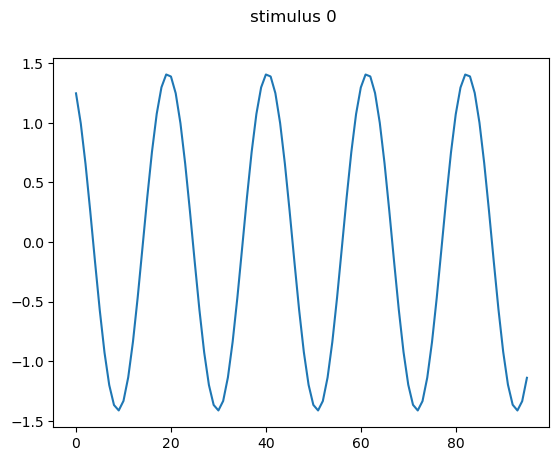

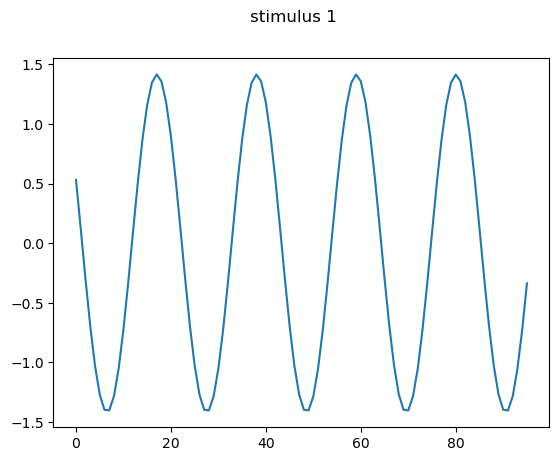

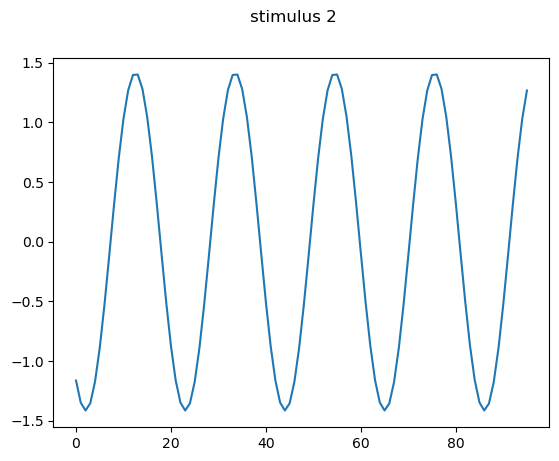

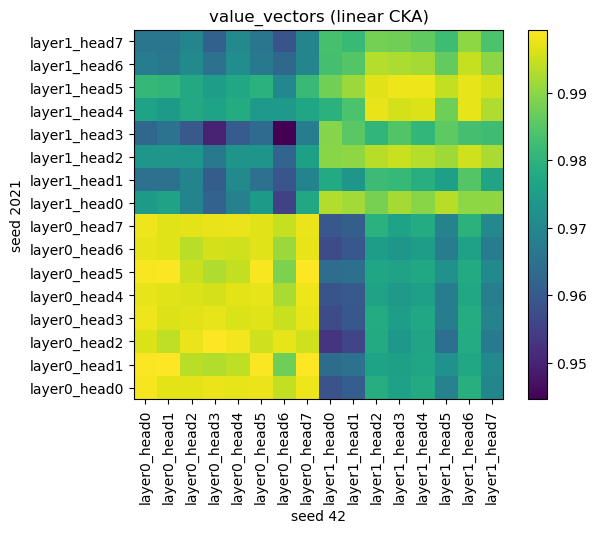

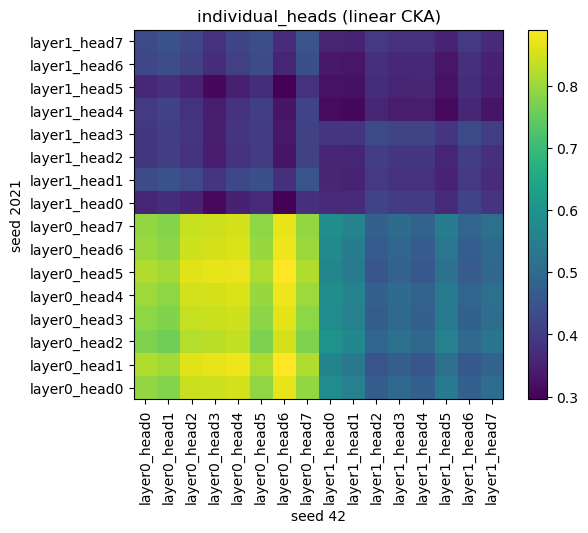

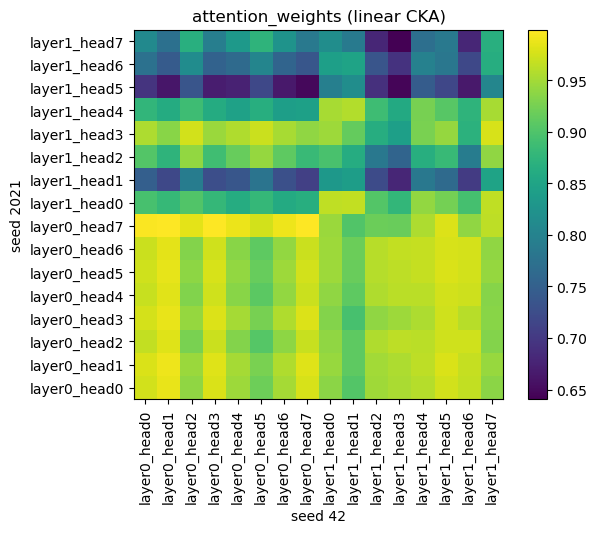

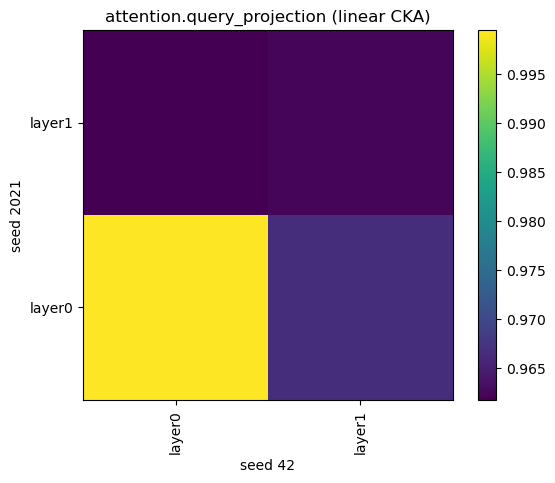

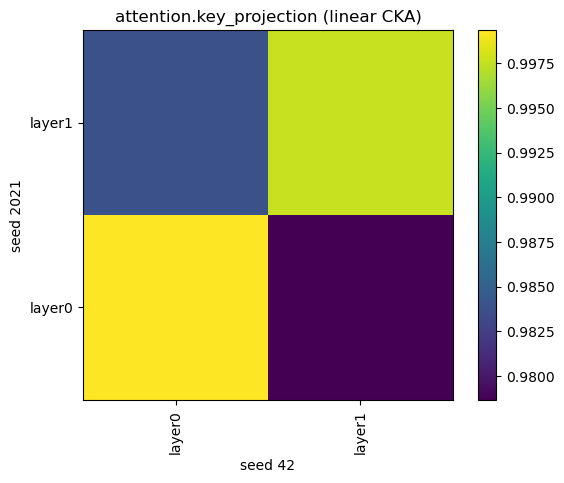

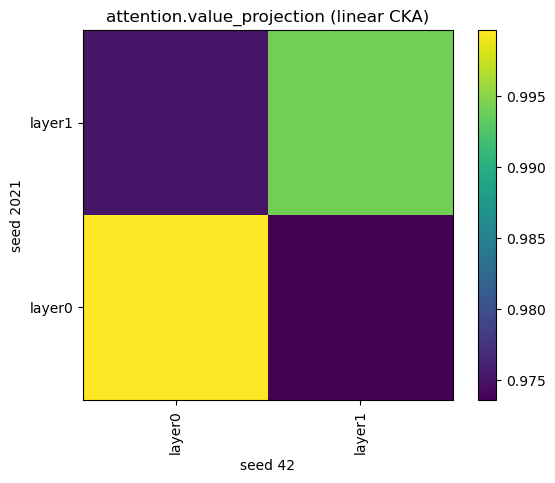

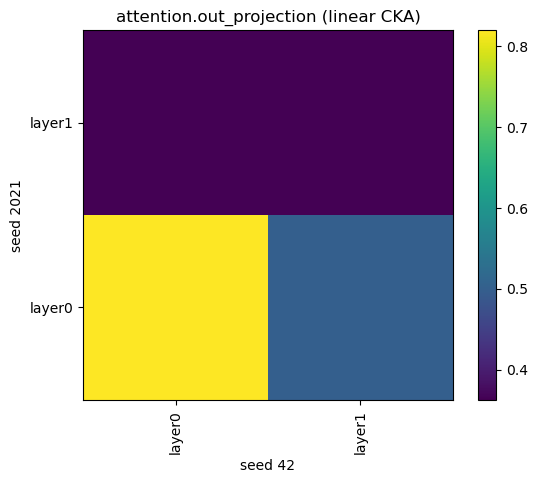

In [2]:
autoformer_7_seed2021 = data_utils.obtain_autoformer(pred_len=96, dataset="sinus7")
autoformer_7_seed42 = data_utils.obtain_autoformer(pred_len=96, dataset="seed42_sinus7")

data_loader_7 = data_utils.obtain_data_loader(pred_len=96, dataset="sinus7")

CKA.CKA_main(
    autoformer_7_seed2021,
    autoformer_7_seed42,
    data_loader_7,
    nameA="seed 2021",
    nameB="seed 42",
    CKA_type="linear",
    num_stimuli=3,
    save_fig=False,
    name_fig="3 stimuli",
)

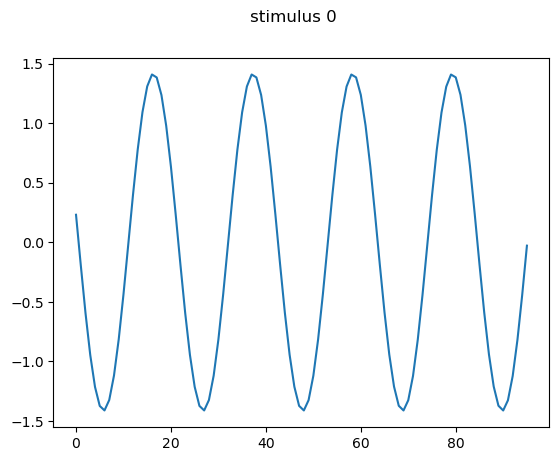

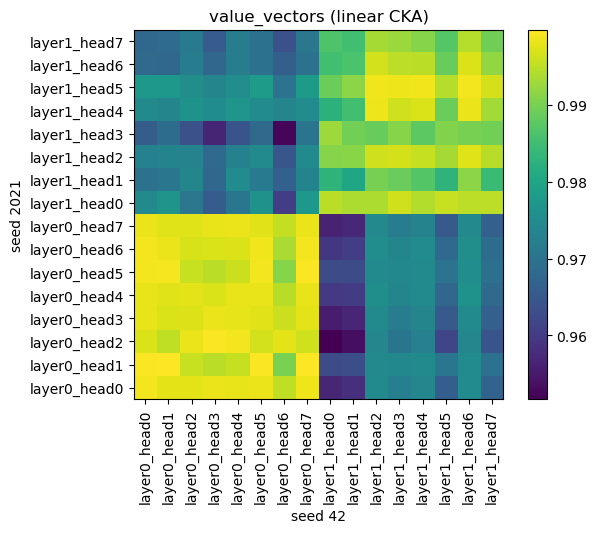

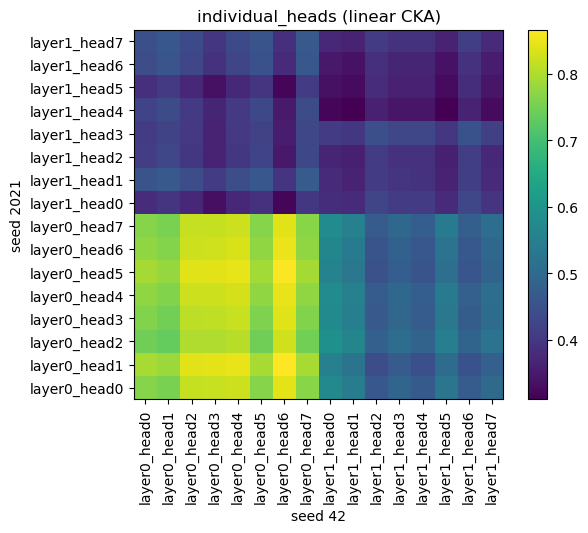

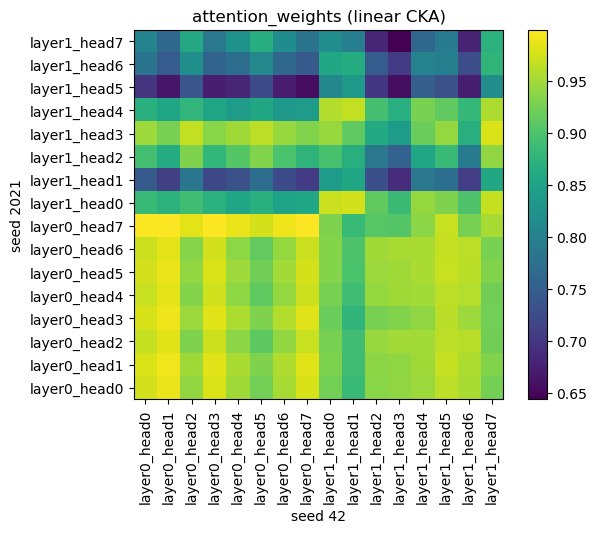

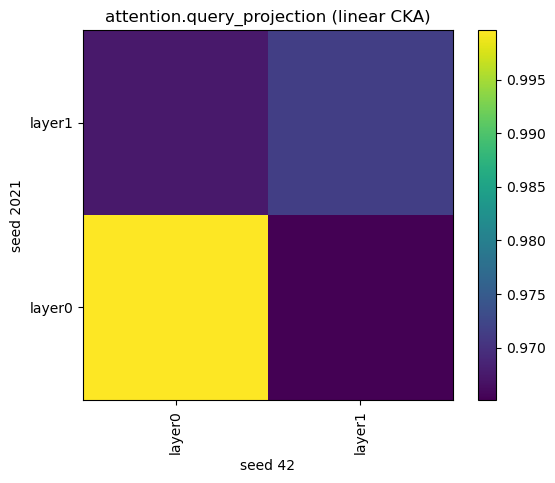

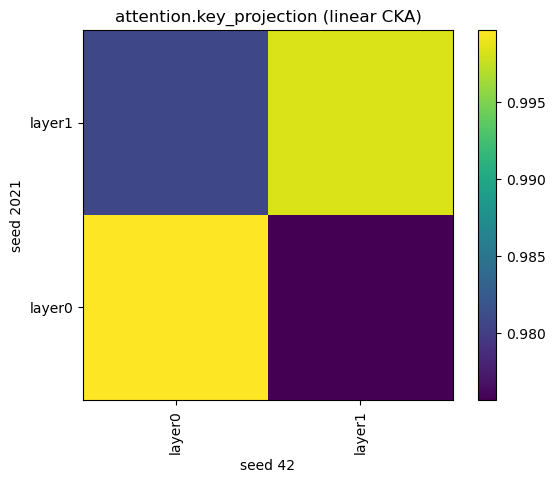

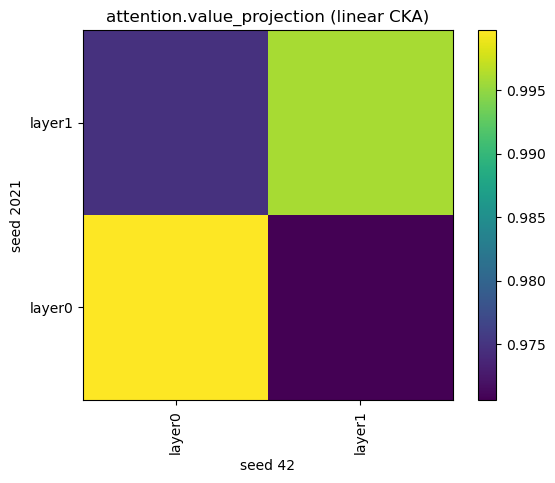

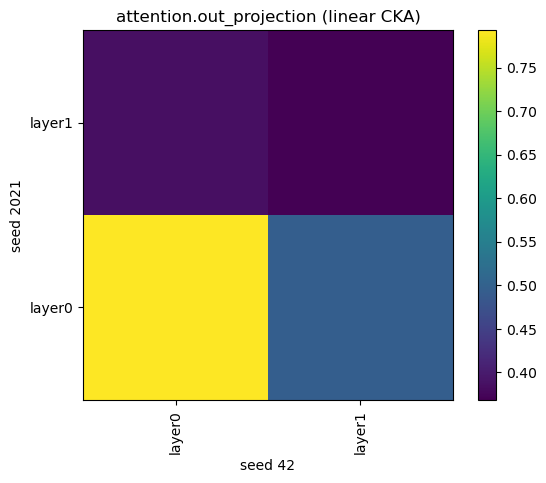

In [3]:
CKA.CKA_main(
    autoformer_7_seed2021,
    autoformer_7_seed42,
    data_loader_7,
    nameA="seed 2021",
    nameB="seed 42",
    CKA_type="linear",
    num_stimuli=1,
    save_fig=False,
)

## 1. Regular Autoformers for sine data

We have previously made the "sinus7" and "sinus7+sinus30" datasets and trained multiple Autoformers on these.

torch.Size([1, 96, 1])


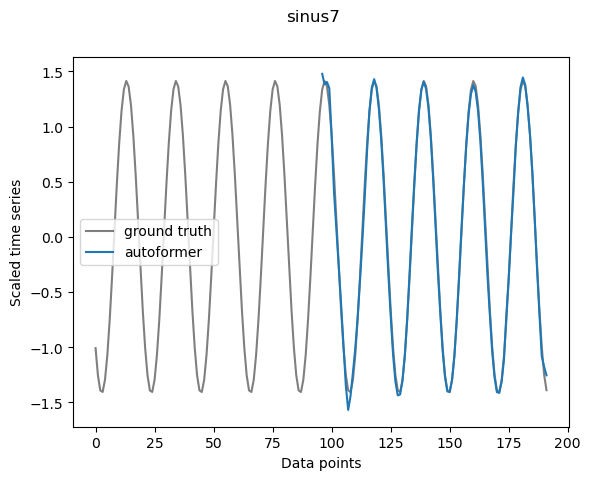

In [2]:
data_loader_7 = data_utils.obtain_data_loader(pred_len=96, dataset="sinus7")
autoformer_7 = data_utils.obtain_autoformer(pred_len=96, dataset="sinus7")

data_utils.obtain_plot_predictions(
    96,
    "sinus7",
    data_loader_7,
    autoformer_7,
    item=0,
    alpha_gt=0.5,
    alpha_pred=1,
    to_save=False,
)

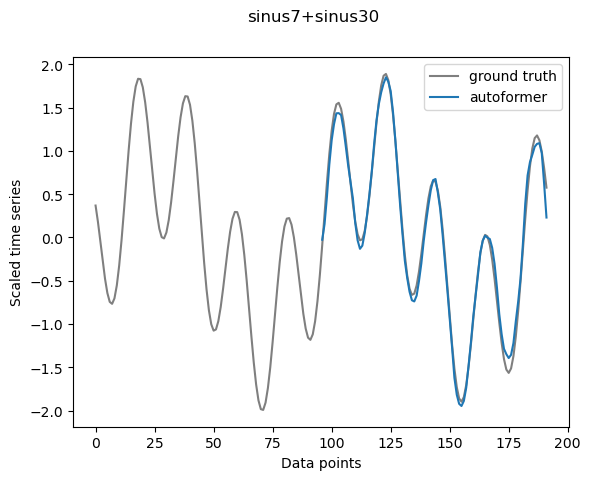

In [5]:
data_loader_7_30 = data_utils.obtain_data_loader(pred_len=96, dataset="sinus7+sinus30")
autoformer_7_30 = data_utils.obtain_autoformer(pred_len=96, dataset="sinus7+sinus30")

data_utils.obtain_plot_predictions(
    96,
    "sinus7+sinus30",
    data_loader_7_30,
    autoformer_7_30,
    item=0,
    alpha_gt=0.5,
    alpha_pred=1,
)

### 1.1 Same data, different seed

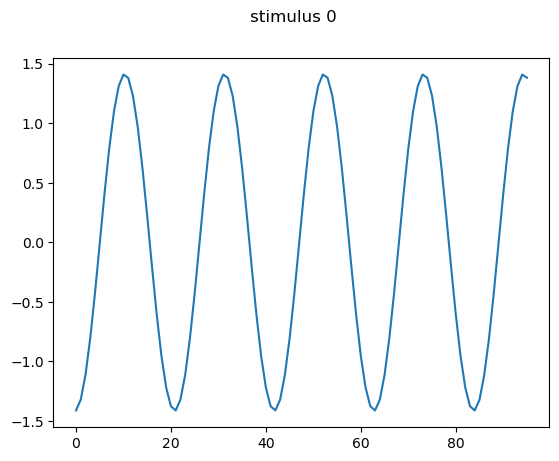

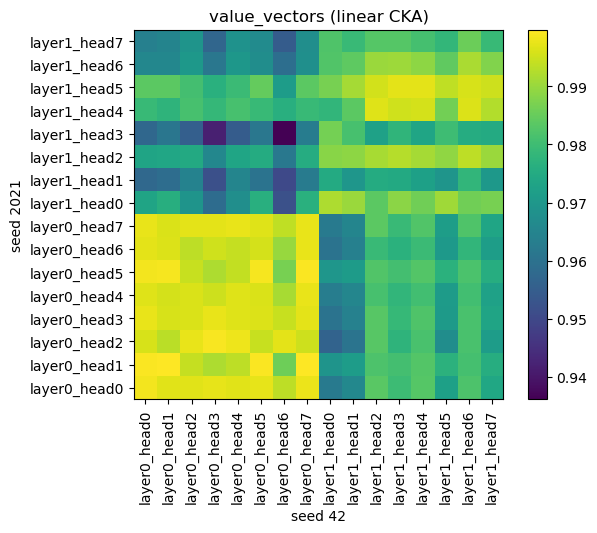

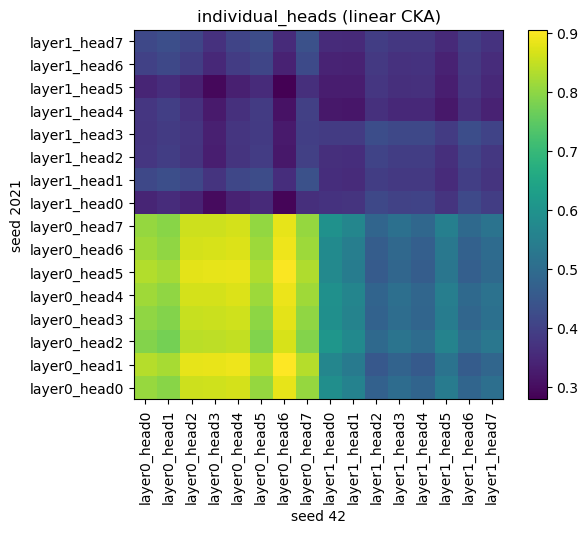

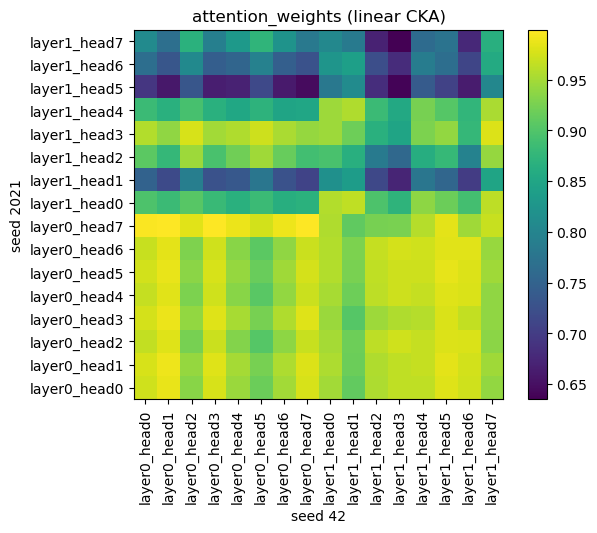

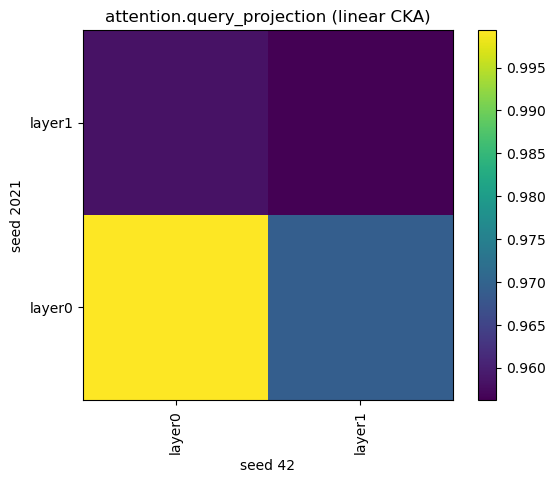

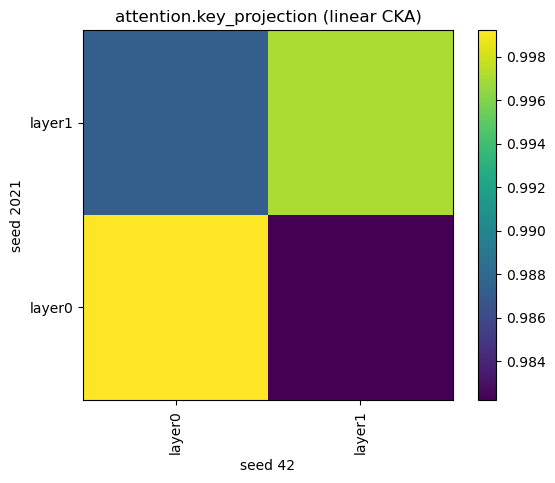

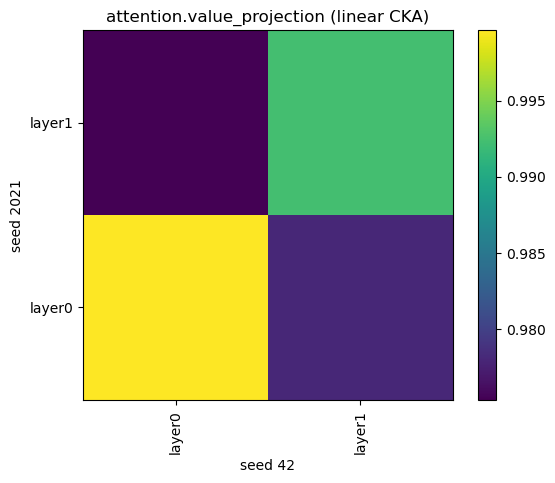

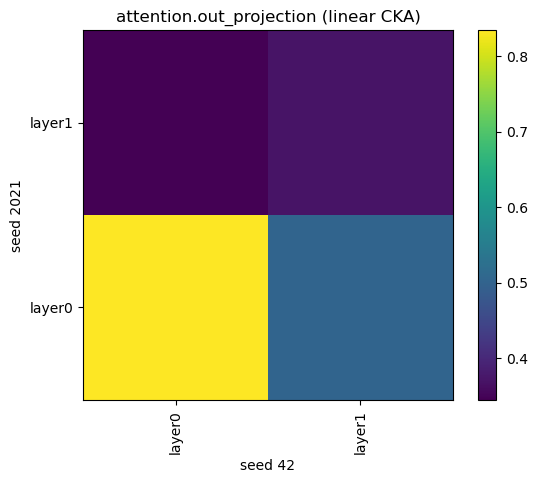

In [6]:
autoformer_7_seed2021 = data_utils.obtain_autoformer(pred_len=96, dataset="sinus7")
autoformer_7_seed42 = data_utils.obtain_autoformer(pred_len=96, dataset="seed42_sinus7")

data_loader_7 = data_utils.obtain_data_loader(pred_len=96, dataset="sinus7")

CKA.CKA_main(
    autoformer_7_seed2021,
    autoformer_7_seed42,
    data_loader_7,
    nameA="seed 2021",
    nameB="seed 42",
    CKA_type="linear",
    save_fig=False,
)

### 1.2 Same data, same seed, same model instance

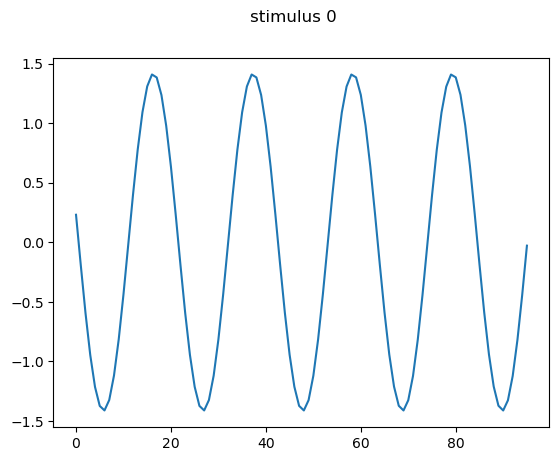

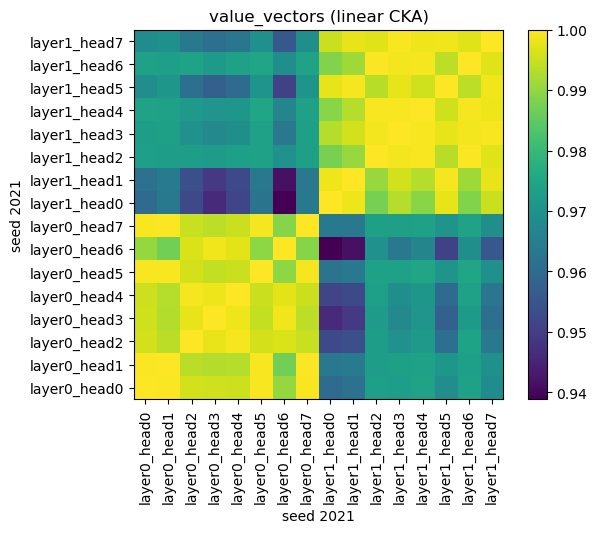

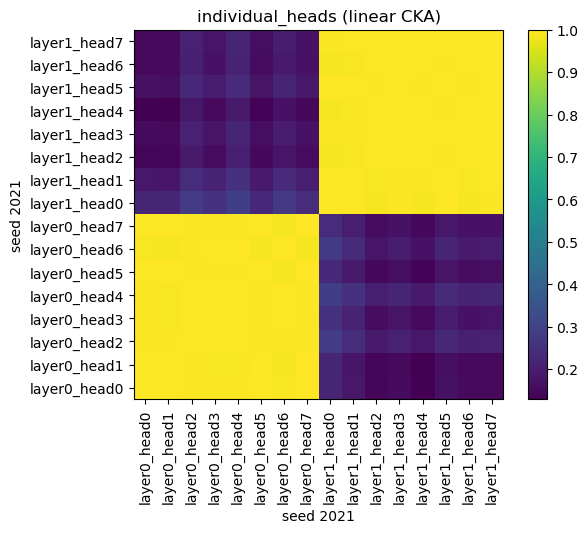

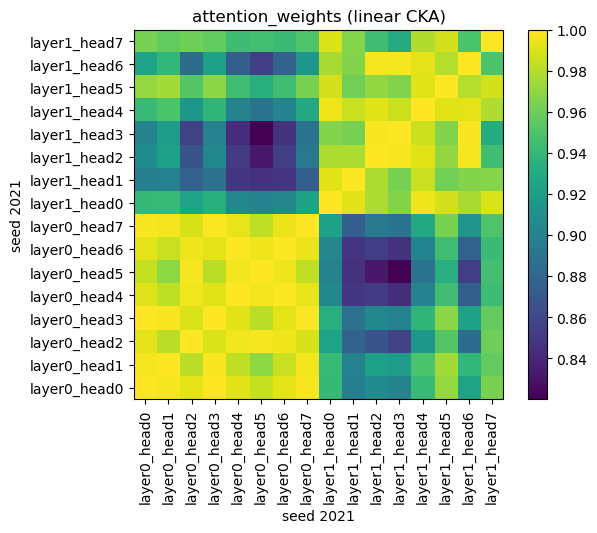

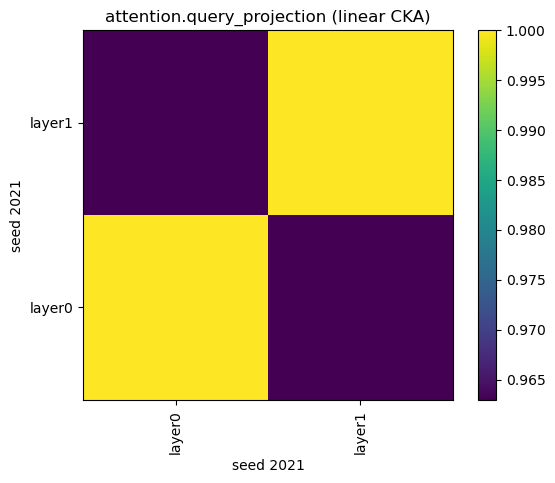

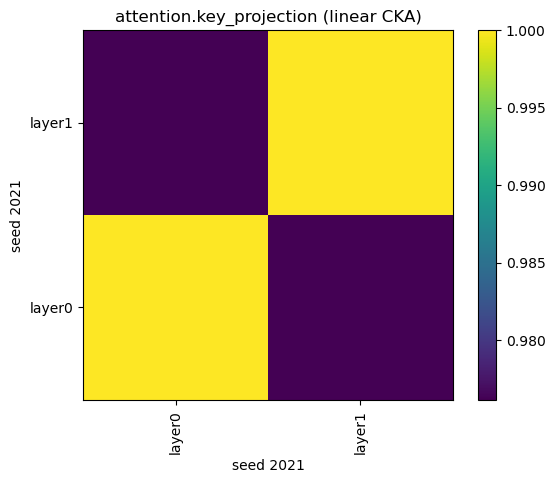

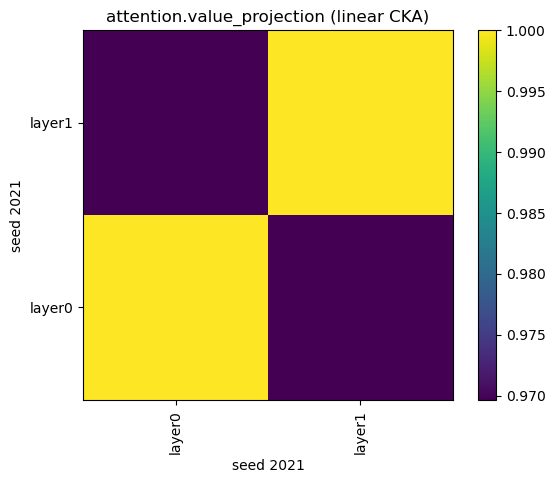

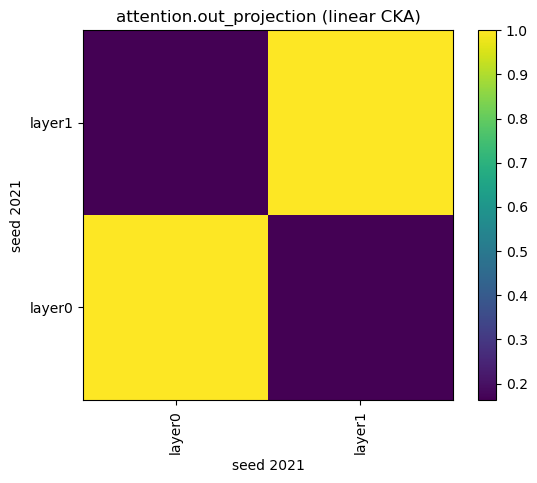

In [7]:
CKA.CKA_main(
    autoformer_7_seed42,
    autoformer_7_seed42,
    data_loader_7,
    nameA="seed 2021",
    nameB="seed 2021",
    CKA_type="linear",
    save_fig=False,
)

### 1.3 Same data, same seed, different model instance

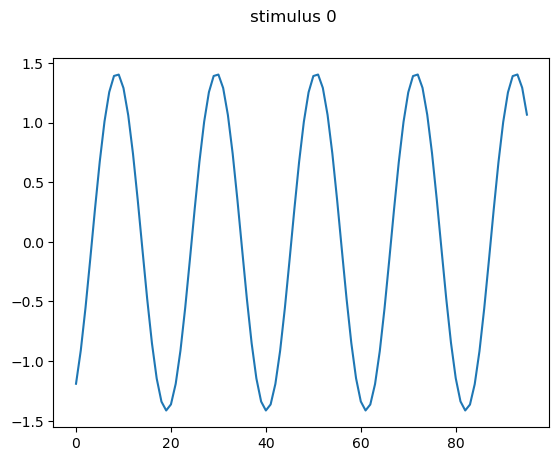

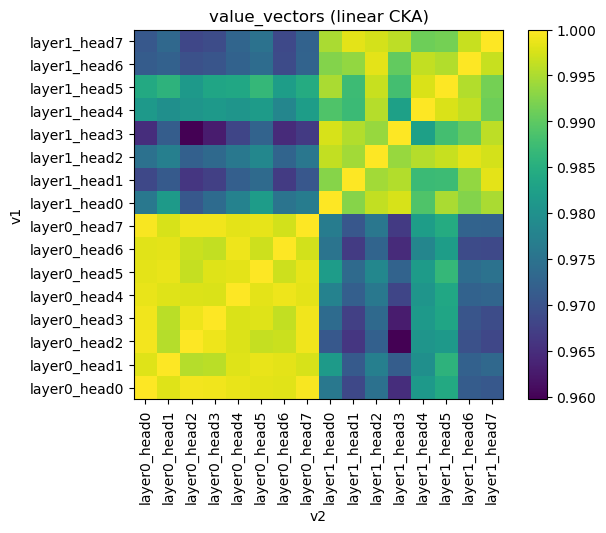

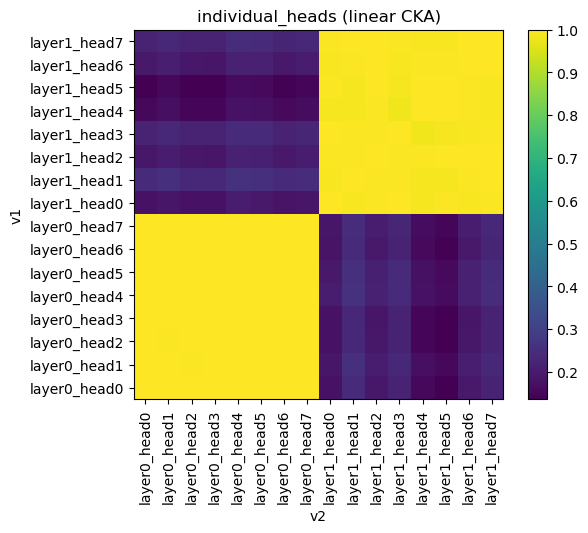

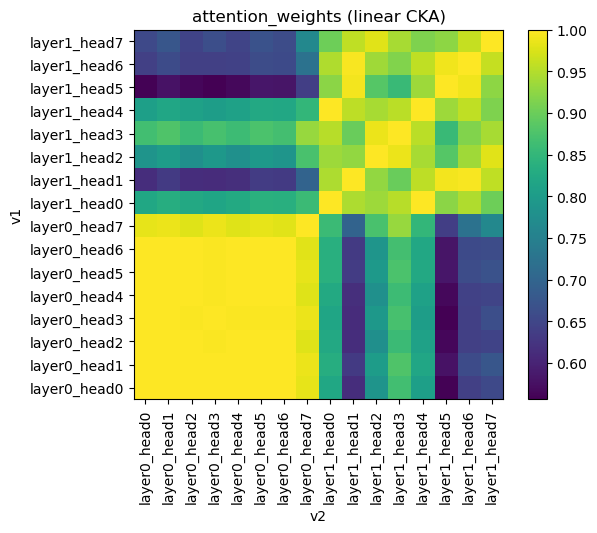

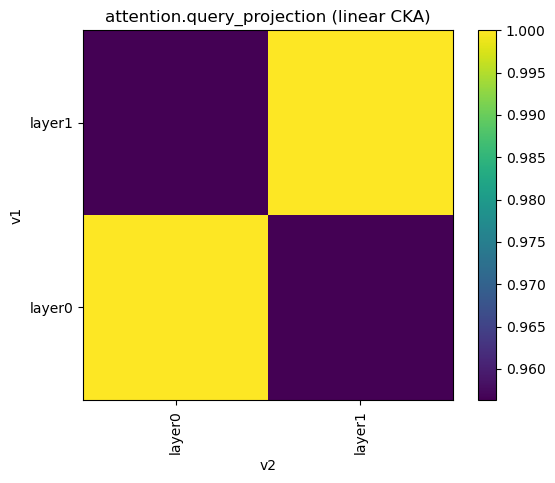

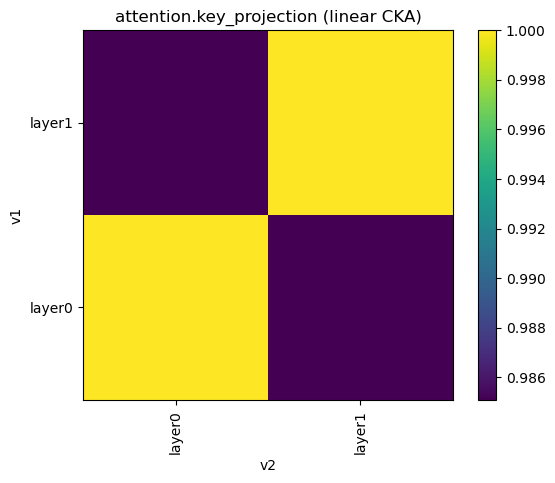

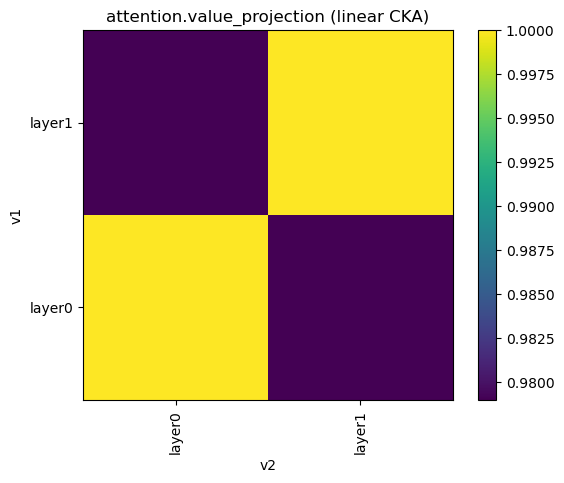

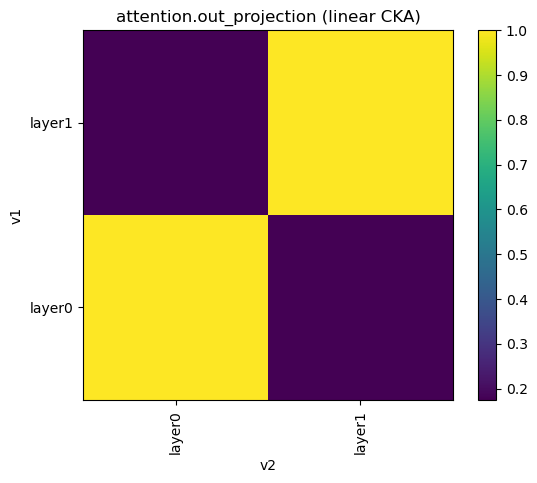

In [8]:
autoformer_7_v1 = data_utils.obtain_autoformer(pred_len=96, dataset="sinus7")
autoformer_7_v2 = data_utils.obtain_autoformer(pred_len=96, dataset="seed2021_sinus7")

CKA.CKA_main(
    autoformer_7_v1,
    autoformer_7_v2,
    data_loader_7,
    nameA="v1",
    nameB="v2",
    CKA_type="linear",
    save_fig=False,
)

### 1.4 Autoformer vs autoformer finetuned on complex data

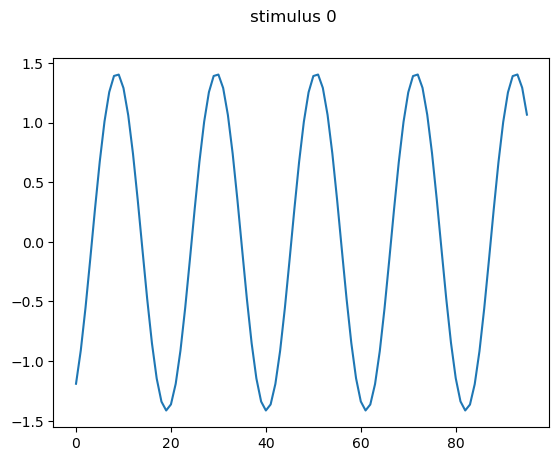

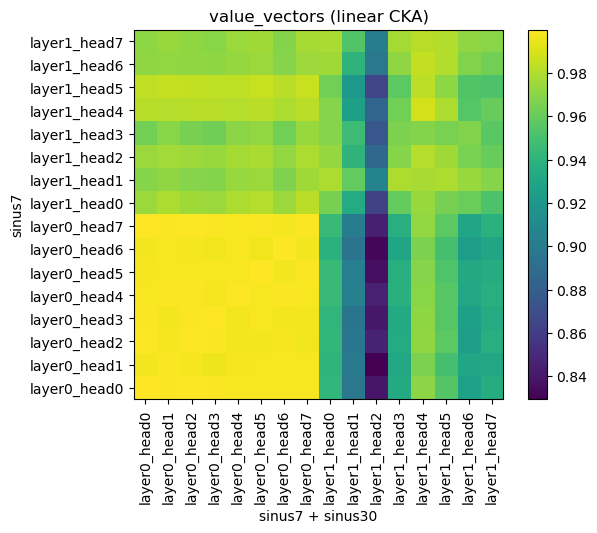

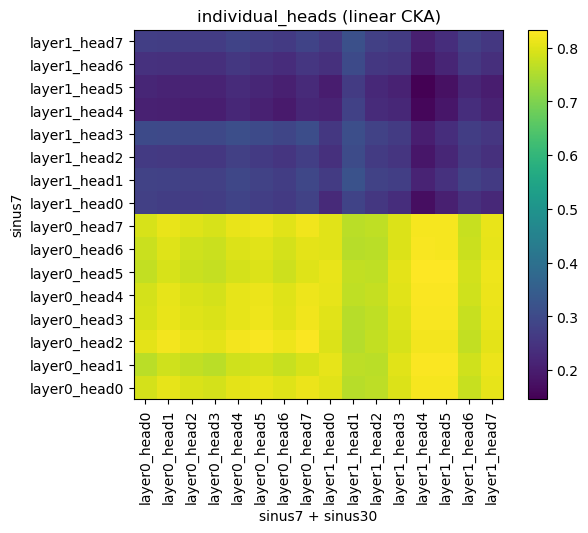

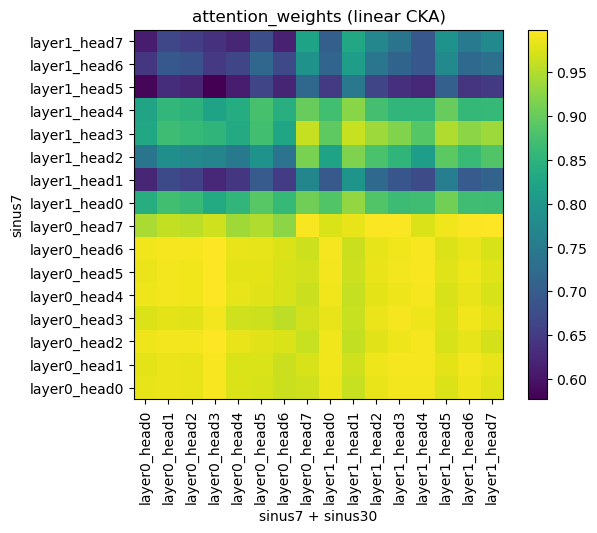

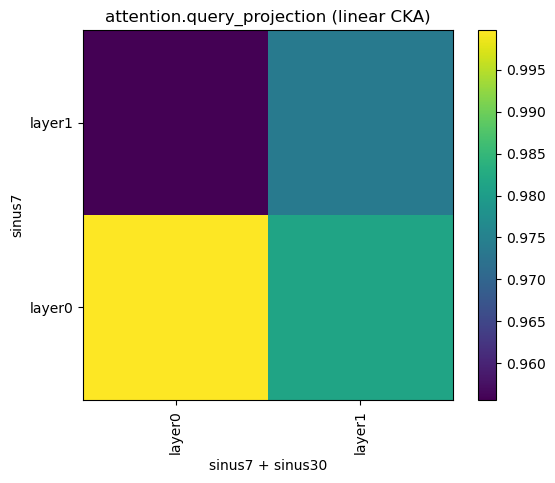

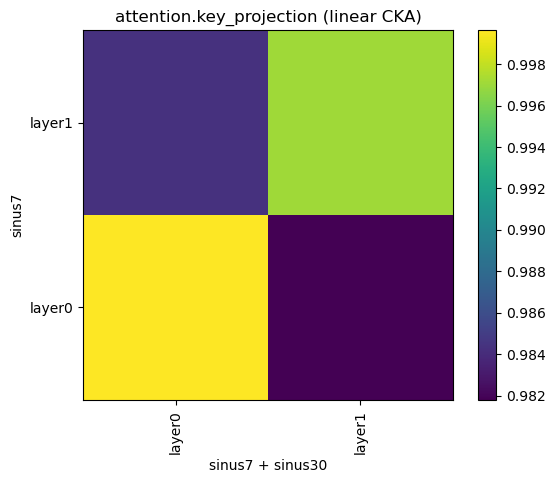

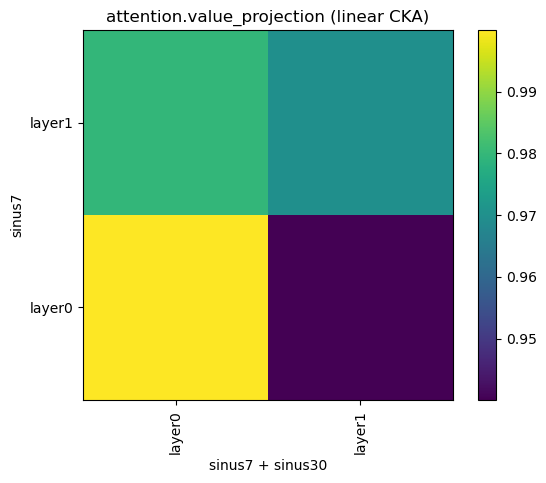

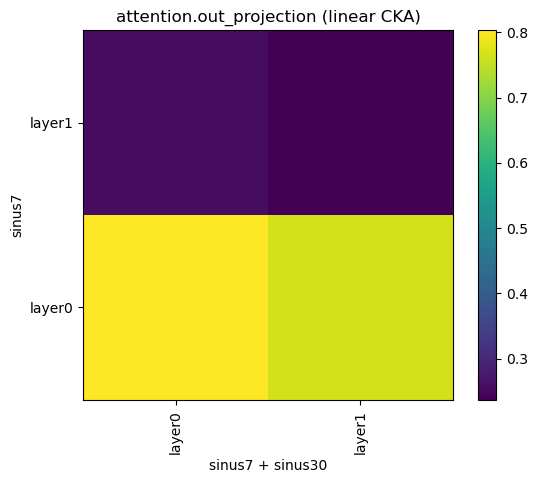

In [9]:
autoformer_7_v1 = data_utils.obtain_autoformer(pred_len=96, dataset="sinus7")
autoformer_7_v2 = data_utils.obtain_autoformer(pred_len=96, dataset="sinus7+sinus30")

data_loader_7 = data_utils.obtain_data_loader(pred_len=96, dataset="sinus7")

CKA.CKA_main(
    autoformer_7_v1,
    autoformer_7_v2,
    data_loader_7,
    nameA="sinus7",
    nameB="sinus7 + sinus30",
    CKA_type="linear",
    save_fig=False,
)

## 2. Regular Autoformers on electricity data

The previous experiments only consider sine data, which is rather simple. Perhaps the data is so simple that all attention heads learn the same. Therefore, it is interesting to look at transformers with more complex, natural data.

### 2.1 Different seeds, 1 stimuli

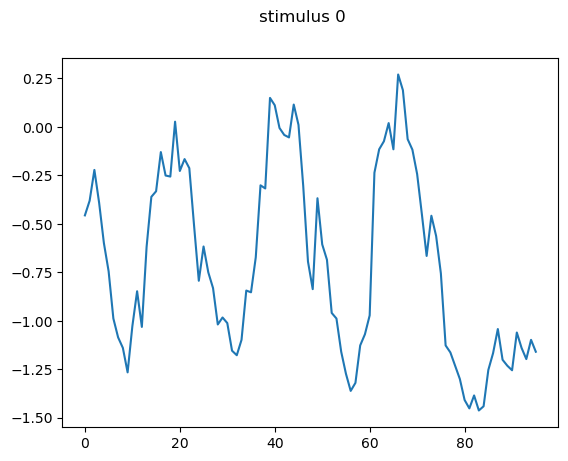

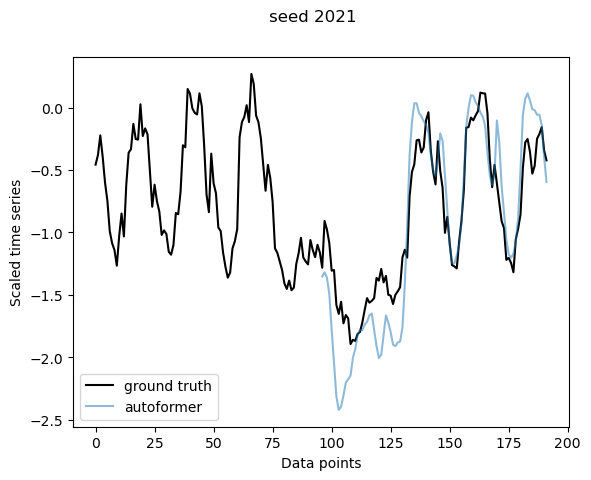

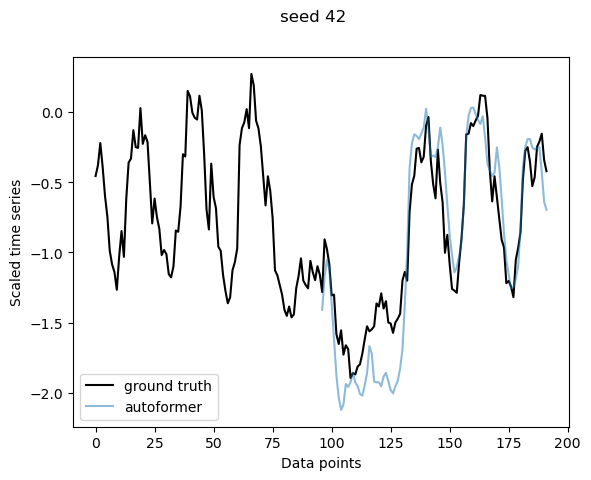

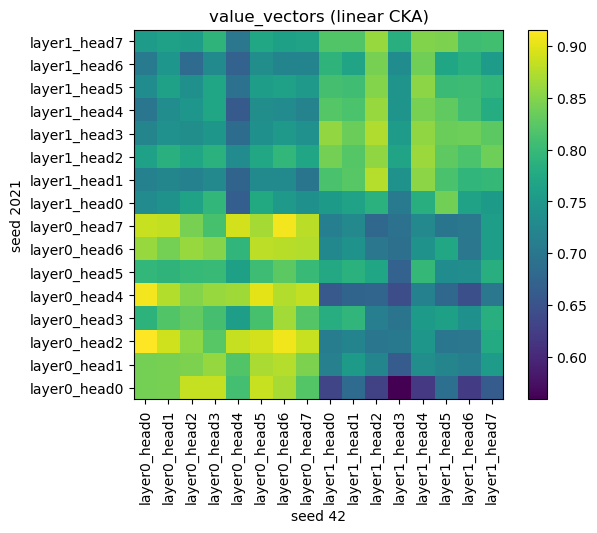

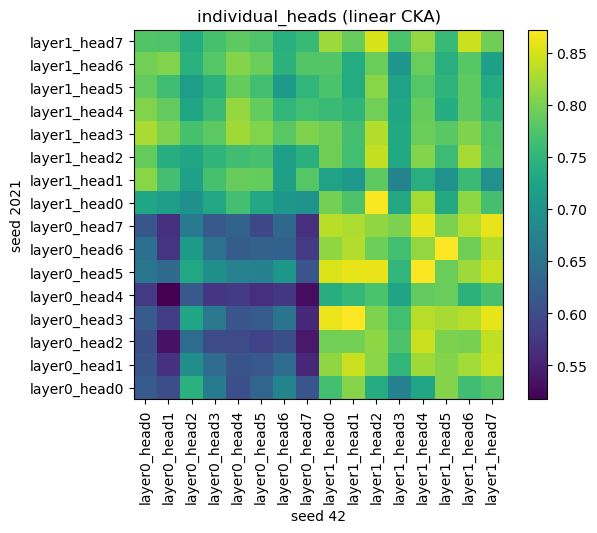

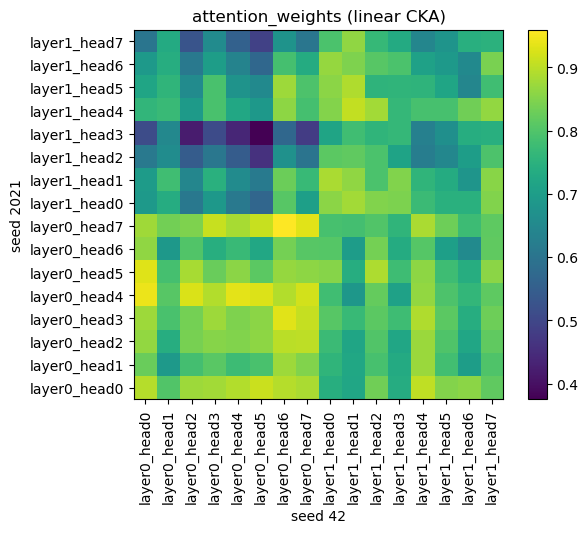

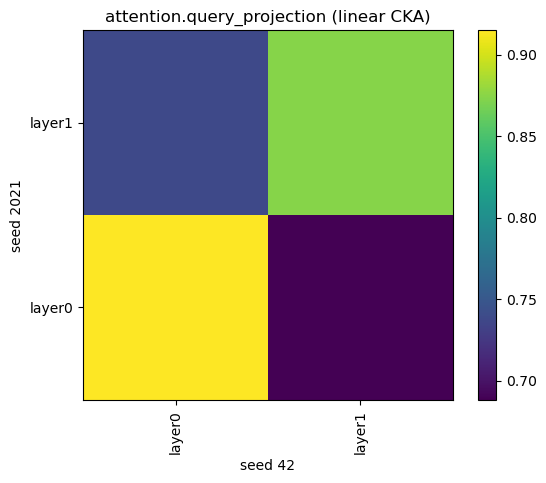

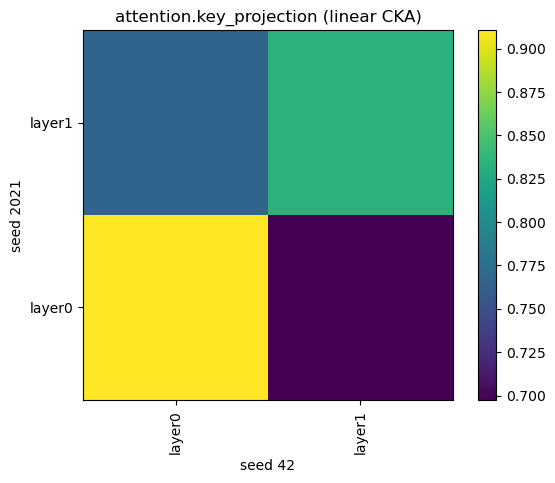

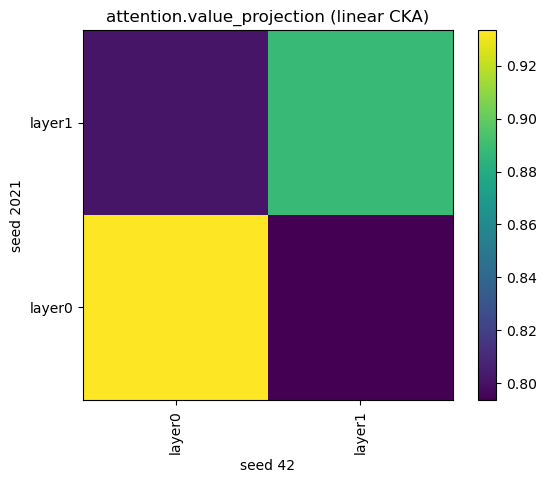

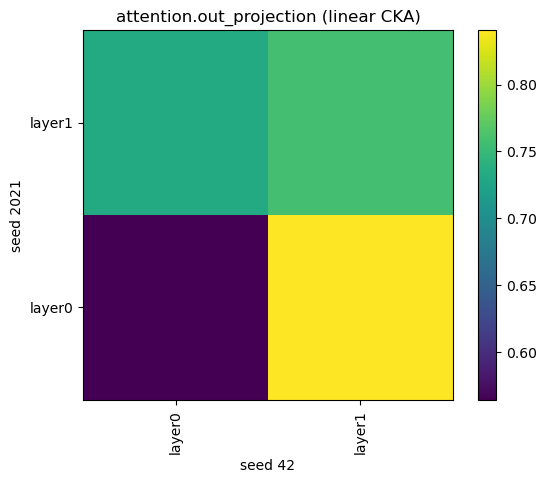

In [2]:
autoformer_v1 = data_utils.obtain_autoformer(pred_len=96, dataset="ECL")  # seed 2021
autoformer_v2 = data_utils.obtain_autoformer(pred_len=96, dataset="seed42_ECL")

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_main(
    autoformer_v1,
    autoformer_v2,
    data_loader,
    nameA="seed 2021",
    nameB="seed 42",
    CKA_type="linear",
    save_fig=False,  # initially True
    num_stimuli=1,
)

### 2.2 Different seeds, 10 stimuli

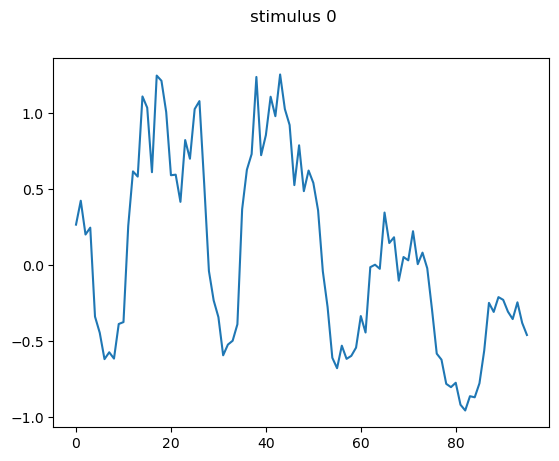

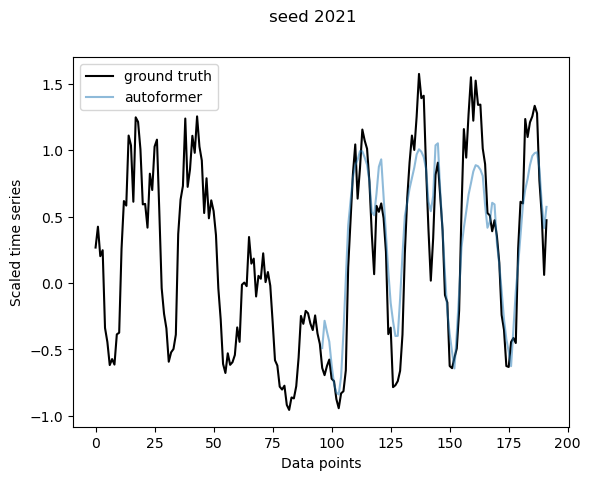

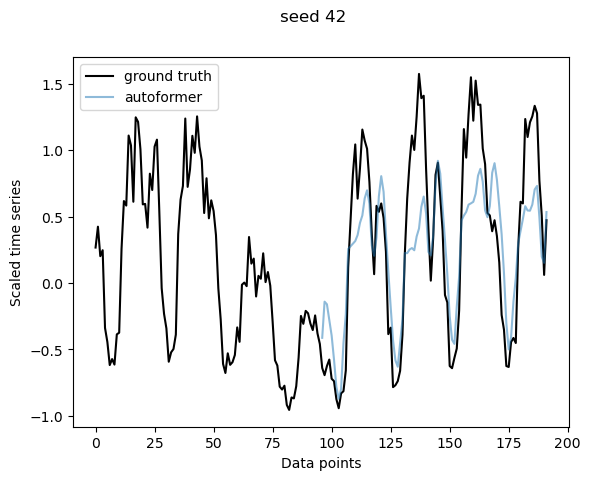

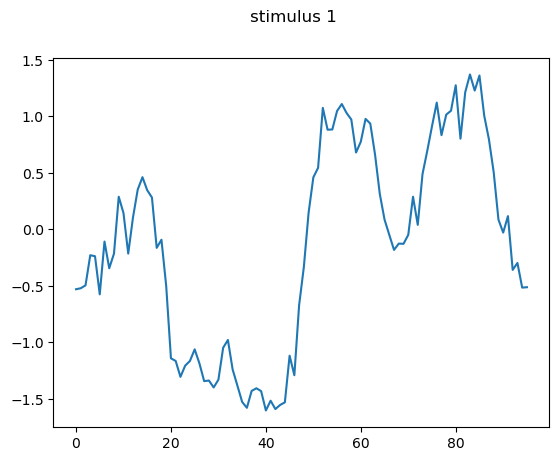

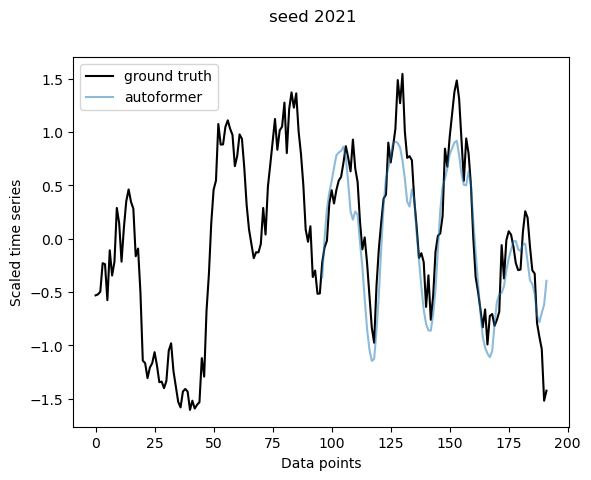

...

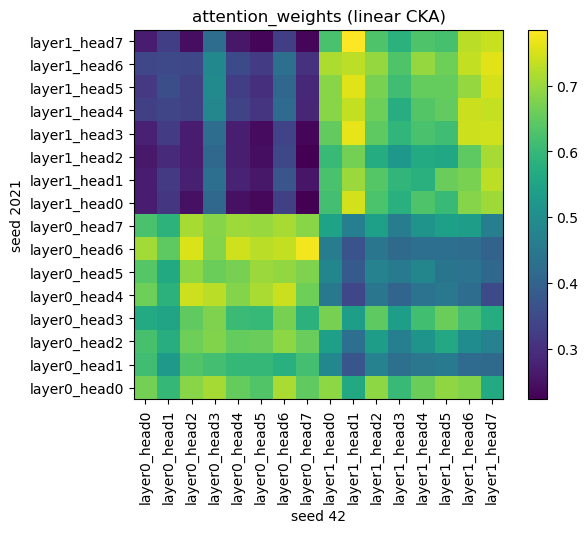

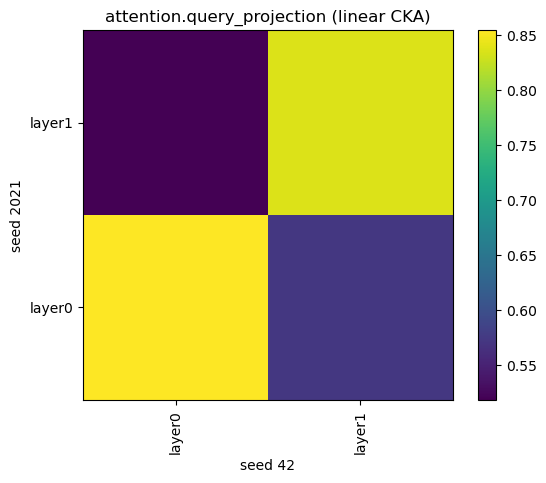

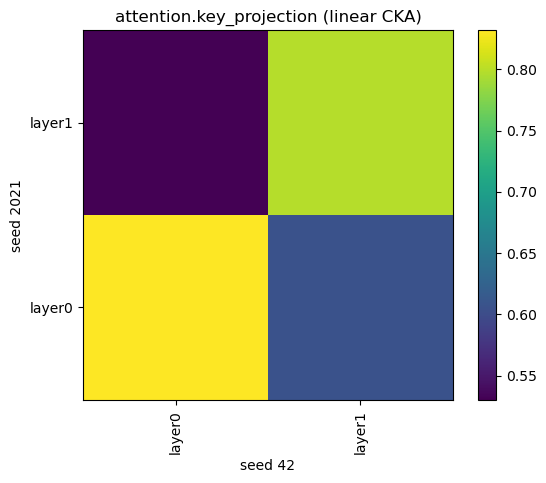

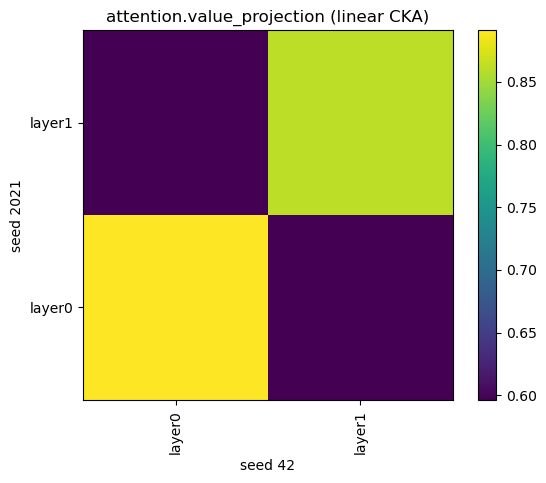

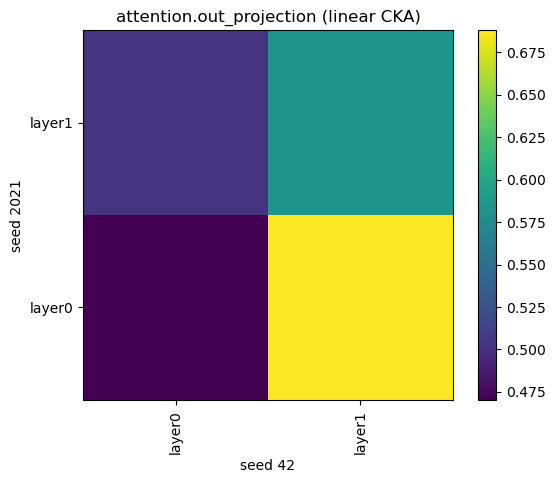

In [2]:
autoformer_v1 = data_utils.obtain_autoformer(pred_len=96, dataset="ECL")  # seed 2021
autoformer_v2 = data_utils.obtain_autoformer(pred_len=96, dataset="seed42_ECL")

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_main(
    autoformer_v1,
    autoformer_v2,
    data_loader,
    nameA="seed 2021",
    nameB="seed 42",
    CKA_type="linear",
    save_fig=True,
    num_stimuli=10,
)

### 2.3 Different seeds, 15 stimuli

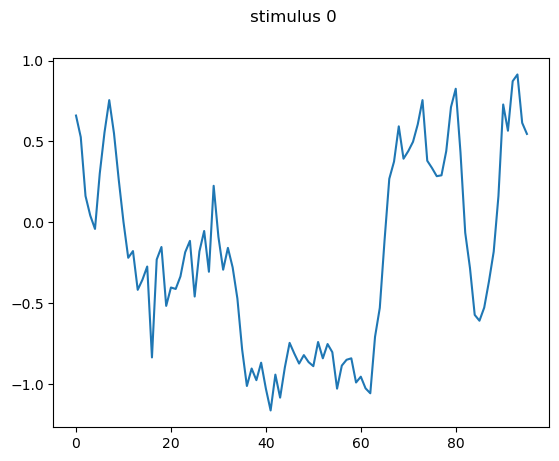

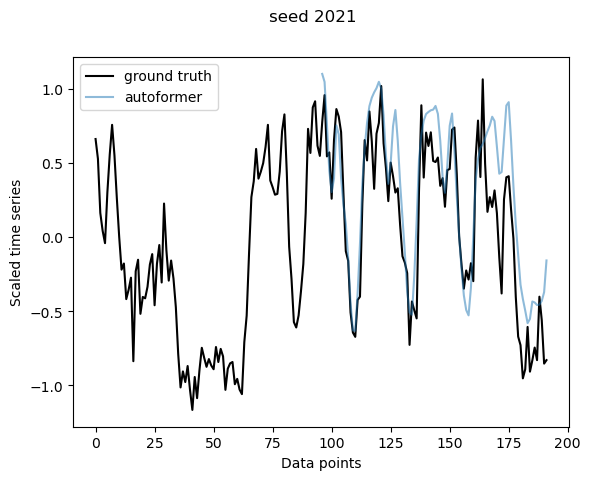

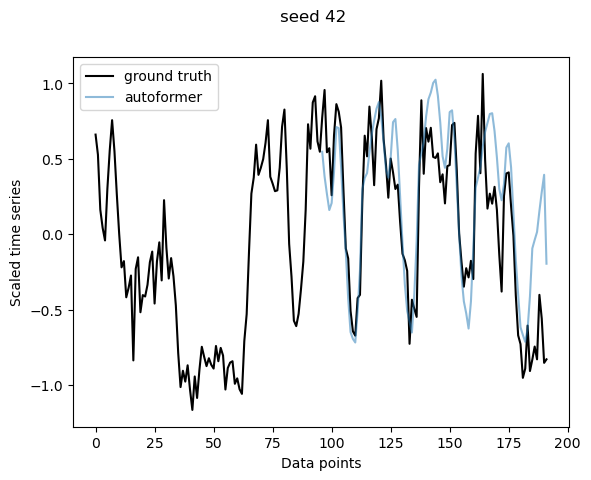

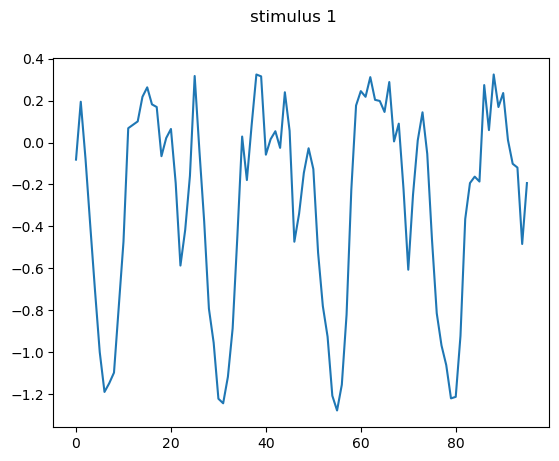

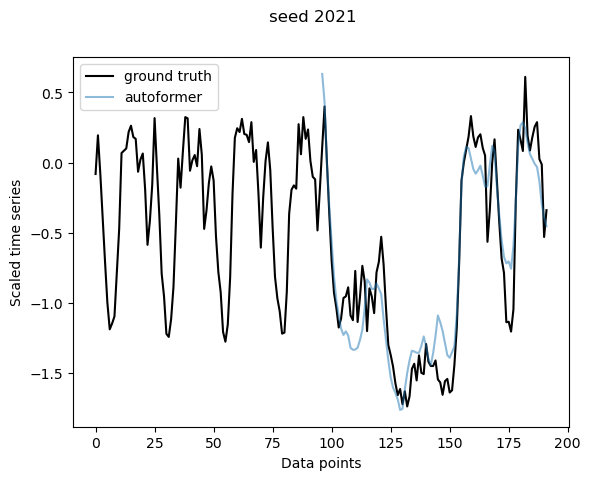

...

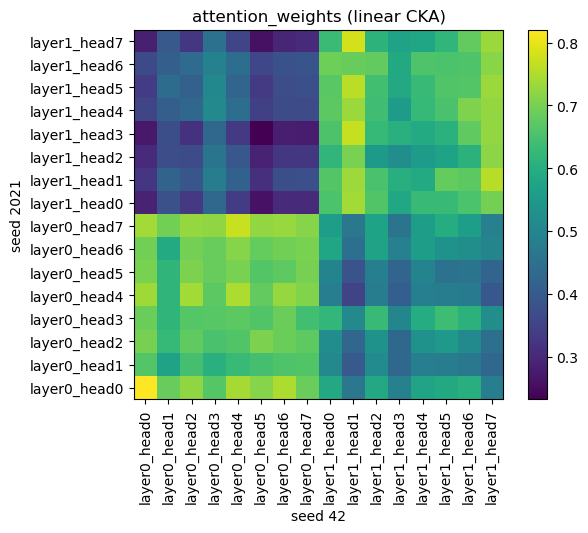

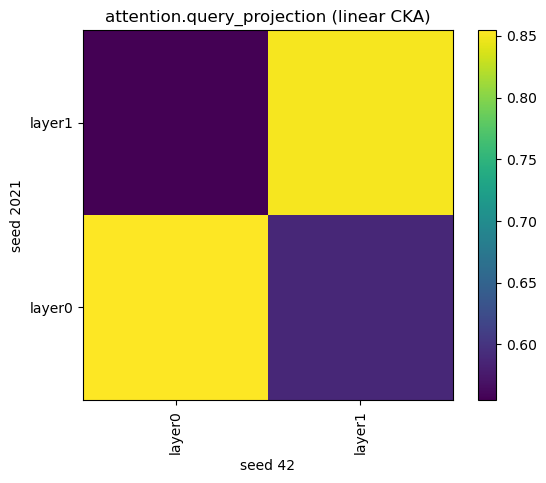

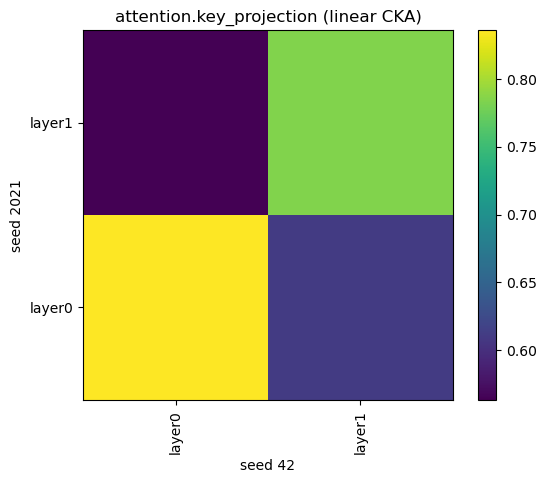

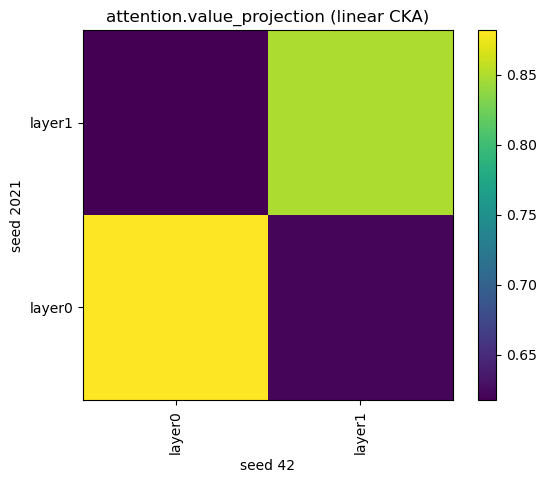

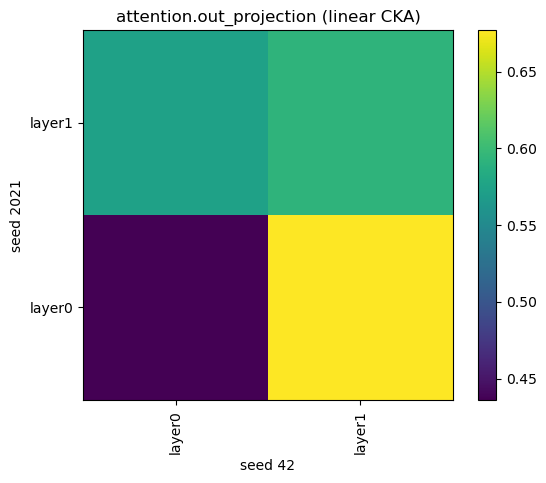

In [3]:
autoformer_v1 = data_utils.obtain_autoformer(pred_len=96, dataset="ECL")  # seed 2021
autoformer_v2 = data_utils.obtain_autoformer(pred_len=96, dataset="seed42_ECL")

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_main(
    autoformer_v1,
    autoformer_v2,
    data_loader,
    nameA="seed 2021",
    nameB="seed 42",
    CKA_type="linear",
    save_fig=True,
    num_stimuli=15,
)

### 2.4 Different seeds, 20 stimuli
TODO: yet to run, will probably take long (> 45 min)

In [ ]:
autoformer_v1 = data_utils.obtain_autoformer(pred_len=96, dataset="ECL")  # seed 2021
autoformer_v2 = data_utils.obtain_autoformer(pred_len=96, dataset="seed42_ECL")

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_main(
    autoformer_v1,
    autoformer_v2,
    data_loader,
    nameA="seed 2021",
    nameB="seed 42",
    CKA_type="linear",
    save_fig=True,
    num_stimuli=20,
)

### 2.5 Sanity check; 10 stimuli same models

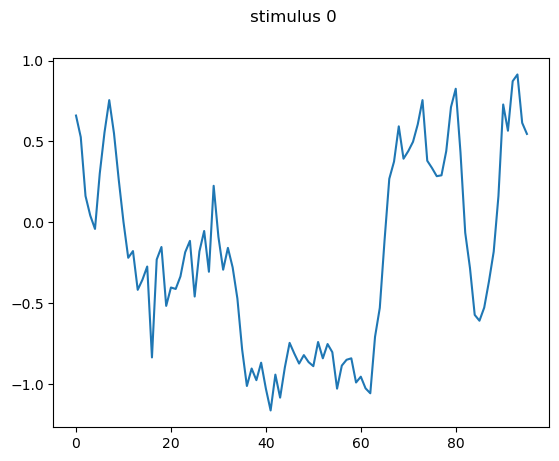

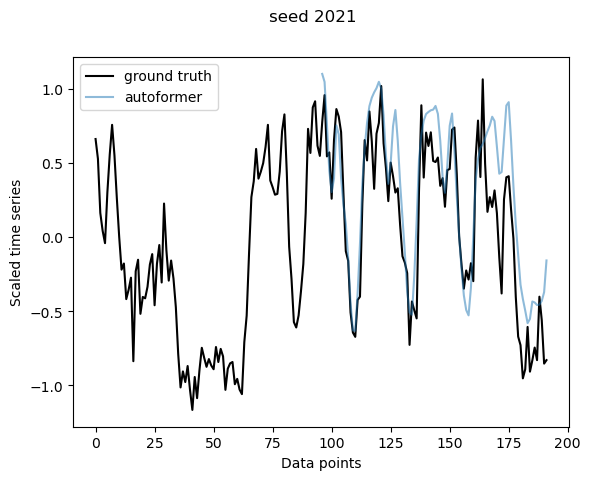

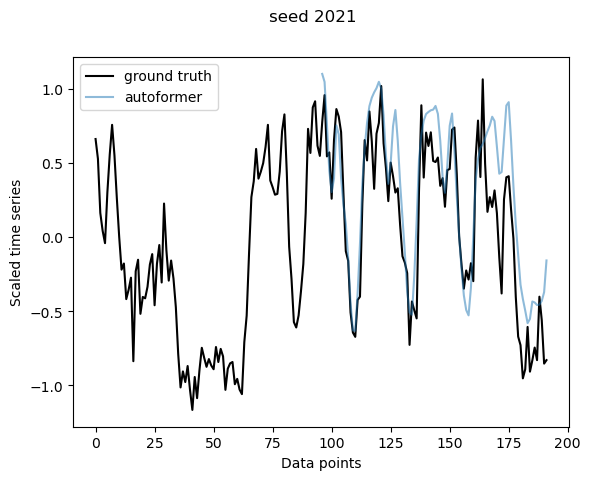

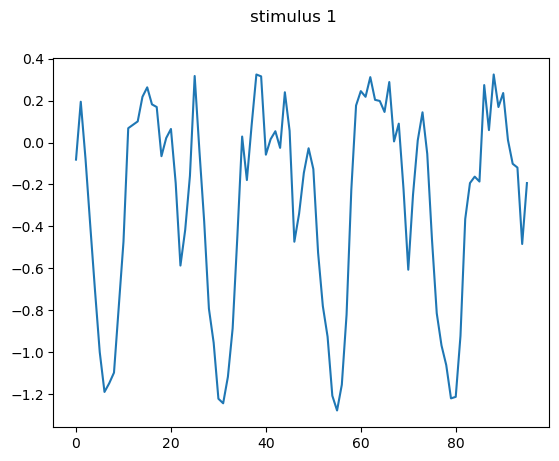

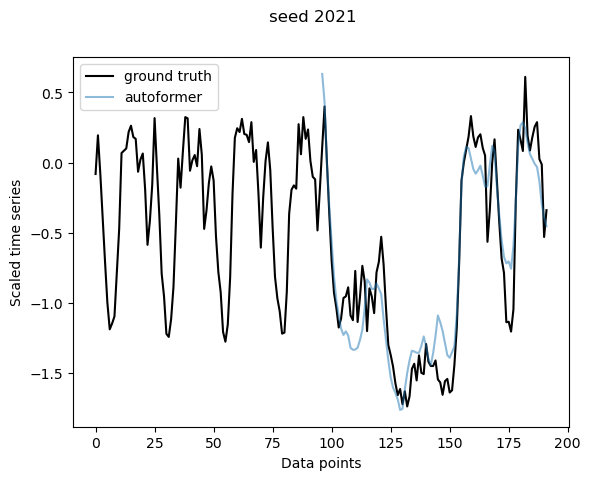

...

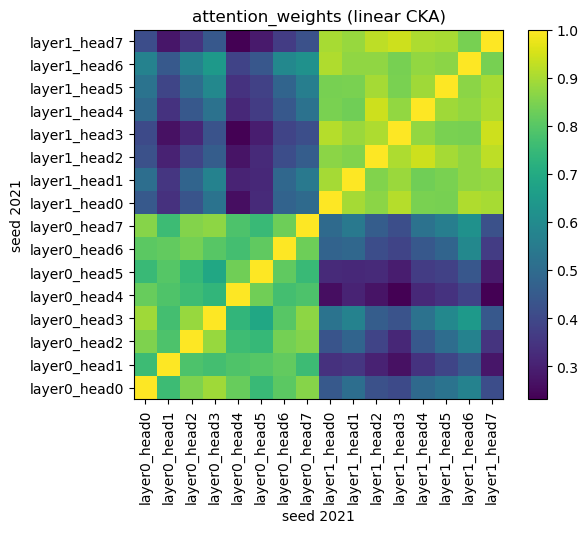

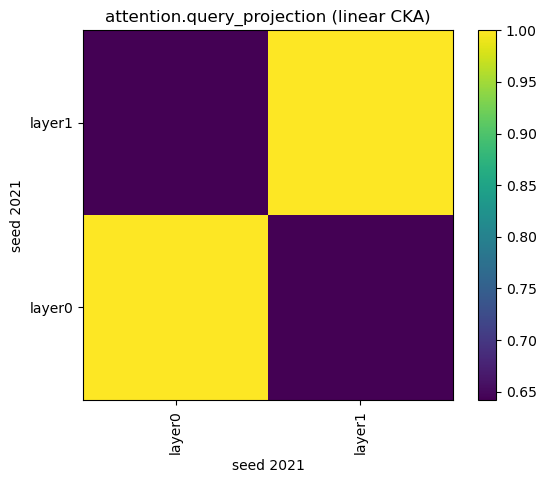

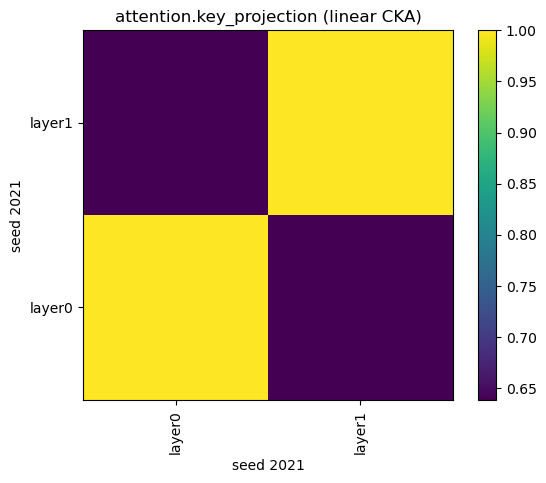

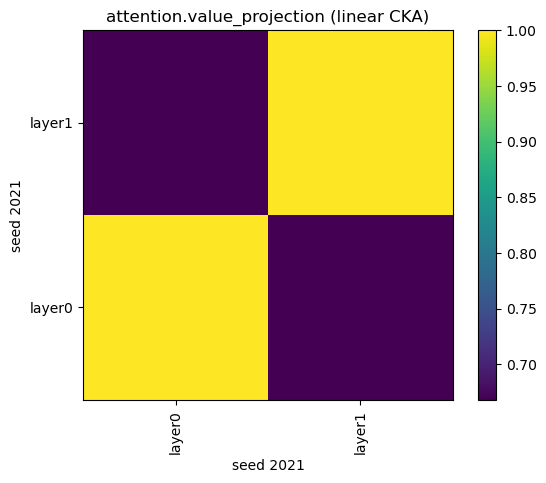

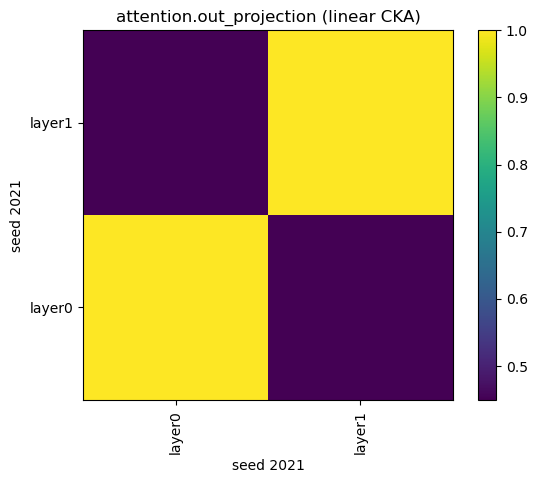

In [4]:
autoformer_v1 = data_utils.obtain_autoformer(pred_len=96, dataset="ECL")  # seed 2021
autoformer_v2 = data_utils.obtain_autoformer(pred_len=96, dataset="seed42_ECL")

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_main(
    autoformer_v1,
    autoformer_v1,
    data_loader,
    nameA="seed 2021",
    nameB="seed 2021",
    CKA_type="linear",
    save_fig=True,
    num_stimuli=10,
)

## 3. Deeper autoformers on electricity data

### 3.1 More encoder layers

These autoformers have 8 encoder layers instead of 2, and still just 1 decoder layer. Interesting to note is that they did need more epochs for training, they only used 5 (of which 3 were early stopping).

Test scores: \
2 encoder layers: mse: 0.209, mae: 0.323, mase: 1.199 (7 epochs) \
8 encoder layers: mse: 0.194, mae: 0.308, mase: 1.146 (5 epochs) (better!)


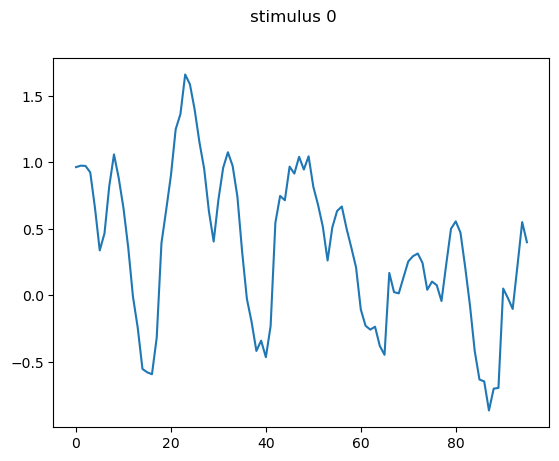

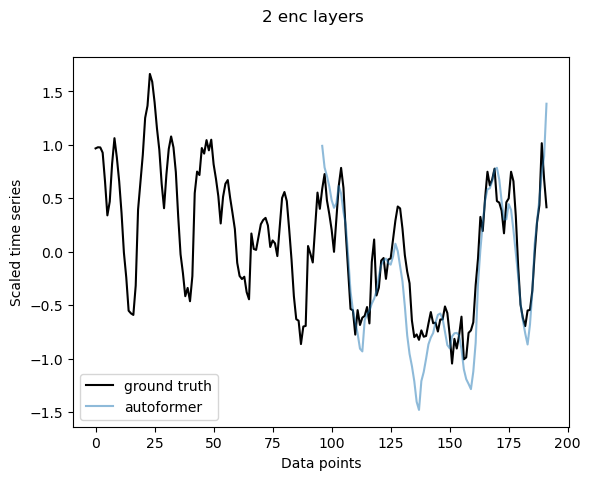

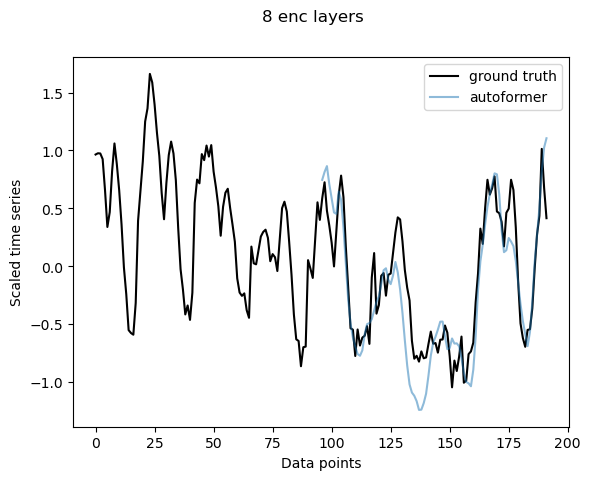

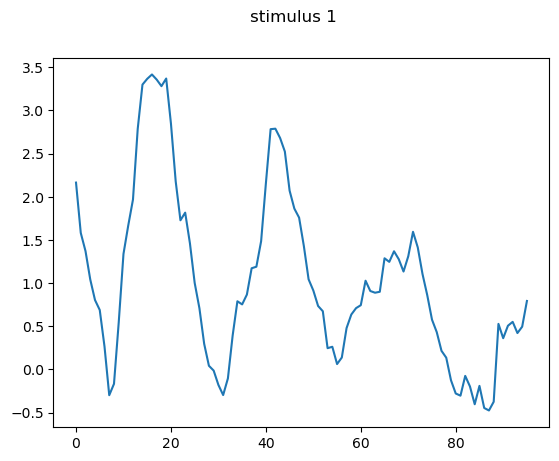

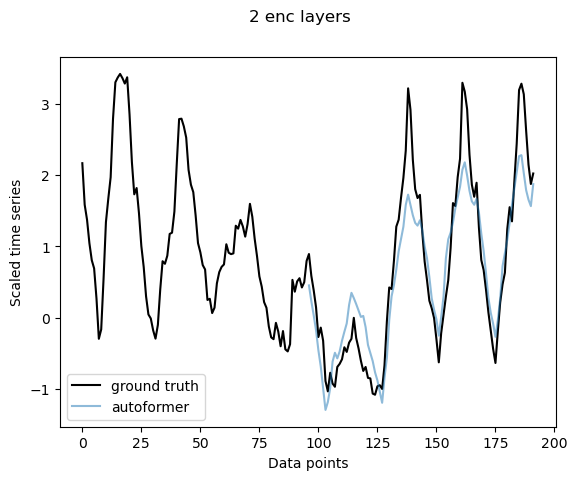

...

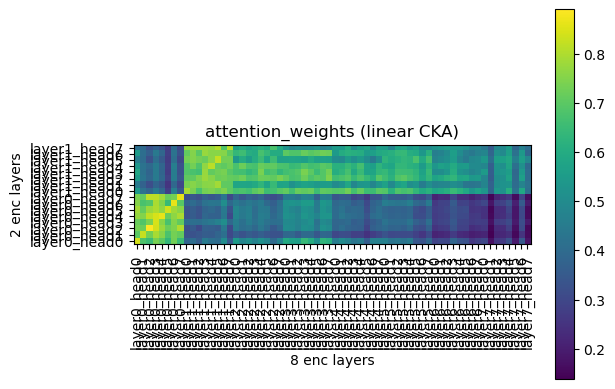

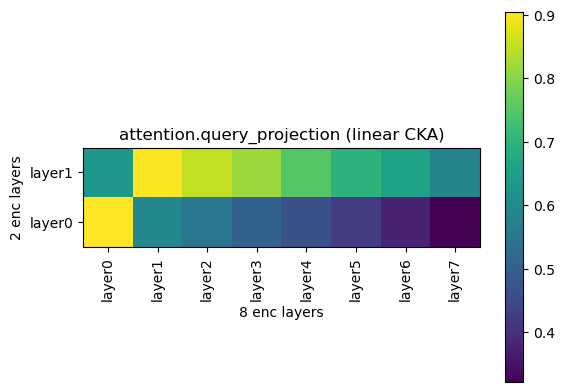

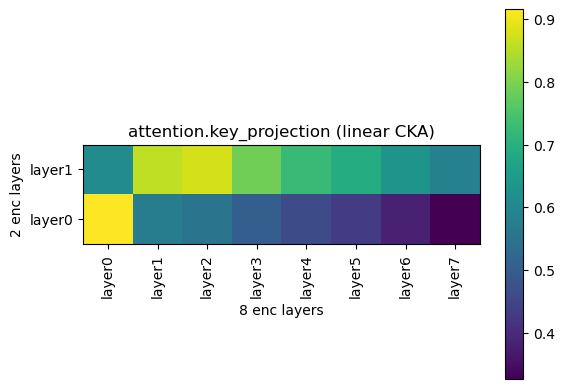

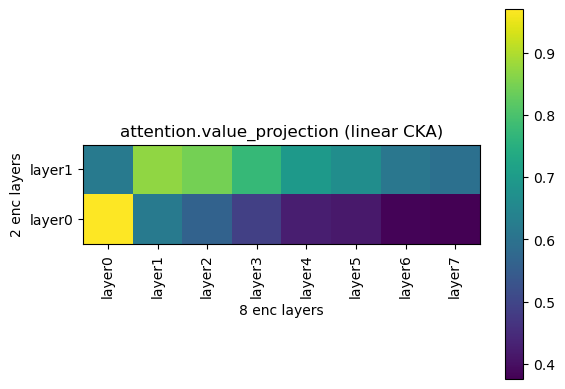

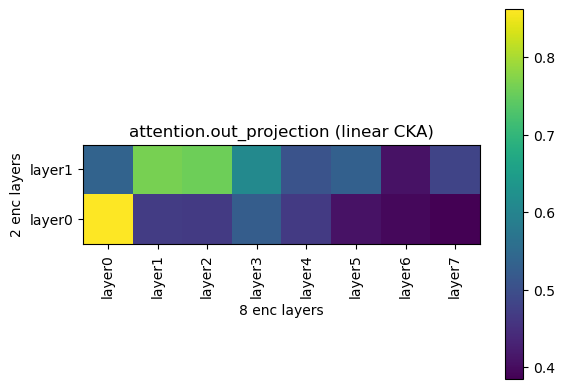

In [2]:
autoformer_v1 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL"
)  # n_enclayers = 2
autoformer_v2 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=8
)  # n_enclayers = 8

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_main(
    autoformer_v1,
    autoformer_v2,
    data_loader,
    nameA="2 enc layers",
    nameB="8 enc layers",
    CKA_type="linear",
    save_fig=True,
    num_stimuli=10,
)

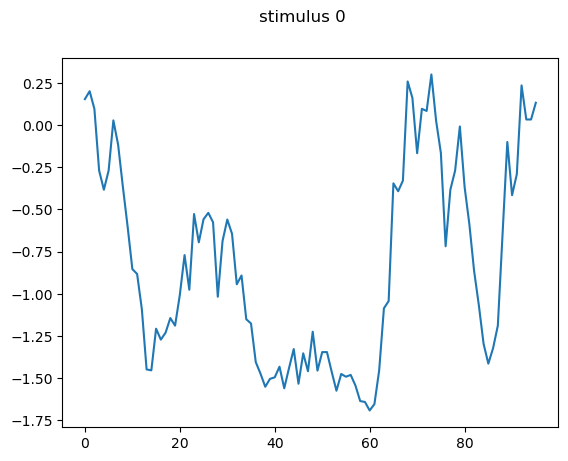

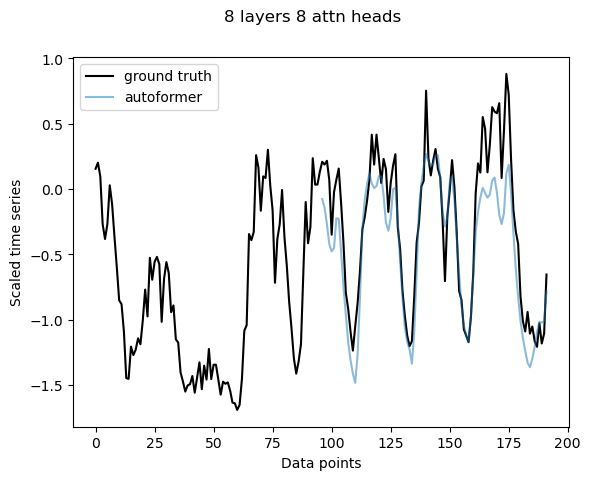

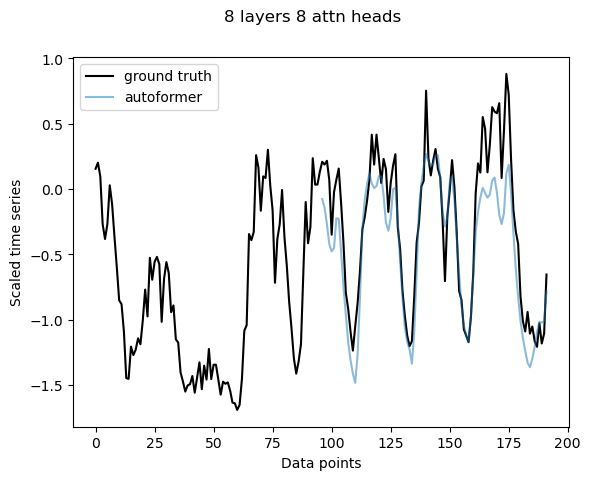

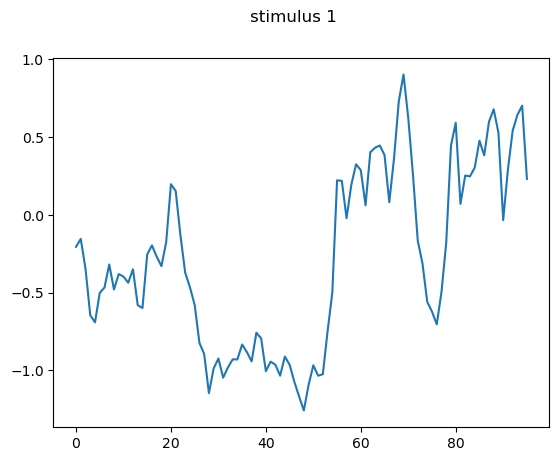

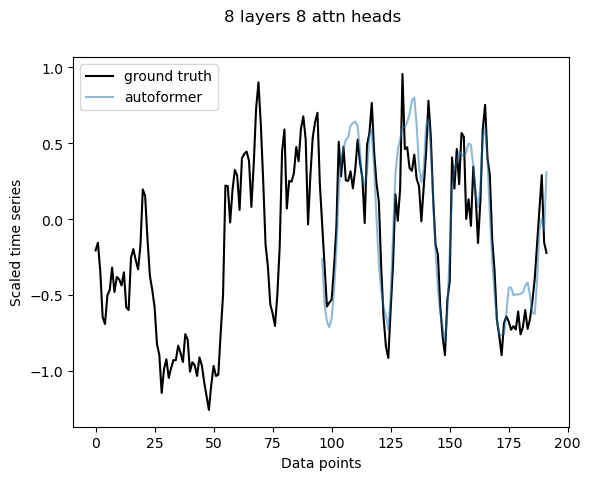

...

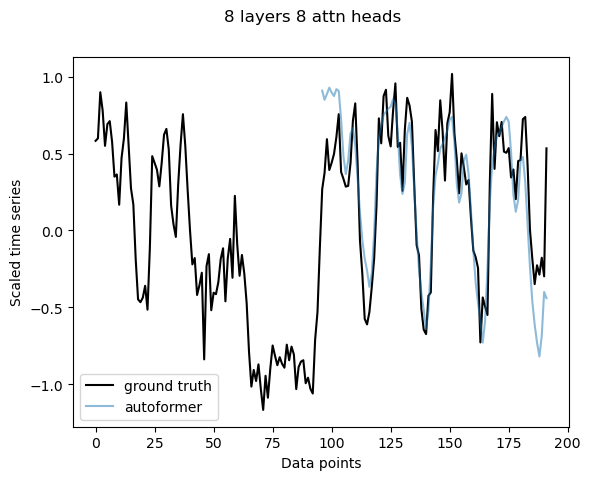

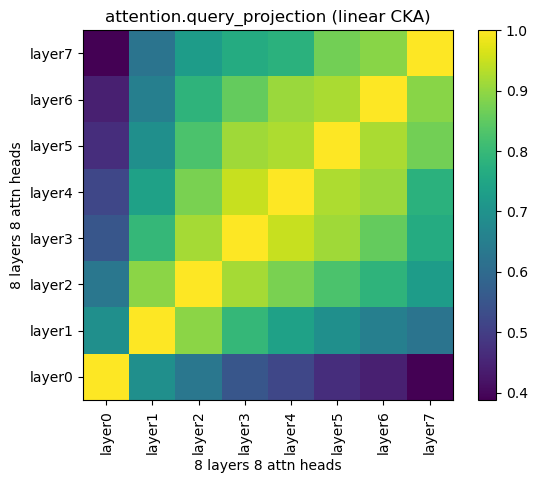

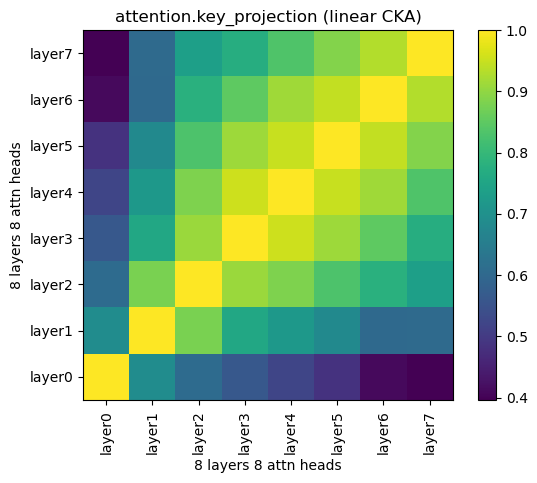

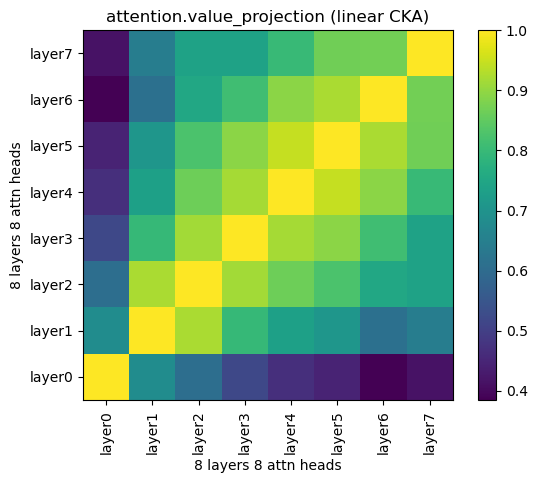

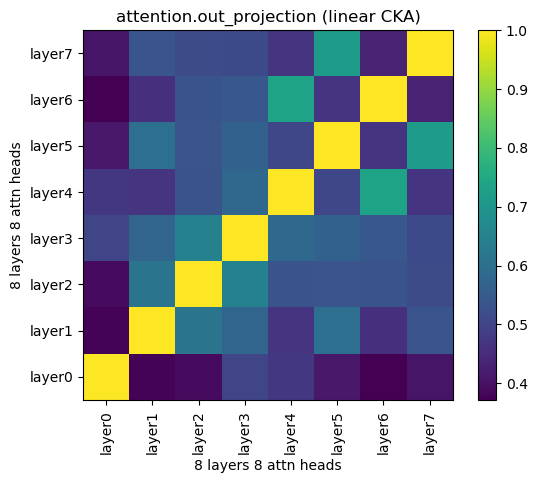

In [4]:
autoformer_v1 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=8, nh=8
)  # n_heads = 8
autoformer_v2 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=8, nh=8
)  # n_heads = 16

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_main(
    autoformer_v1,
    autoformer_v2,
    data_loader,
    nameA="8 layers 8 attn heads",
    nameB="8 layers 8 attn heads",
    CKA_type="linear",
    save_fig=True,
    num_stimuli=10,
    headwise=False,
)

### 3.2 More attention heads

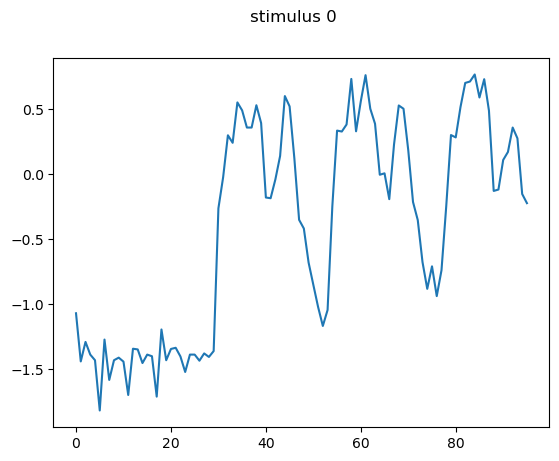

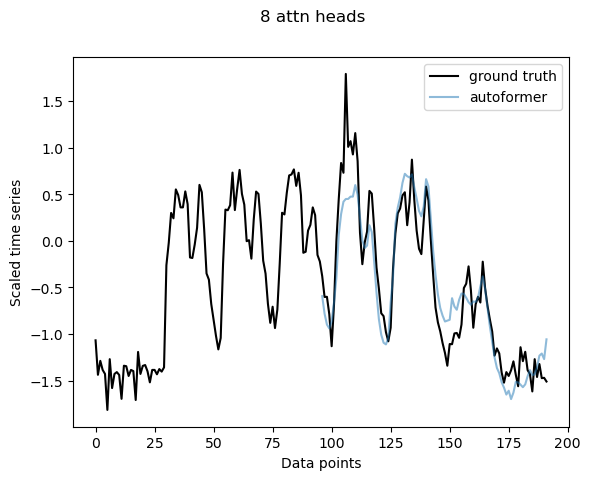

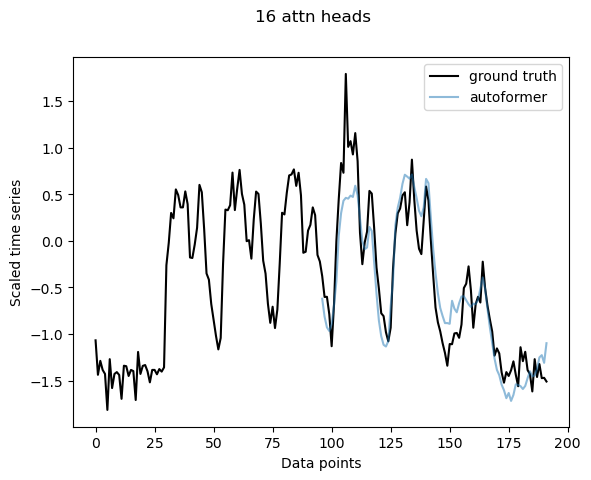

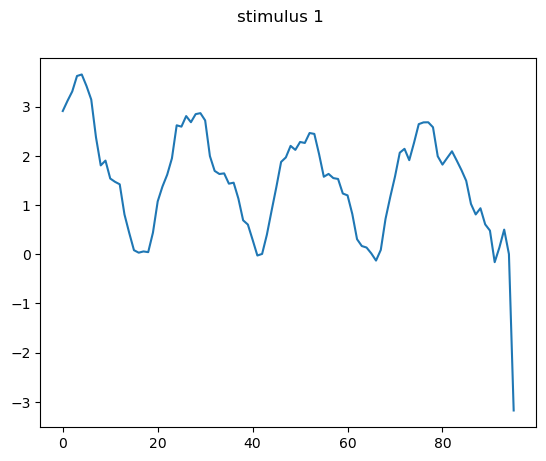

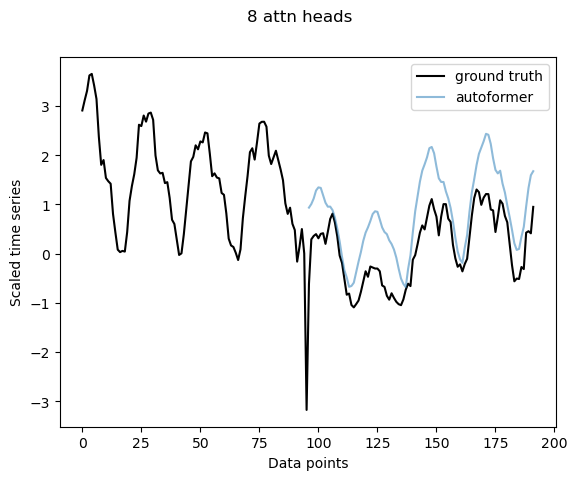

...

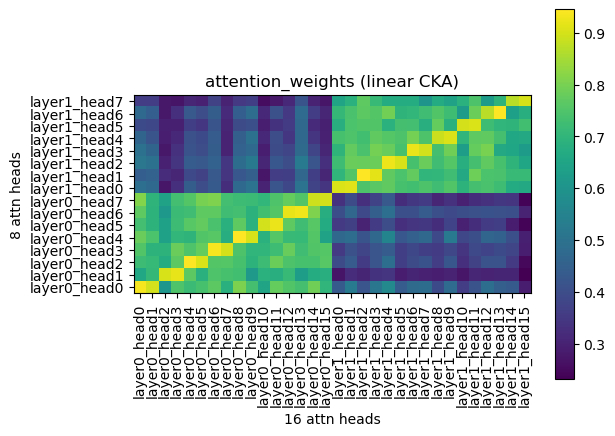

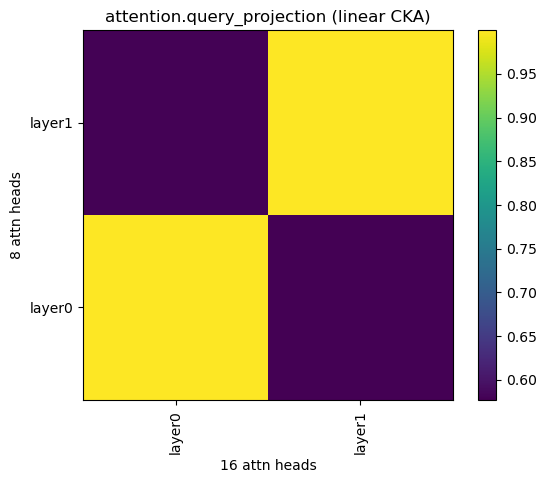

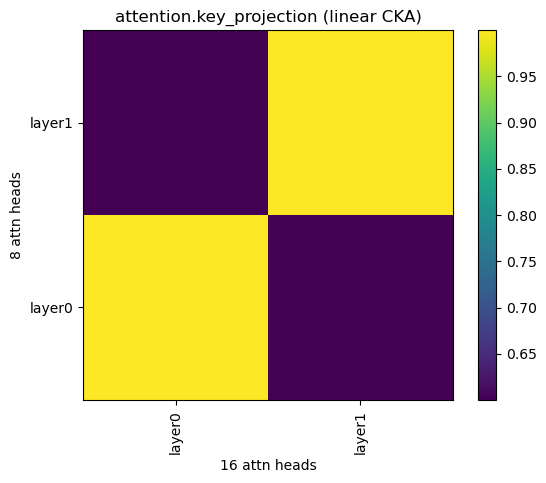

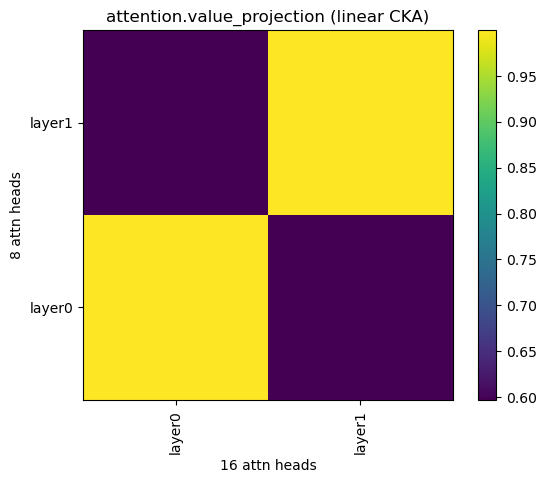

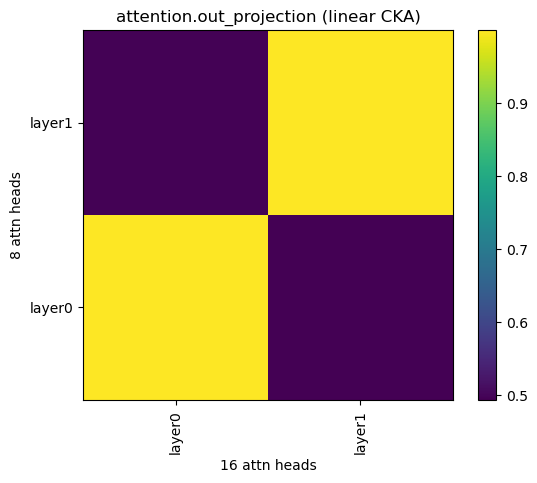

In [2]:
autoformer_v1 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL"
)  # n_heads = 8
autoformer_v2 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", nh=16
)  # n_heads = 16

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_main(
    autoformer_v1,
    autoformer_v2,
    data_loader,
    nameA="8 attn heads",
    nameB="16 attn heads",
    CKA_type="linear",
    save_fig=True,
    num_stimuli=10,
)

When doubling the number of attention heads, the extra heads seem to be copies. 
Therefore, a sanity check: if we compare the 16 layers with each other, do we see two diagonals? That is what to expect from the results above.

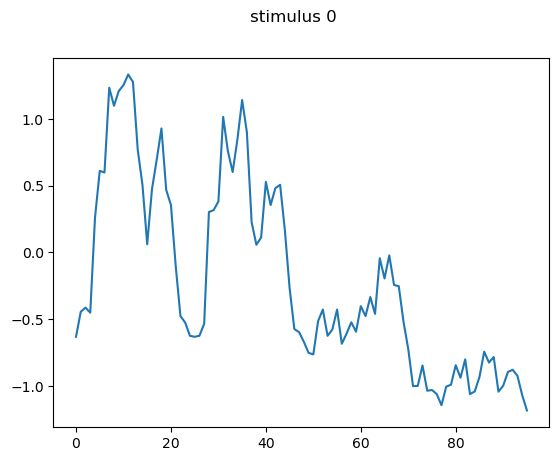

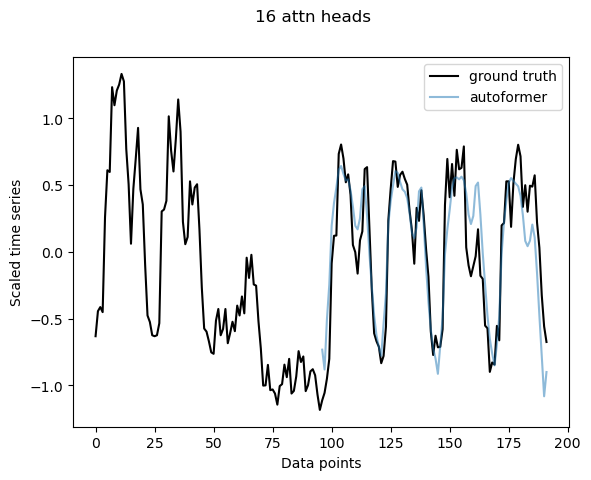

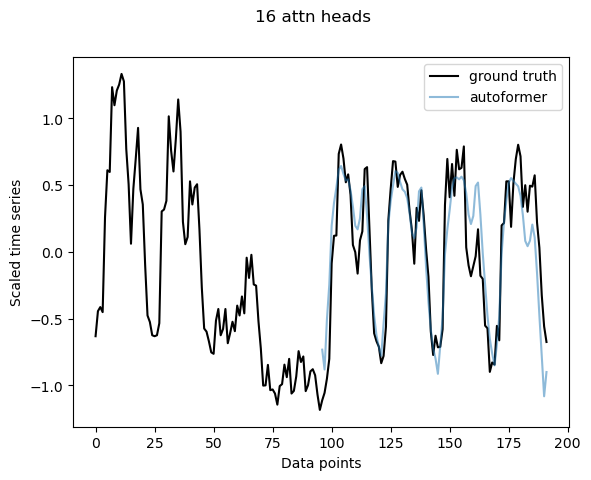

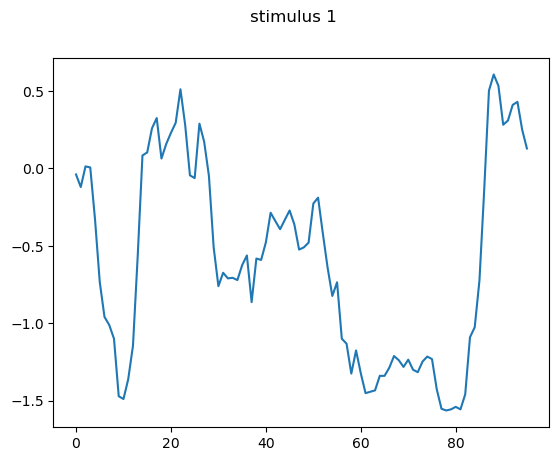

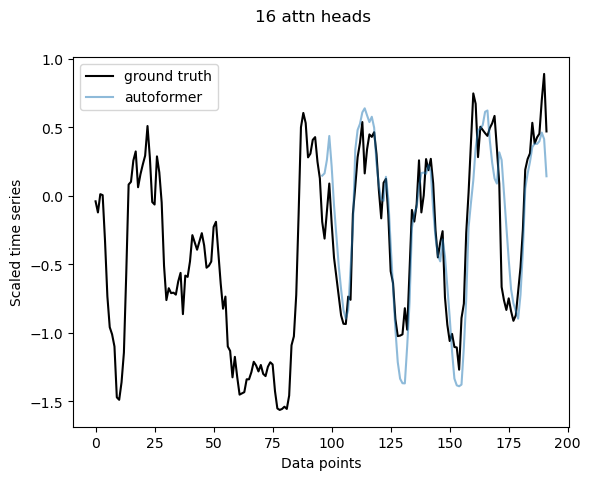

...

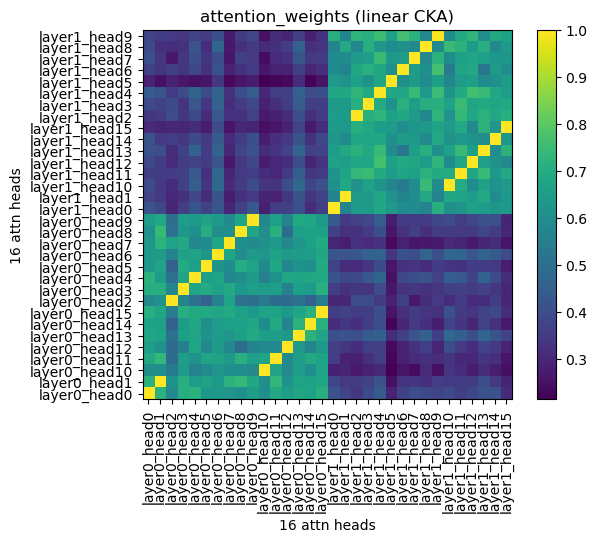

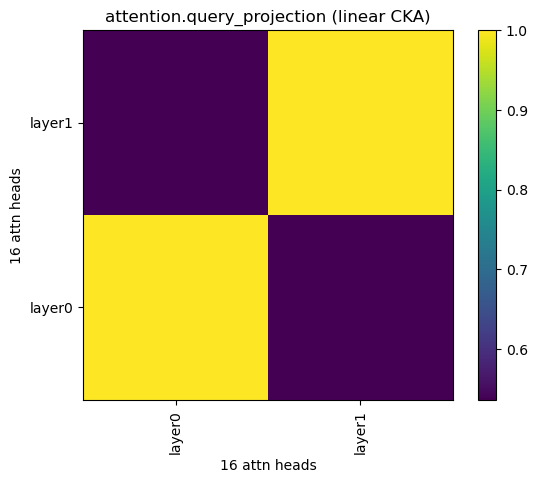

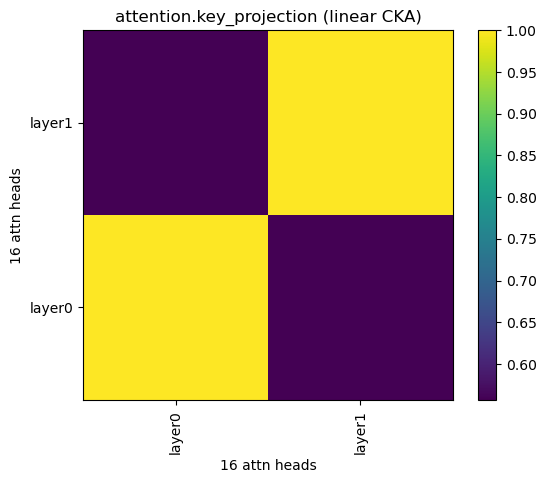

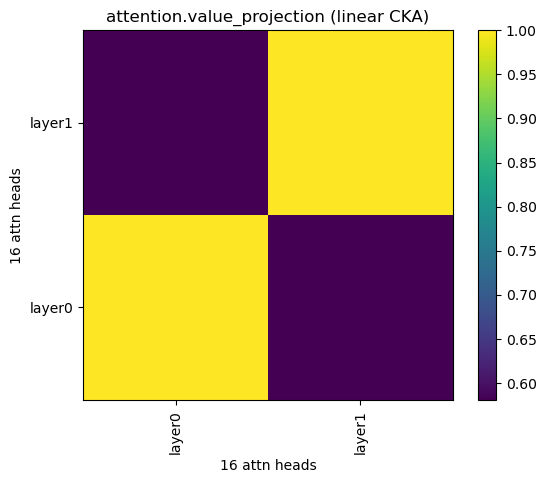

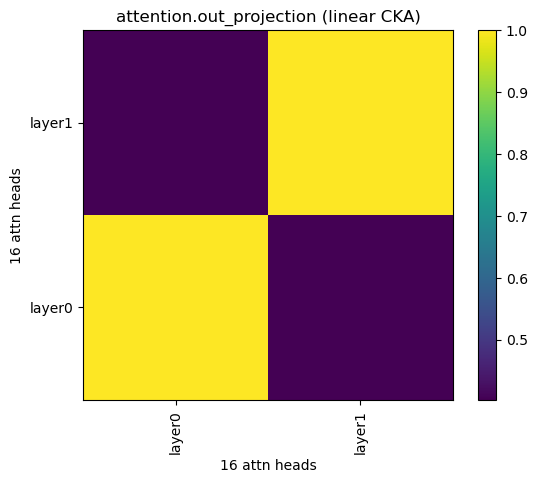

In [3]:
autoformer_v2 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", nh=16
)  # n_heads = 16

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_main(
    autoformer_v2,
    autoformer_v2,
    data_loader,
    nameA="16 attn heads",
    nameB="16 attn heads",
    CKA_type="linear",
    save_fig=True,
    num_stimuli=10,
)

### 3.3 More layers, more attention heads

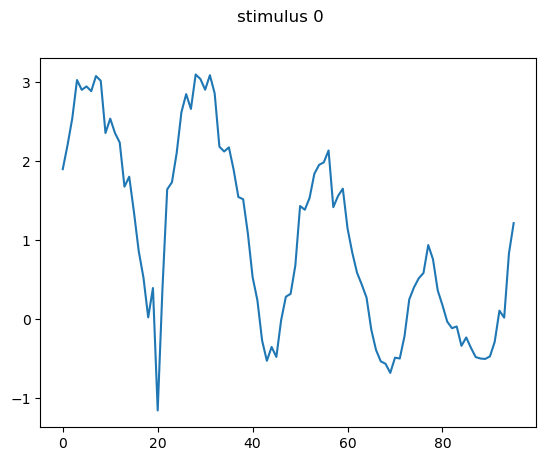

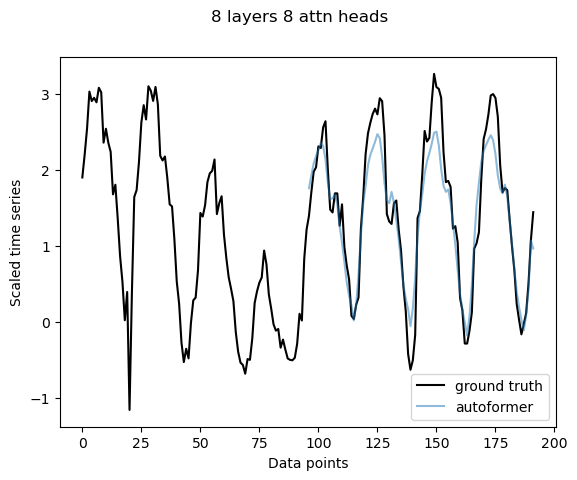

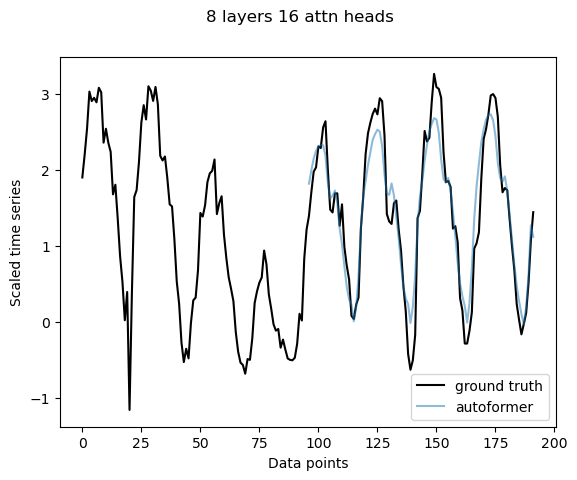

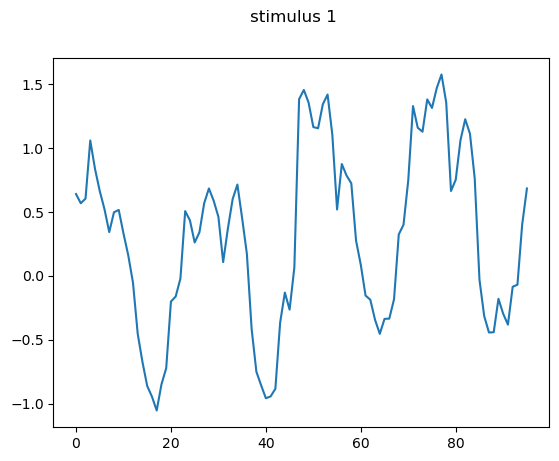

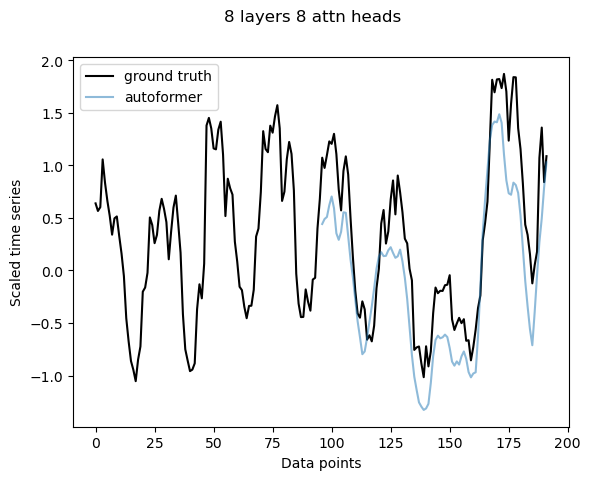

...

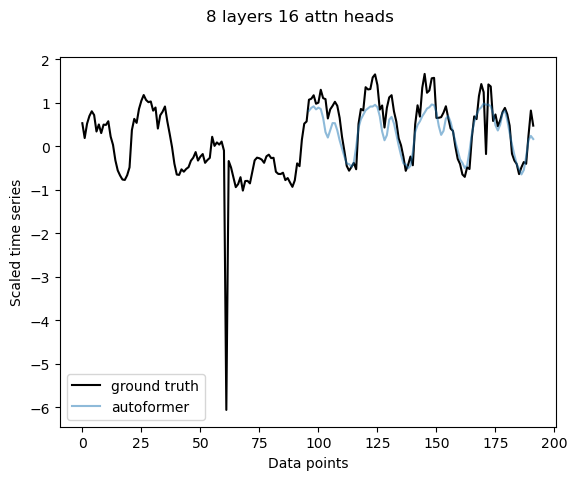

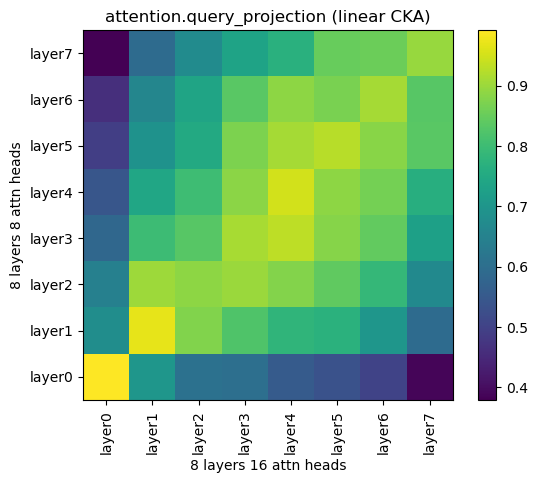

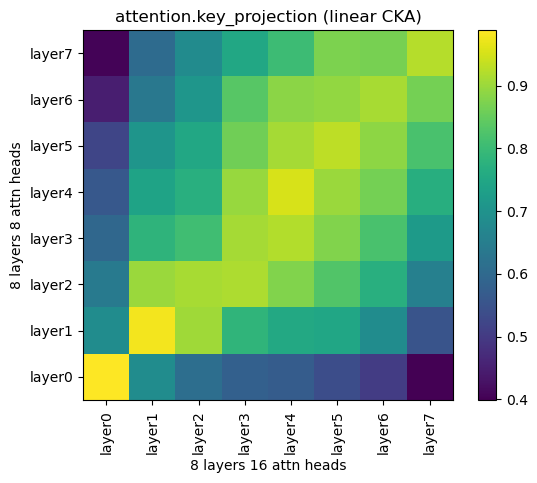

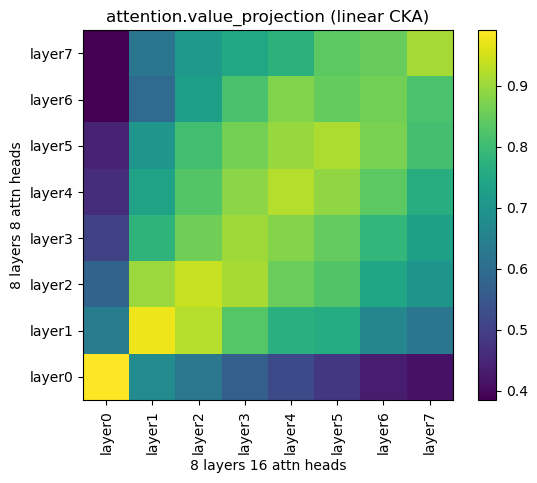

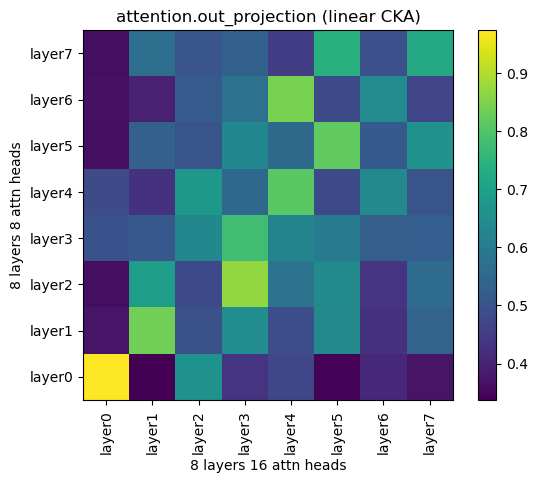

In [2]:
autoformer_v1 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=8, nh=8
)  # n_heads = 8
autoformer_v2 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=8, nh=16
)  # n_heads = 16

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_main(
    autoformer_v1,
    autoformer_v2,
    data_loader,
    nameA="8 layers 8 attn heads",
    nameB="8 layers 16 attn heads",
    CKA_type="linear",
    save_fig=True,
    num_stimuli=10,
    headwise=False,
)

## 4. CKA with less layers and/or heads

### Tryout
Below is an attempt to rewrite the plotting of CKA heatmaps, such that there are two sets of yticks labels, that either describe the layer or the head. However, did not manage solving this. TODO

In [51]:
import matplotlib.pyplot as plt


def plot_CKA_heatmaps(
    scores, descriptions, modelnames, type="linear", save_fig=False, name_fig=""
):
    for component in scores.keys():
        if (
            len(scores[component].values()) != 0
        ):  # if some hooks are not yet implemented, can be removed later
            fig = plt.figure()
            ax = fig.add_subplot(111)
            im = ax.imshow(scores[component].values())
            plt.title(f"{component} ({type} CKA)")
            plt.colorbar(im)
            plt.xticks(
                ticks=range(len(list(descriptions[component].values())[0])),
                labels=[],
                # labels=list(descriptions[component].values())[0],
                rotation=90,
            )
            plt.yticks(
                ticks=range(len(list(scores[component].keys()))),
                labels=[],
                # labels=list(scores[component].keys()[-1]),
            )
            ax2 = ax.twinx()
            ax2.set_ylim(ax.get_ylim())
            ax2.set_yticks(
                ticks=range(len(list(scores[component].keys()))),
                labels=[],
                # labels=list(scores[component].keys()[-1]),
            )
            # ax2.yaxis.set_label_position("right")

            plt.ylabel(modelnames[0])
            plt.xlabel(modelnames[1])
            if save_fig:
                if not os.path.exists(
                    f"plots/{modelnames[0]}_{modelnames[1]}_{name_fig}"
                ):
                    os.makedirs(f"plots/{modelnames[0]}_{modelnames[1]}_{name_fig}")
                plt.savefig(
                    f"plots/{modelnames[0]}_{modelnames[1]}_{name_fig}/{modelnames[0]}_{modelnames[1]}_{name_fig}_{component}.png",
                    bbox_inches="tight",
                )
            plt.show()

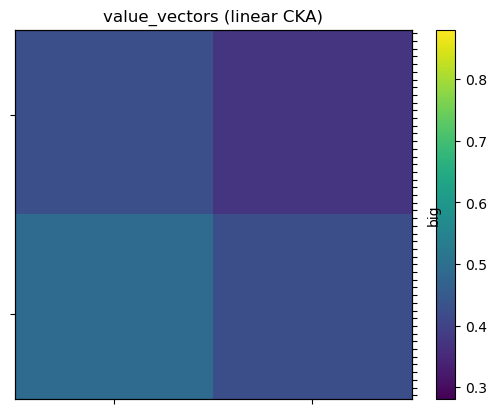

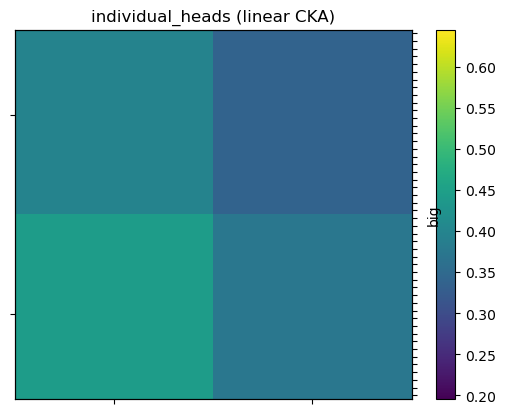

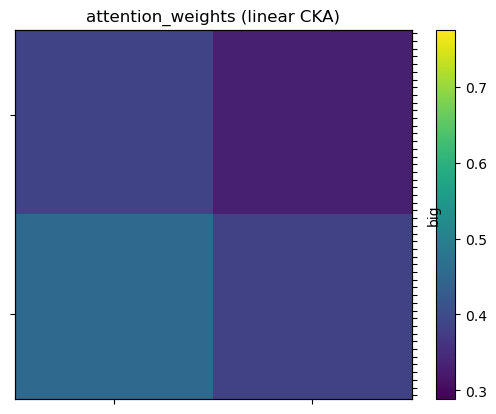

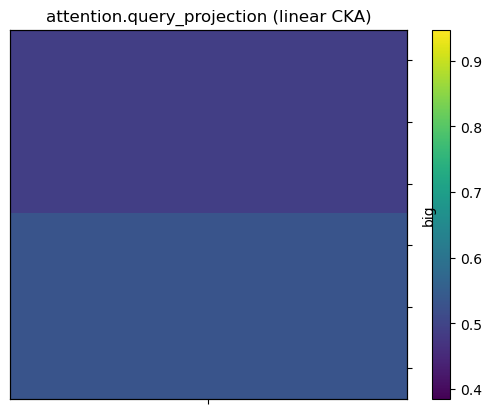

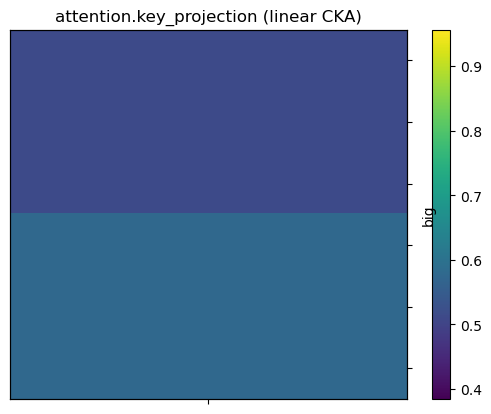

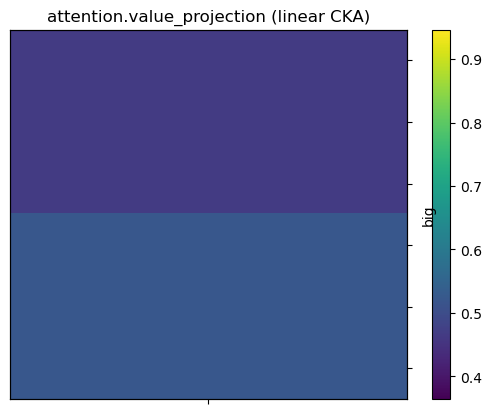

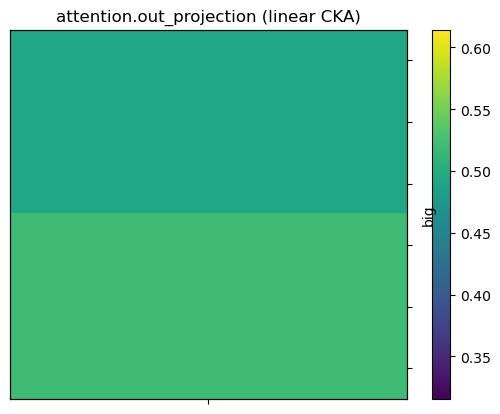

In [52]:
# plot_CKA_heatmaps(
#     scores, descriptions, modelnames, type="linear", save_fig=False, name_fig=""
# )

### 4.1. 1 layer, 2 heads

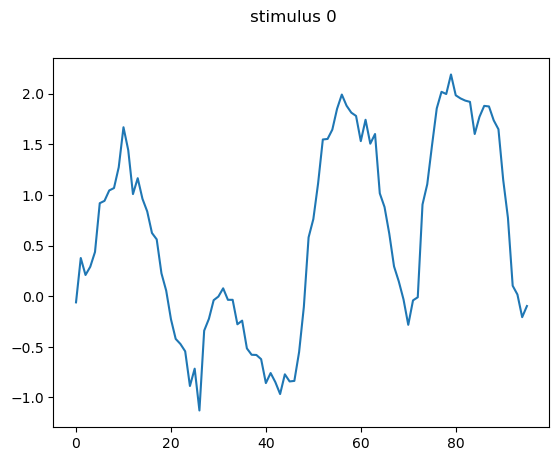

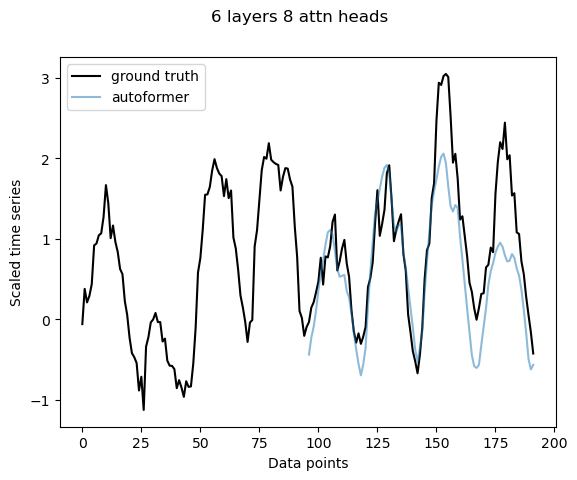

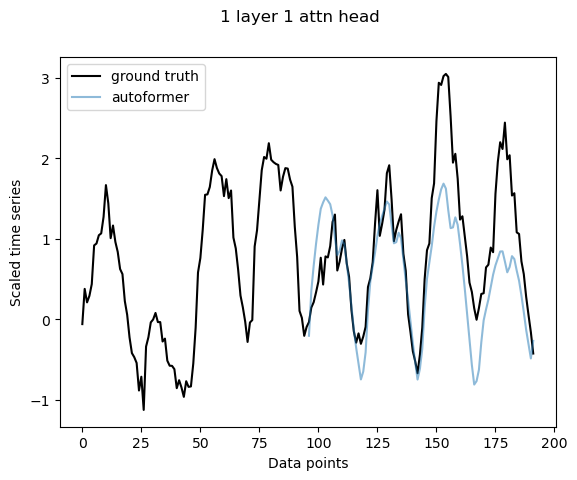

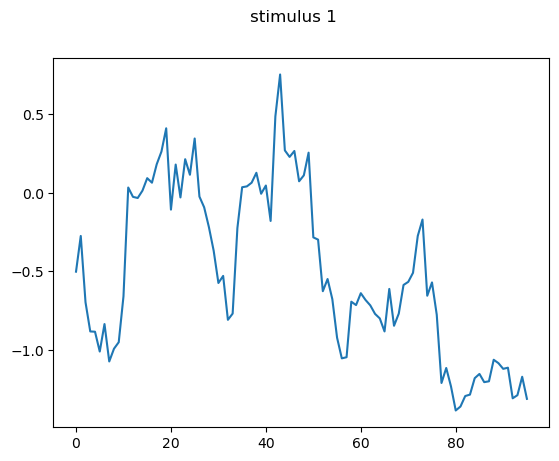

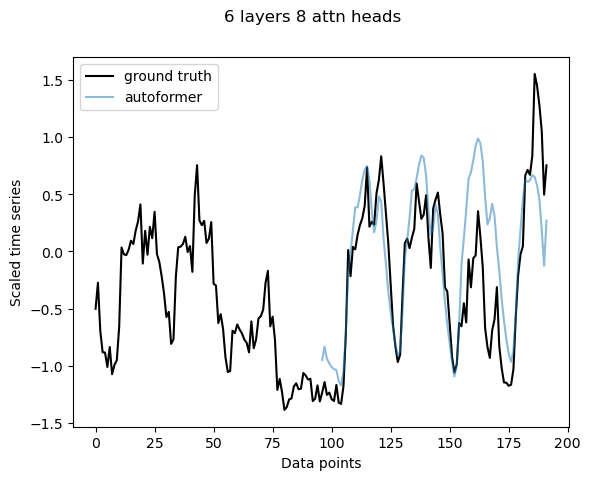

...

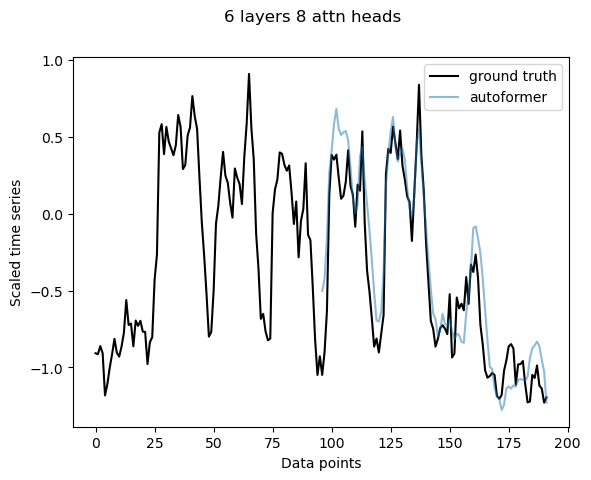

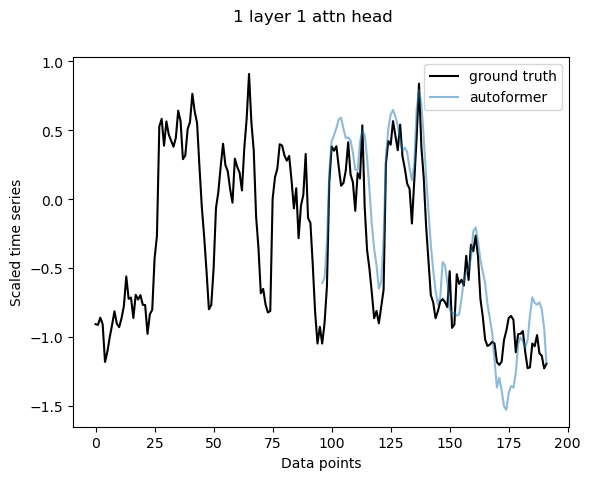

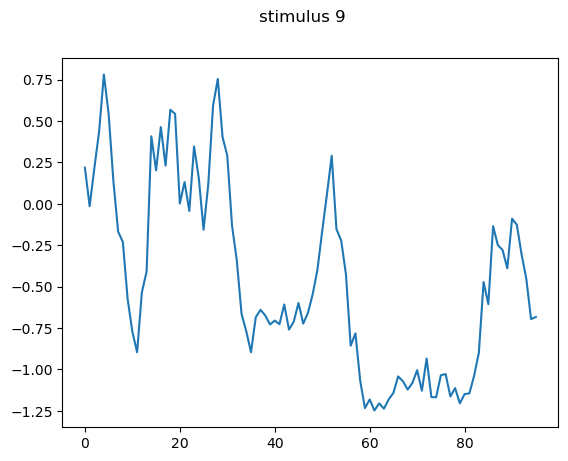

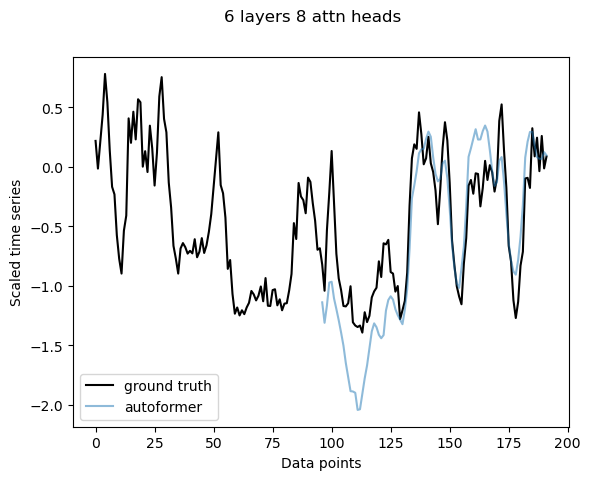

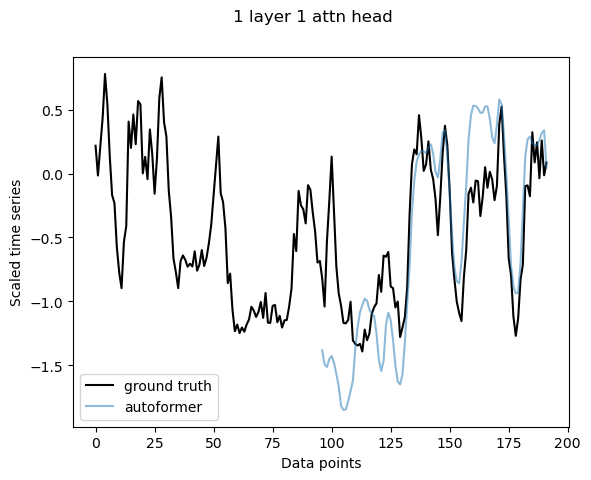

X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:  (960, 64)
X_i shape:

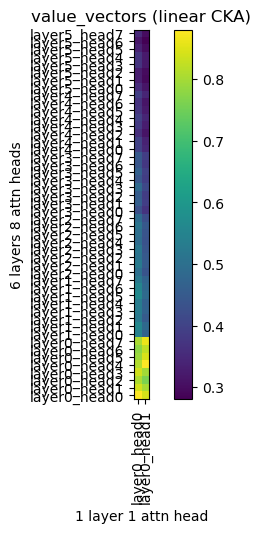

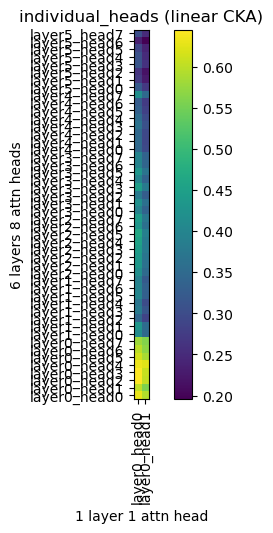

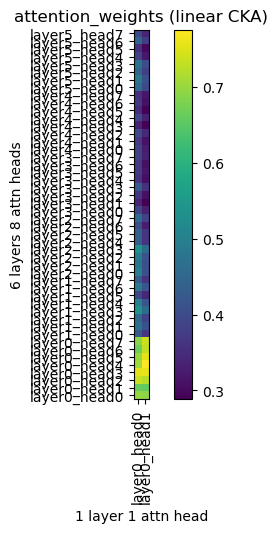

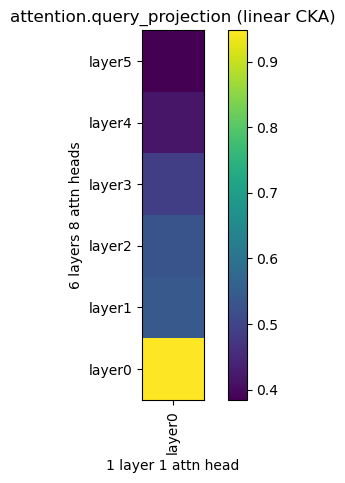

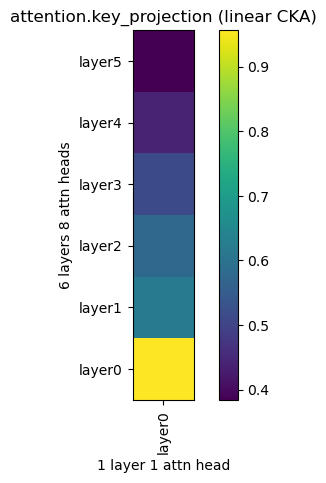

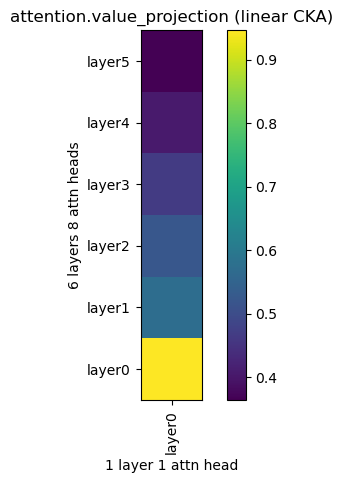

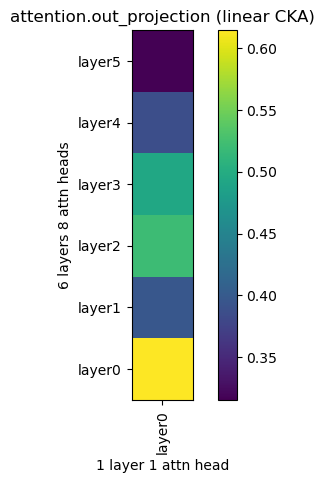

In [7]:
autoformer_v1 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=6, nh=8
)  # n_heads = 8
autoformer_v2 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=1, nh=2
)  # n_heads = 16

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_main(
    autoformer_v1,
    autoformer_v2,
    data_loader,
    nameA="6 layers 8 attn heads",
    nameB="1 layer 1 attn head",
    CKA_type="linear",
    save_fig=True,
    num_stimuli=10,
    headwise=True,
)

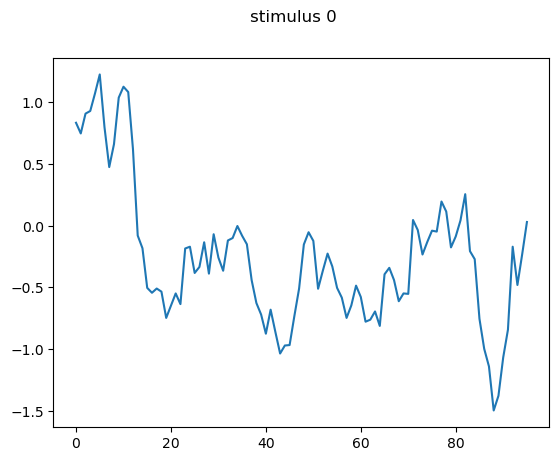

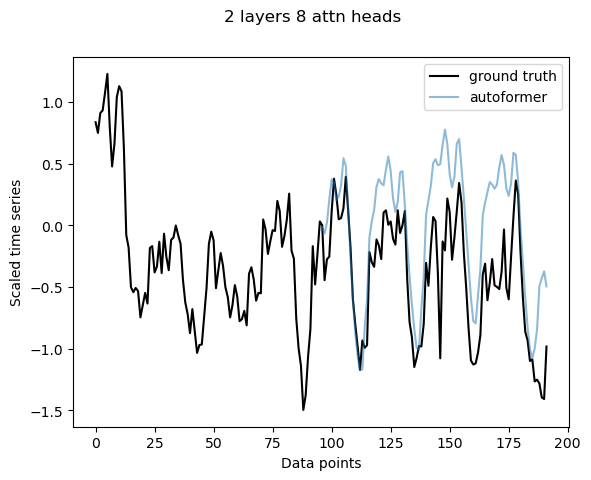

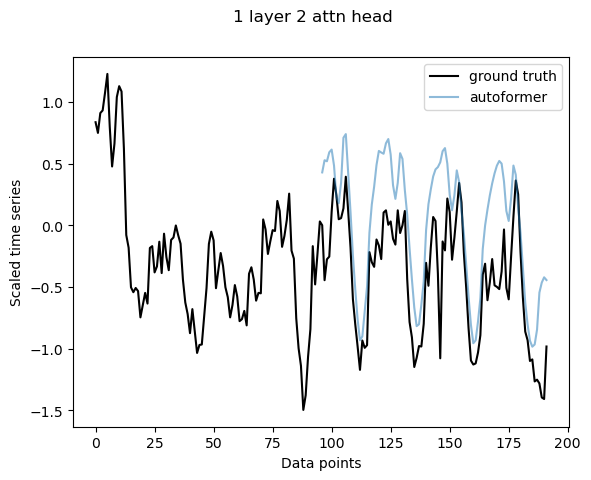

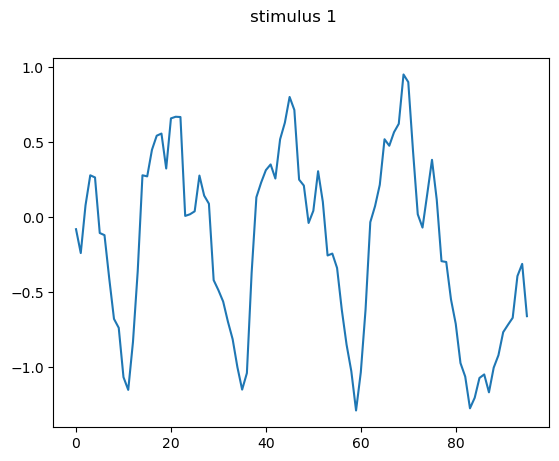

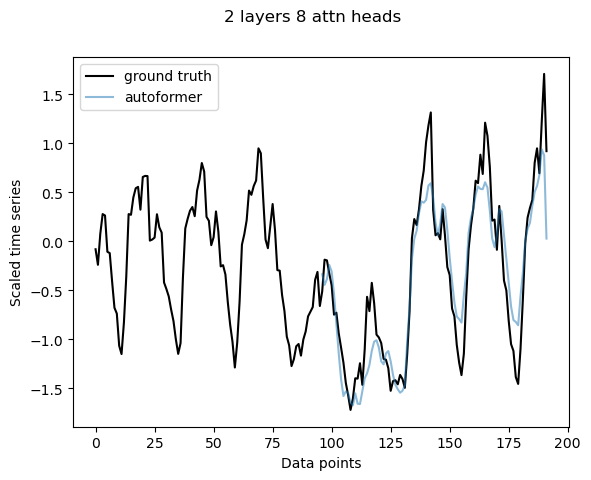

...

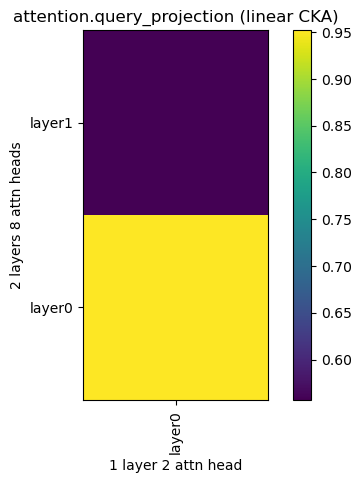

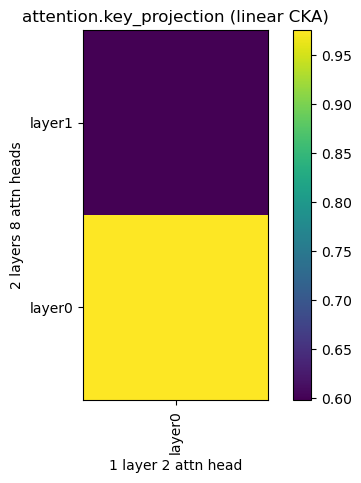

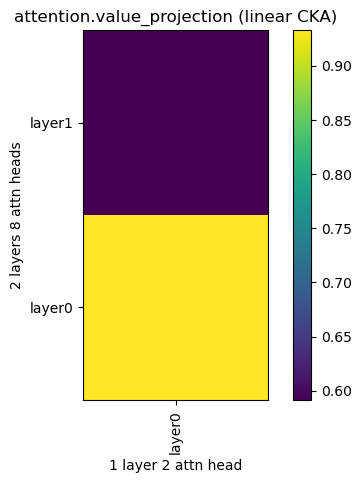

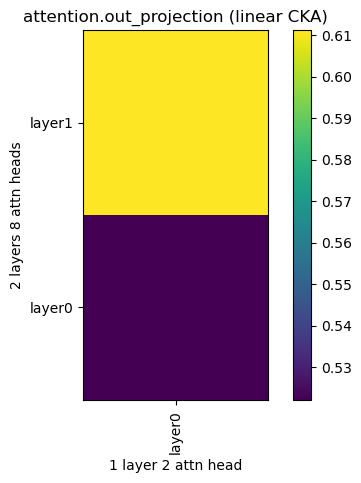

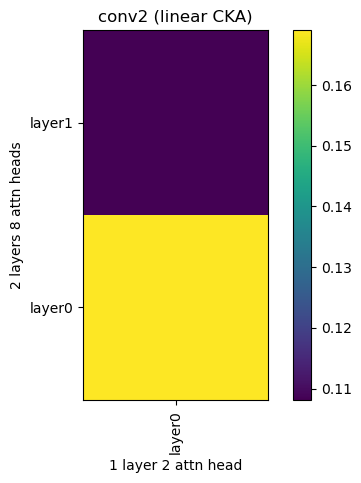

In [2]:
autoformer_v1 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=2, nh=8
)  # n_heads = 8
autoformer_v2 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=1, nh=2
)  # n_heads = 16

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_main(
    autoformer_v1,
    autoformer_v2,
    data_loader,
    nameA="2 layers 8 attn heads",
    nameB="1 layer 2 attn head",
    CKA_type="linear",
    save_fig=False,
    num_stimuli=10,
    headwise=True,
)

### 4.2. 1 layer, 1 head

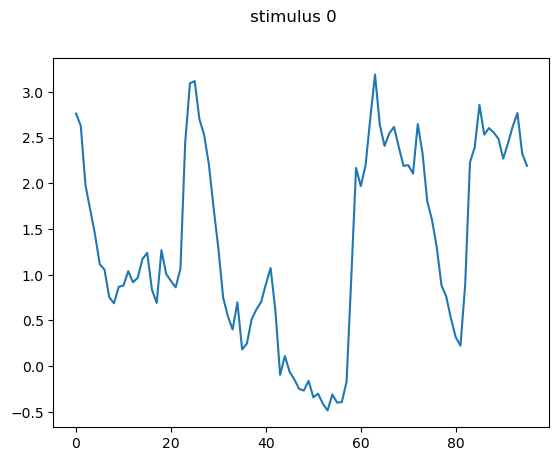

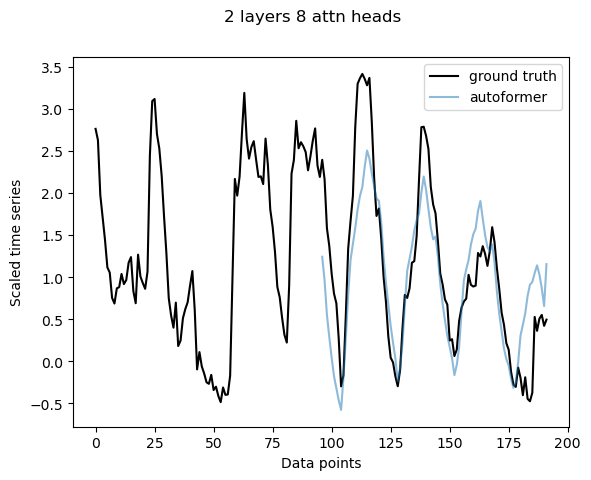

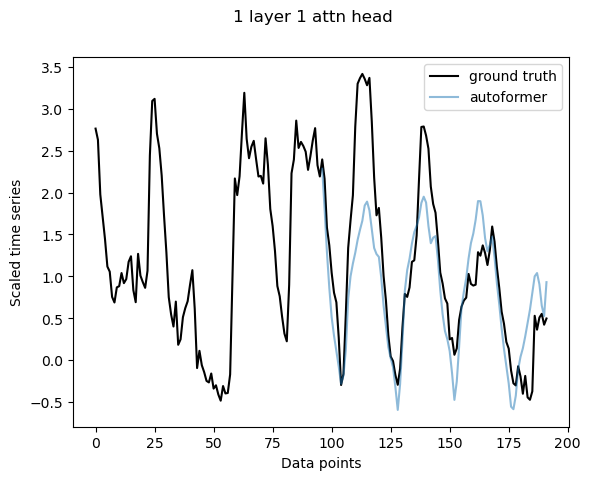

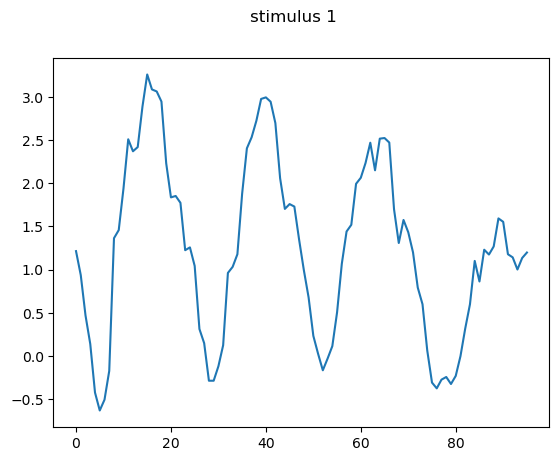

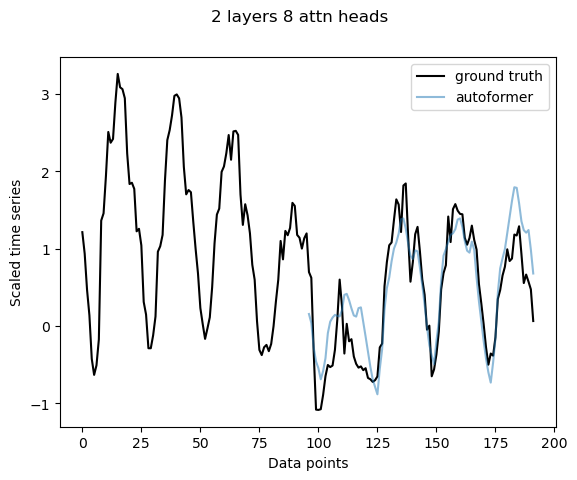

...

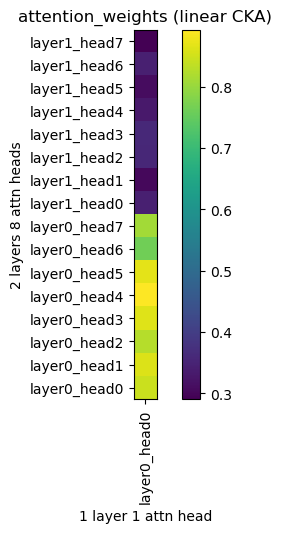

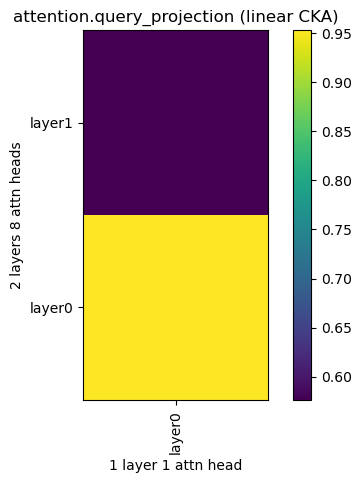

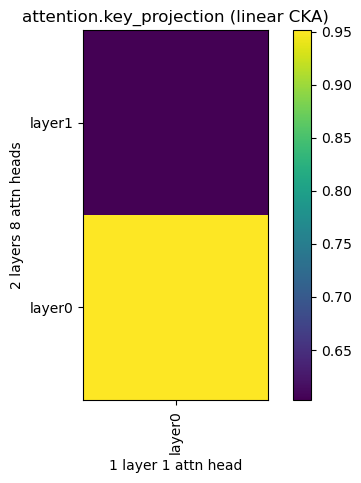

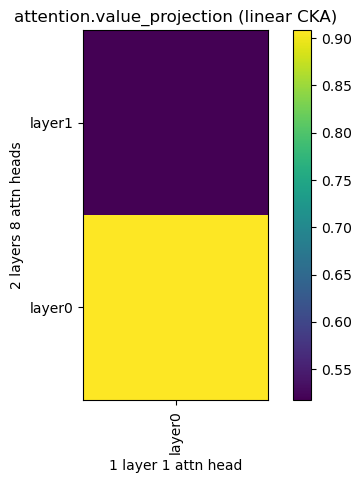

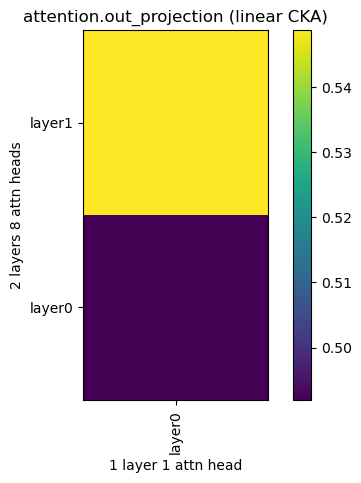

In [2]:
autoformer_v1 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=2, nh=8
)  # n_heads = 8
autoformer_v2 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=1, nh=1
)  # n_heads = 16

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_main(
    autoformer_v1,
    autoformer_v2,
    data_loader,
    nameA="2 layers 8 attn heads",
    nameB="1 layer 1 attn head",
    CKA_type="linear",
    save_fig=True,
    num_stimuli=10,
    headwise=True,
)

### 4.3 Two layers, one head

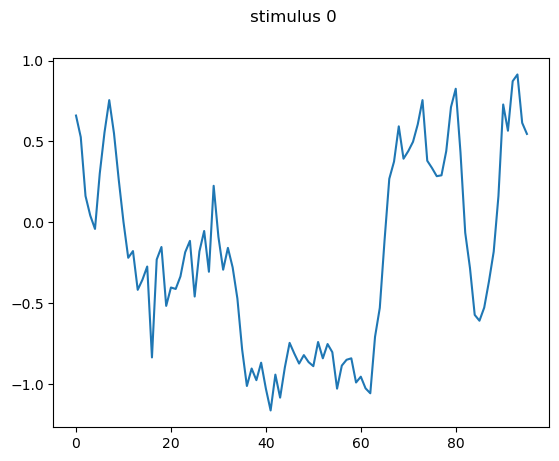

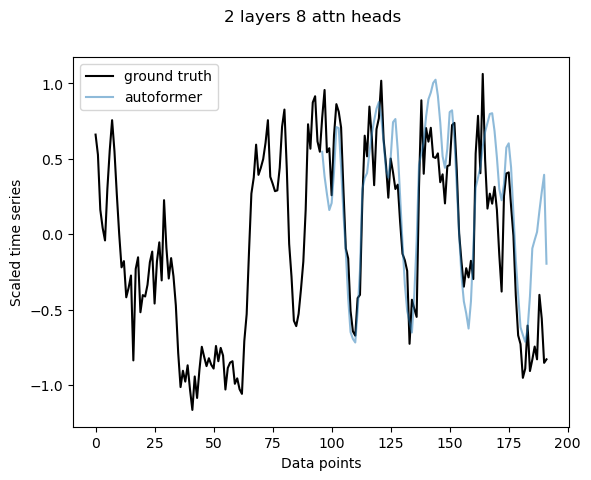

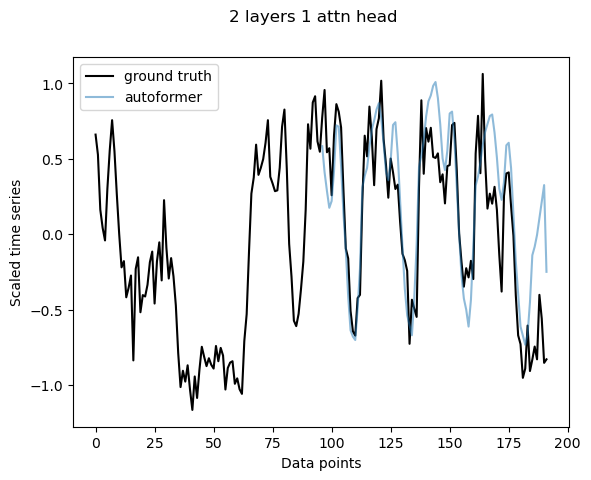

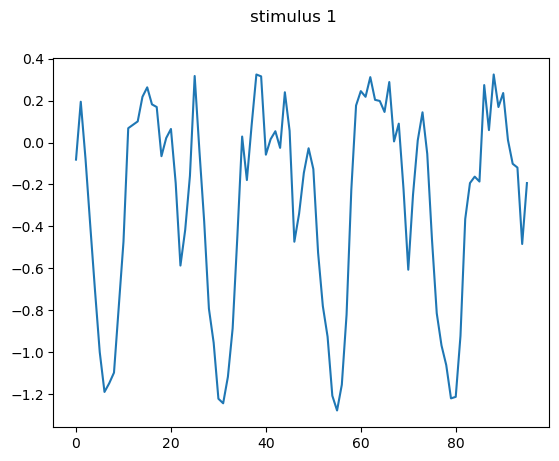

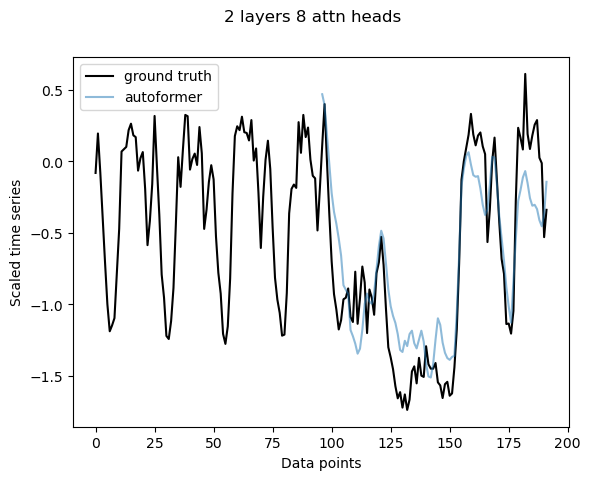

...

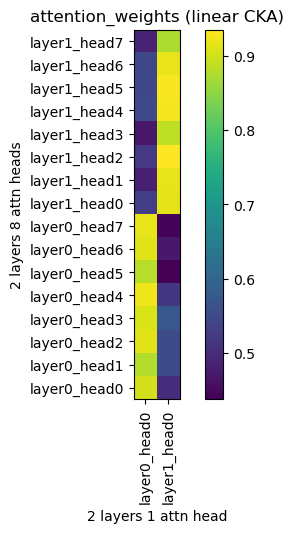

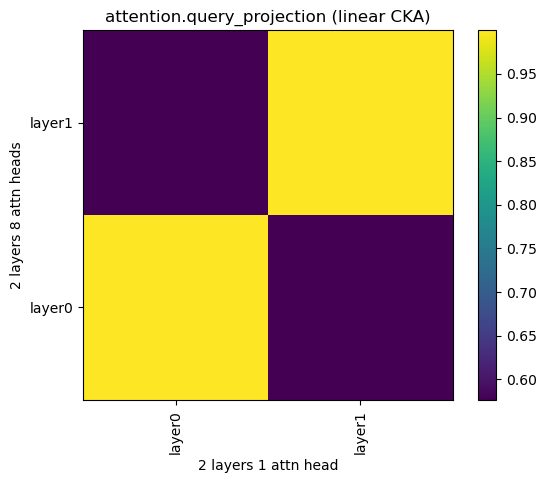

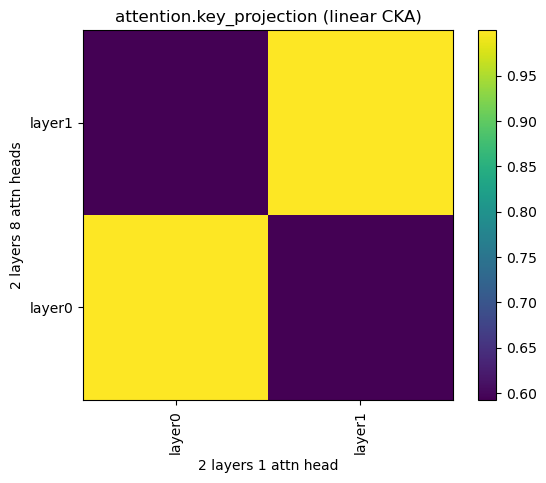

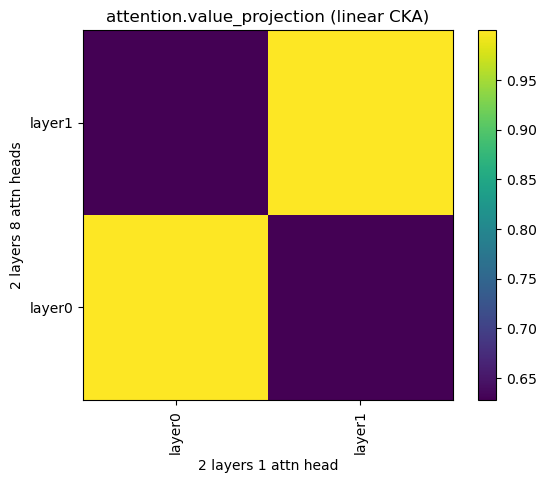

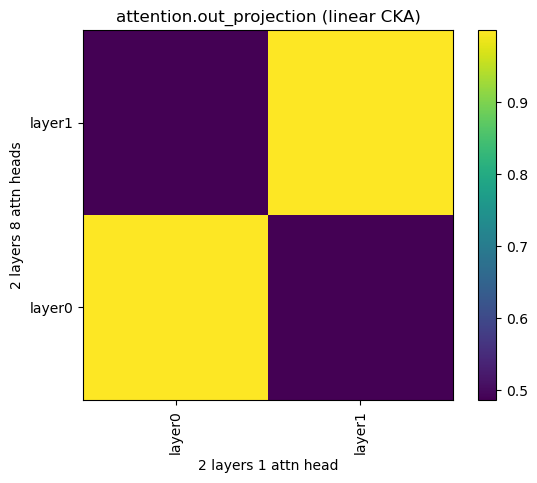

In [3]:
autoformer_v1 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=2, nh=8
)  # n_heads = 8
autoformer_v2 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=2, nh=1
)  # n_heads = 16

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_main(
    autoformer_v1,
    autoformer_v2,
    data_loader,
    nameA="2 layers 8 attn heads",
    nameB="2 layers 1 attn head",
    CKA_type="linear",
    save_fig=True,
    num_stimuli=10,
    headwise=True,
)

## 5. CKA with handcrafted representations

### 5.1 First attempt CKA with seasonal decomposition
In this section, we do a first attempt at employing CKA with handcrafted representations. 

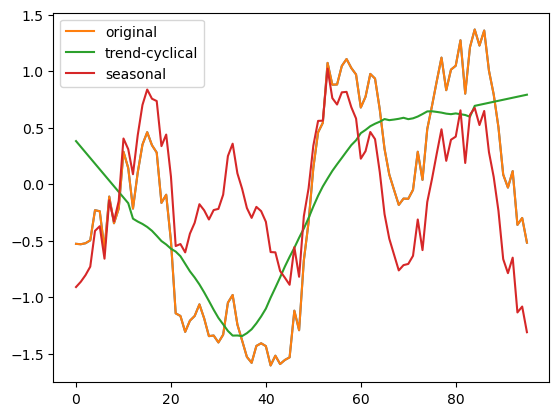

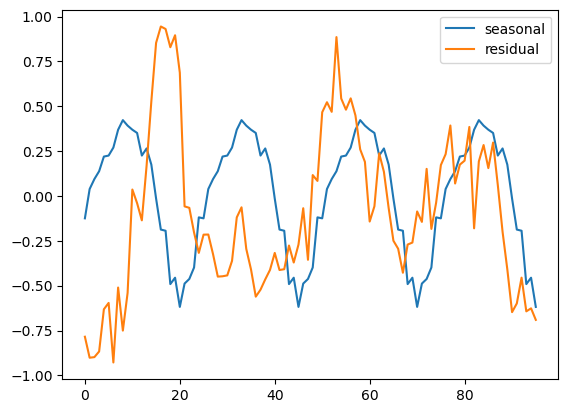

trend shape:  (96, 321)


In [2]:
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from collections import defaultdict


def get_decompose_activations(stimuli):
    """
    stimuli: list of (seq_x, seq_y, seq_x_mark, seq_y_mark), where seq_x has shape (1, num_datapoints, num_timeseries)
    returns (num_datapoints, num_timeseries)
    """
    activations = []

    for seq_x, seq_y, seq_x_mark, seq_y_mark in stimuli:
        activations.append(
            {
                "trend": None,
                "seasonal": None,
                "residual": None,
            }
        )
        plt.plot(seq_x[0, :, -1])
        decompose_result = seasonal_decompose(
            seq_x.squeeze(), model="additive", period=25, extrapolate_trend="freq"
        )  # moving avg of 25 is used in series decomposition
        trend, seasonal, residual = (
            decompose_result.trend,
            decompose_result.seasonal,
            decompose_result.resid,
        )
        plt.plot(seq_x[0, :, -1], label="original")
        plt.plot(trend[:, -1], label="trend-cyclical")
        plt.plot(seq_x[0, :, -1] - trend[:, -1], label="seasonal")
        plt.legend()
        plt.show()
        plt.plot(seasonal[:, -1], label="seasonal")
        plt.plot(residual[:, -1], label="residual")
        plt.legend()
        plt.show()

        activations[-1]["trend"] = trend
        print("trend shape: ", trend.shape)
        activations[-1]["seas_and_res"] = seasonal + residual
        activations[-1]["seasonal"] = seasonal
        activations[-1]["residual"] = residual

    return activations


data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")
for stimulus in data_loader:
    activations = get_decompose_activations([stimulus])
    break

Autoformer activations vs seasonal decompose

In [5]:
import numpy as np
import analysis.activations_interpretations.CKA_utils as CKA_utils


def obtain_CKA_heatmaps_layerwise_handcrafted(
    activations1, handcrafted_reprs, modelnames, type="linear", headwise=True
):
    """
    Obtain CKA heatmaps for activations with handcrafted representations, this method compares all components of activations1 with all components of activations2
    """
    results = defaultdict(defaultdict)
    descriptions = defaultdict(defaultdict)
    for component in activations1[-1].keys():
        for layer in activations1[-1][component].keys():

            X_list = tuple(
                X[component][layer][0].squeeze().numpy() for X in activations1
            )
            X = np.concatenate(X_list, axis=0)
            if len(X.shape) == 3:
                if headwise:
                    n_heads_X = X.shape[1]
                    for head in range(n_heads_X):
                        results[component][
                            "layer" + str(layer) + "_head" + str(head)
                        ] = []
                        descriptions[component][
                            "layer" + str(layer) + "_head" + str(head)
                        ] = []
            else:
                results[component]["layer" + str(layer)] = []
                descriptions[component]["layer" + str(layer)] = []
            for comparison_component in handcrafted_reprs[-1].keys():
                Y_list = tuple(Y[comparison_component] for Y in handcrafted_reprs)
                Y = np.concatenate(Y_list, axis=0)
                if len(Y.shape) == 1:
                    Y = np.expand_dims(Y, axis=1)

                if len(X.shape) == 3:  # we have activations per head
                    if headwise:
                        for head_x in range(n_heads_X):
                            X_i = X[:, head_x, :]
                            print("X_i.shape: ", X_i.shape)

                            print("Y.shape: ", Y.shape)
                            if type == "linear":
                                score = CKA_utils.linear_CKA(X_i, Y)
                            elif type == "kernel":
                                score = CKA_utils.kernel_CKA(X_i, Y)
                            print("score: ", score)

                            results[component][
                                "layer" + str(layer) + "_head" + str(head_x)
                            ].append(score)
                            descriptions[component][
                                "layer" + str(layer) + "_head" + str(head_x)
                            ].append(str(comparison_component))

                else:
                    print("component: ", component)
                    print("comparison_component: ", comparison_component)
                    print("X shape: ", X.shape)
                    print("Y shape: ", Y.shape)
                    if type == "linear":
                        score = CKA_utils.linear_CKA(X, Y)
                    elif type == "kernel":
                        score = CKA_utils.kernel_CKA(X, Y)

                    results[component]["layer" + str(layer)].append(score)
                    descriptions[component]["layer" + str(layer)].append(
                        str(comparison_component)
                    )
        d = results[component]
        results[component] = dict(sorted(d.items(), reverse=True))
    return results, descriptions, modelnames

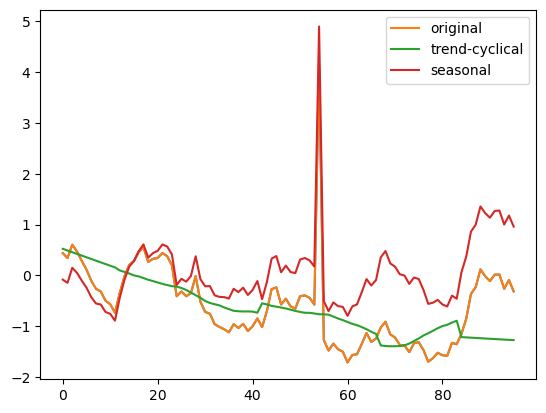

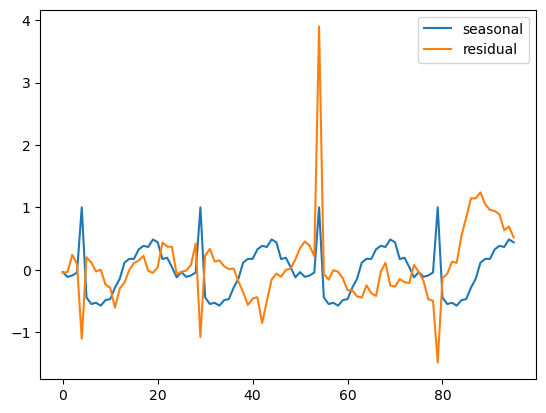

trend shape:  (96, 321)


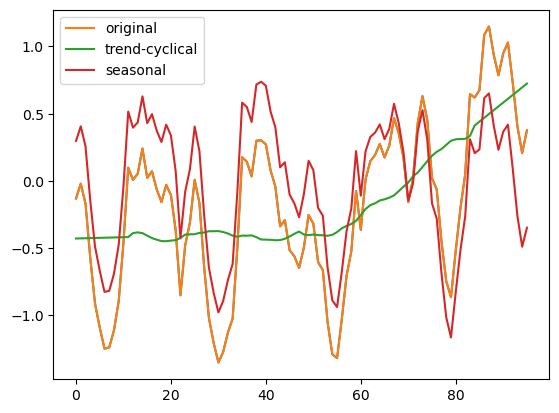

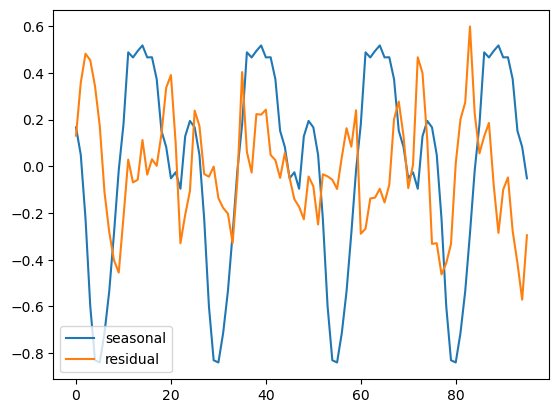

trend shape:  (96, 321)


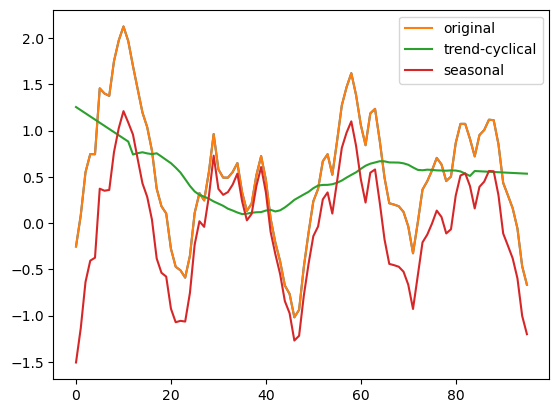

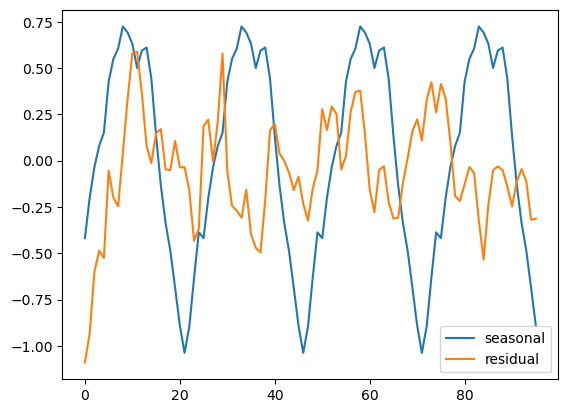

trend shape:  (96, 321)
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.5159761875997333
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.42400942351693555
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.4784761317989492
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.4176773435511289
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.4821633129102704
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.4832660946534083
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.4616348799329324
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.52613622218185
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.4351826475482714
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.6337117686546027
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.5181859129179948
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.5618279394132529
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.5340421093999925
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.60441792859973

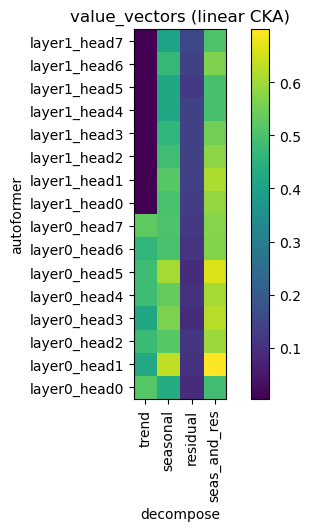

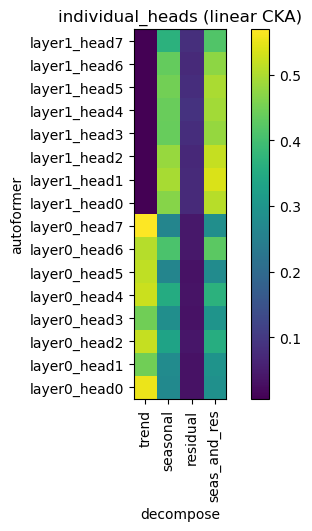

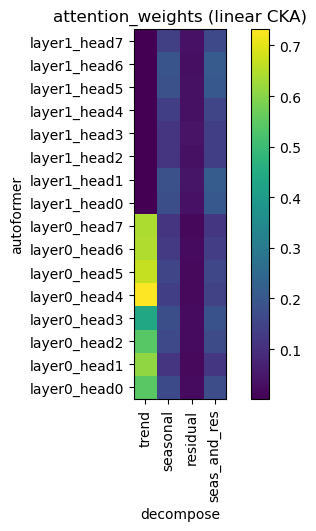

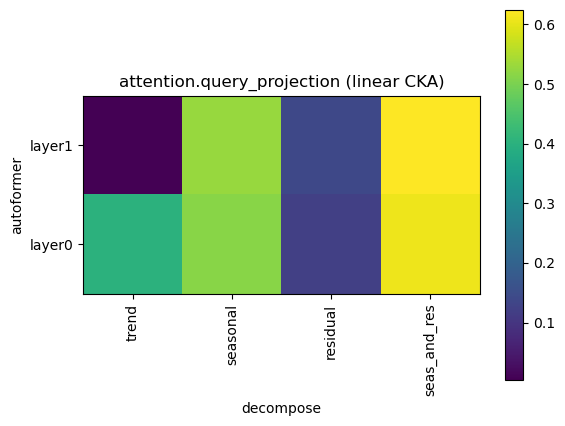

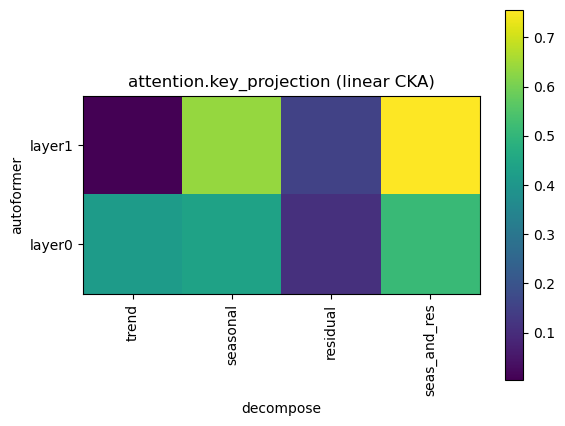

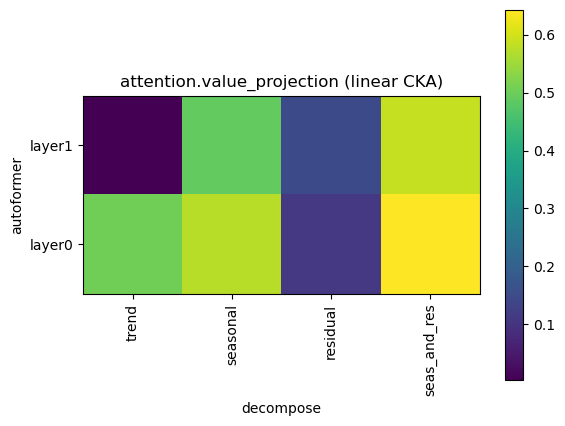

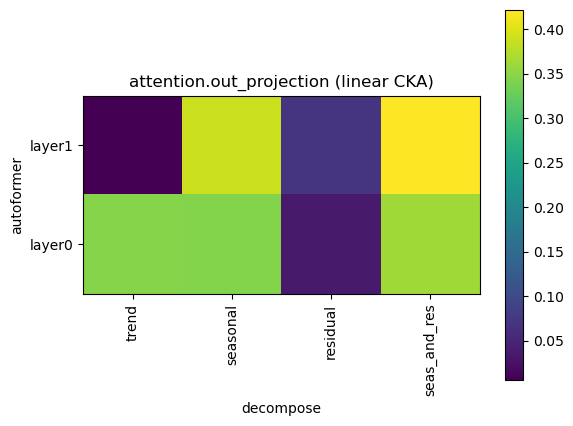

In [4]:
autoformer_7 = data_utils.obtain_autoformer(pred_len=96, dataset="ECL")
data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

stimulus_set = []
no_stimuli = 3

for i, stimulus in enumerate(data_loader):
    if i < no_stimuli:
        stimulus_set.append(stimulus)
    else:
        break

activations_decompose = get_decompose_activations(stimulus_set)
activations_autoformer = activations_file.get_activations_for_dataset(
    model=autoformer_7, stimuli=stimulus_set
)

results, descriptions, modelnames = obtain_CKA_heatmaps_layerwise_handcrafted(
    activations_autoformer, activations_decompose, ["autoformer", "decompose"]
)
CKA.plot_CKA_heatmaps(results, descriptions, modelnames)

In [6]:
autoformer_7.encoder

Encoder(
  (attn_layers): ModuleList(
    (0-1): 2 x EncoderLayer(
      (attention): AutoCorrelationLayer(
        (inner_correlation): AutoCorrelation(
          (dropout): Dropout(p=0.05, inplace=False)
        )
        (query_projection): Linear(in_features=512, out_features=512, bias=True)
        (key_projection): Linear(in_features=512, out_features=512, bias=True)
        (value_projection): Linear(in_features=512, out_features=512, bias=True)
        (out_projection): Linear(in_features=512, out_features=512, bias=True)
        (individual_heads): HookPoint()
        (attn_weights): HookPoint()
        (value_vectors): HookPoint()
      )
      (conv1): Conv1d(512, 2048, kernel_size=(1,), stride=(1,), bias=False)
      (conv2): Conv1d(2048, 512, kernel_size=(1,), stride=(1,), bias=False)
      (decomp1): series_decomp(
        (moving_avg): moving_avg(
          (avg): AvgPool1d(kernel_size=(25,), stride=(1,), padding=(0,))
        )
      )
      (decomp2): series_decomp(
  

#TODO: This error occurs because I have added a hook after conv2, which has output dimension 512, therefore it is not comparable with the handcrafted representations. Take a look at this. Maybe skip this hook, or place it somewhere else?

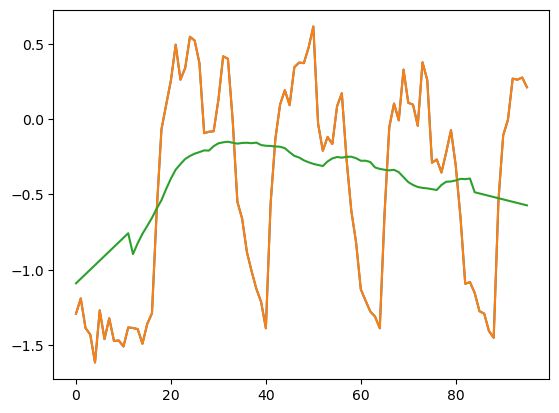

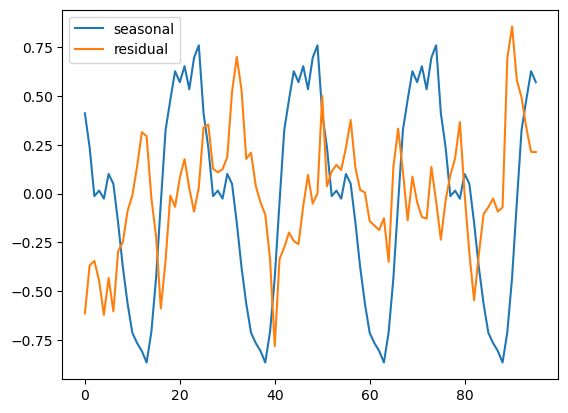

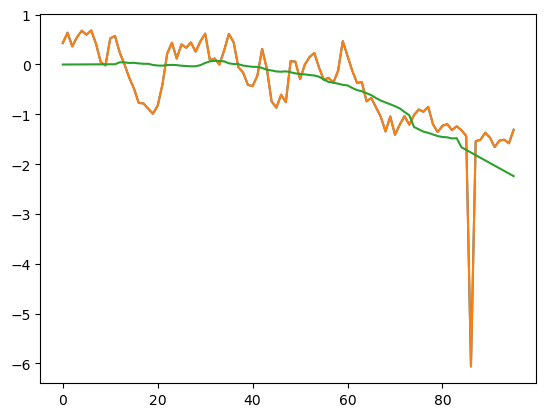

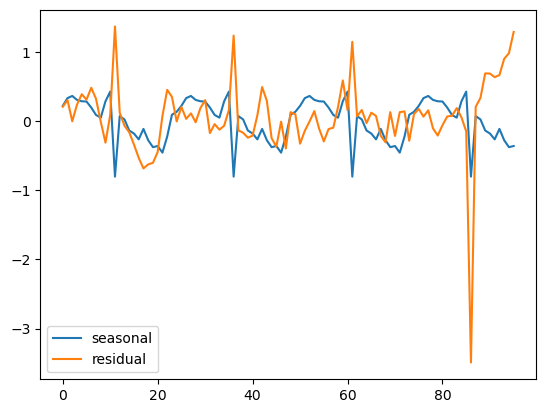

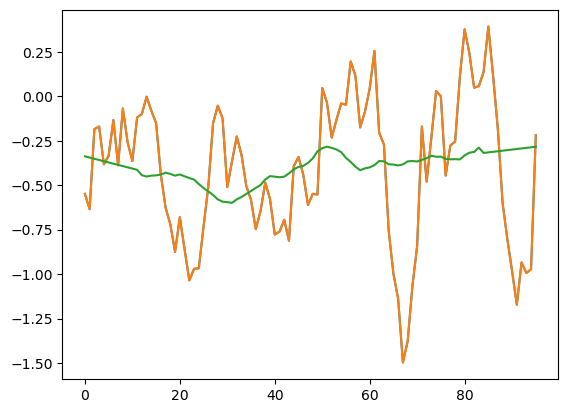

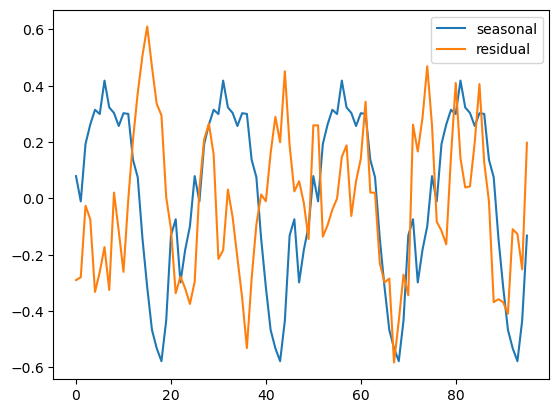

X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.48718613575766817
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.40161260570788815
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.4337741927462511
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.4292824303350258
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.40043231391531325
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.36885547867672774
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.4668768695154101
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.43979287760837105
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.38610926942624135
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.624245706857637
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.5600404368879254
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.5345262431088006
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.5576115446233741
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.6287212629704344
X_i.shape:  (28

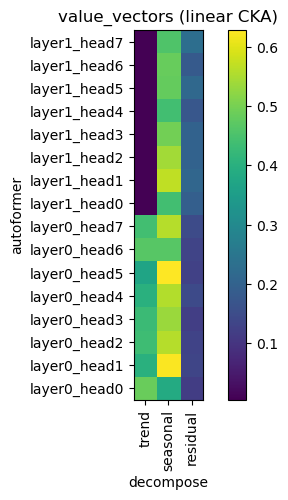

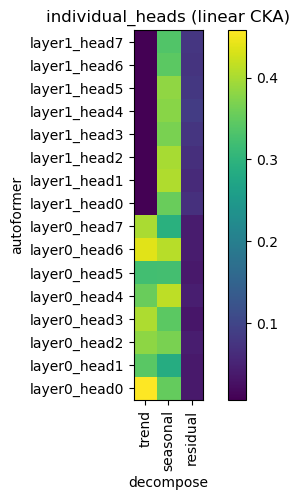

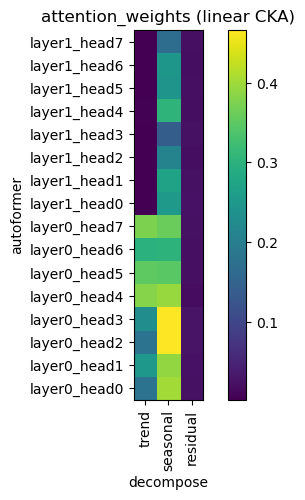

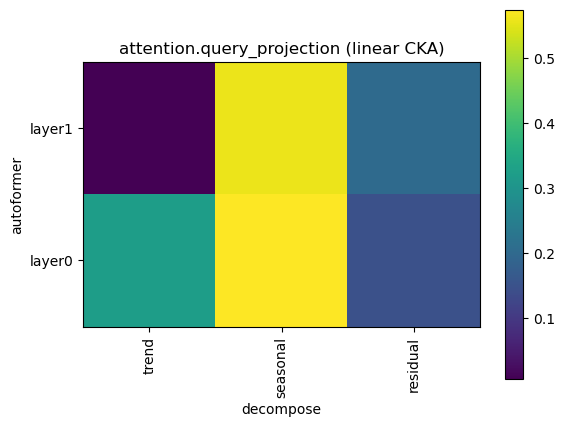

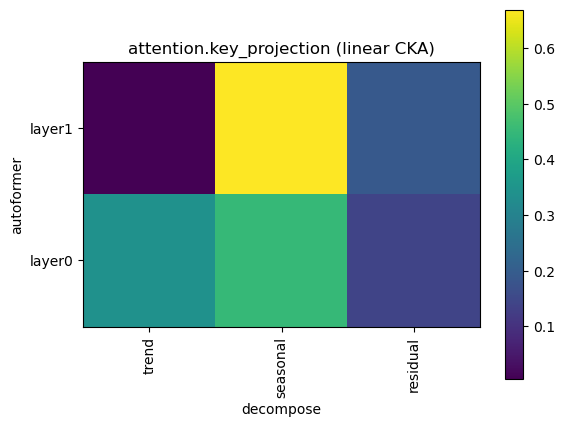

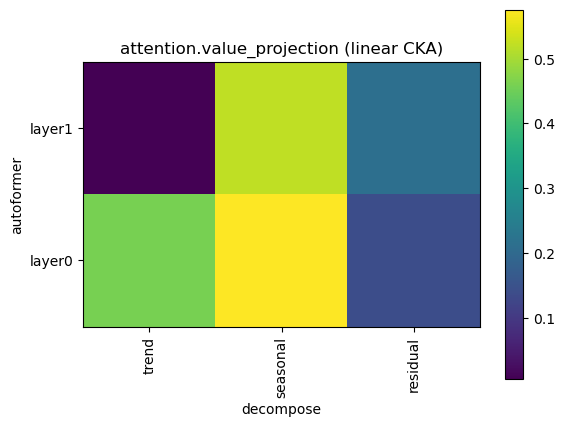

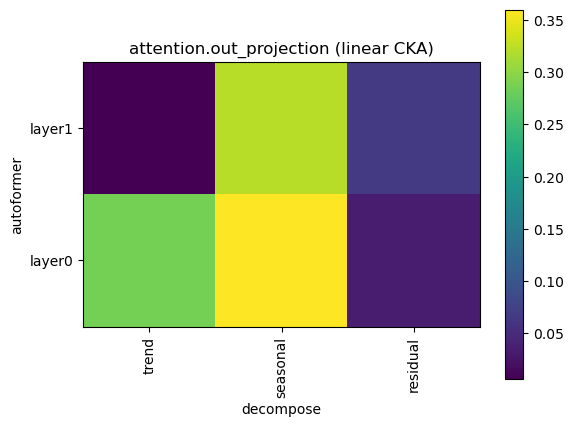

In [14]:
autoformer_7 = data_utils.obtain_autoformer(pred_len=96, dataset="ECL")
data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

stimulus_set = []
no_stimuli = 3

for i, stimulus in enumerate(data_loader):
    if i < no_stimuli:
        stimulus_set.append(stimulus)
    else:
        break

activations_decompose = get_decompose_activations(stimulus_set)
activations_autoformer = activations_file.get_activations_for_dataset(
    model=autoformer_7, stimuli=stimulus_set
)

results, descriptions, modelnames = obtain_CKA_heatmaps_layerwise_handcrafted(
    activations_autoformer, activations_decompose, ["autoformer", "decompose"]
)
CKA.plot_CKA_heatmaps(results, descriptions, modelnames)

### 5.2 Seasonal decomposition CKA automated

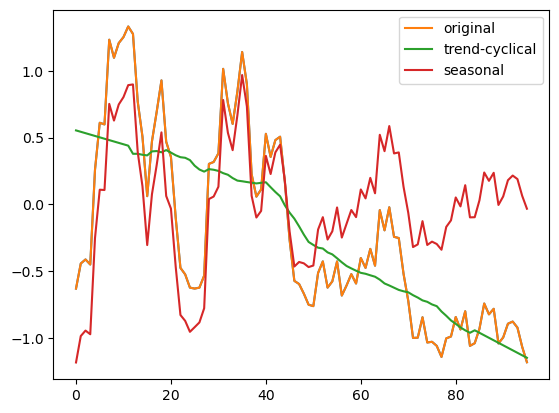

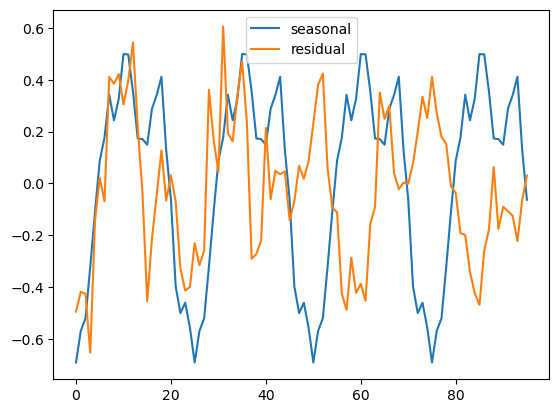

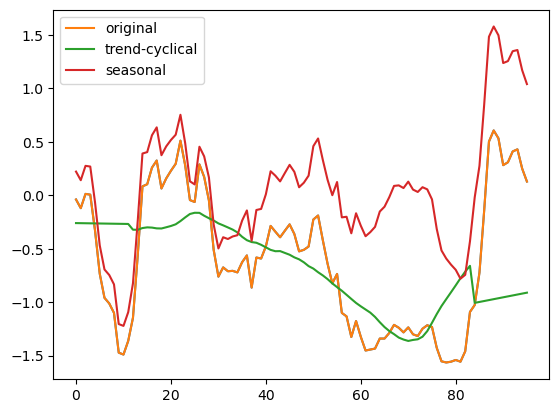

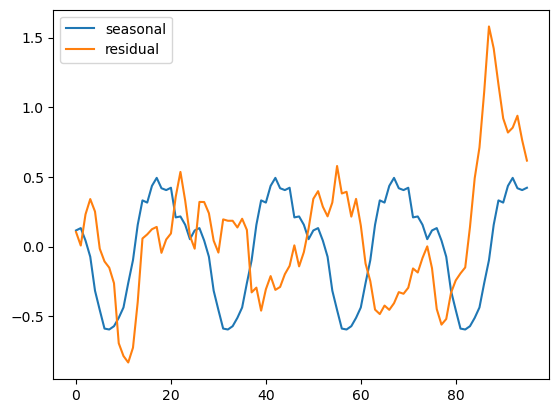

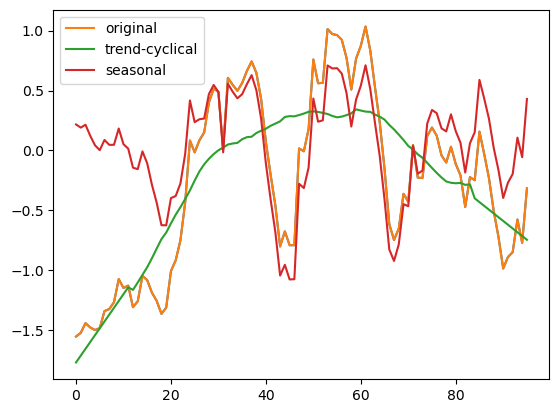

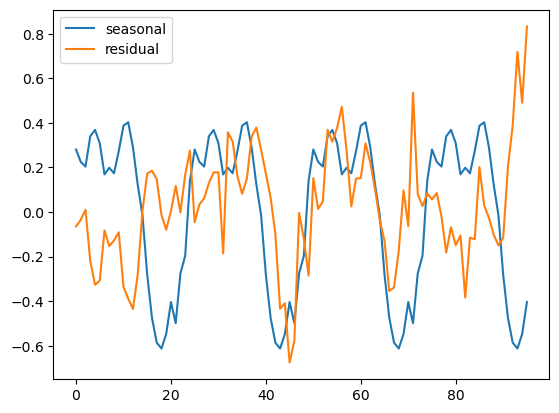

X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.5751893029998939
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.46045042293747995
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.45600777183204705
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.46738277285434543
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.48375652105114797
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.3937412593269032
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.442689714881886
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.5581180784449956
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.41101585080321573
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.622036785216791
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.5217337693213587
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.5555445507794827
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.4838008857110843
X_i.shape:  (288, 64)
Y.shape:  (288, 321)
score:  0.63976600595186
X_i.shape:  (288, 6

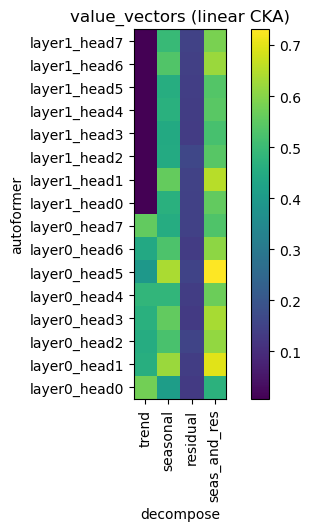

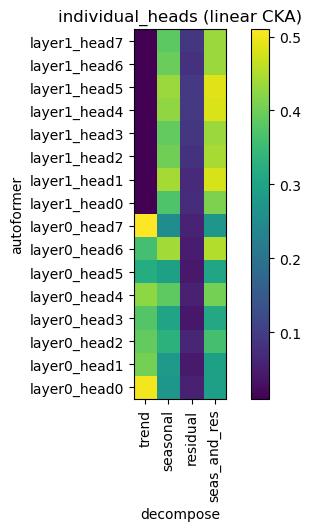

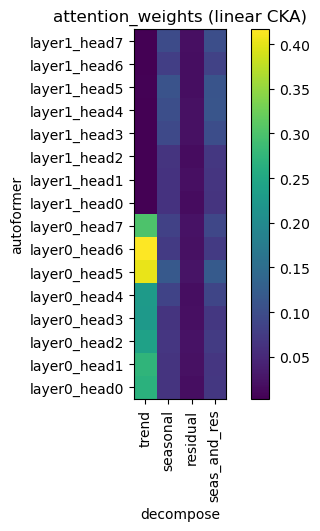

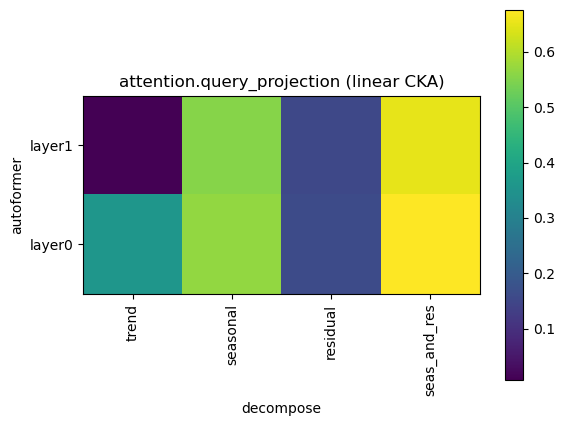

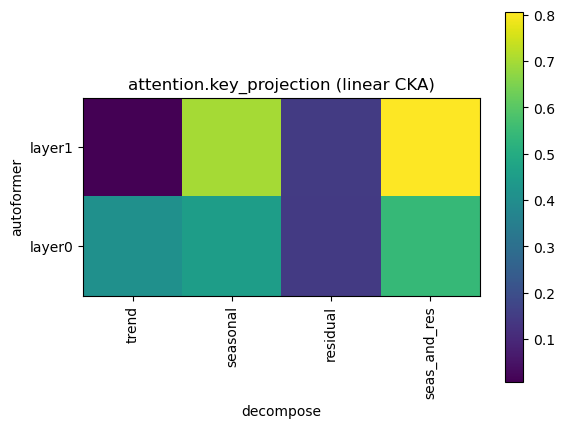

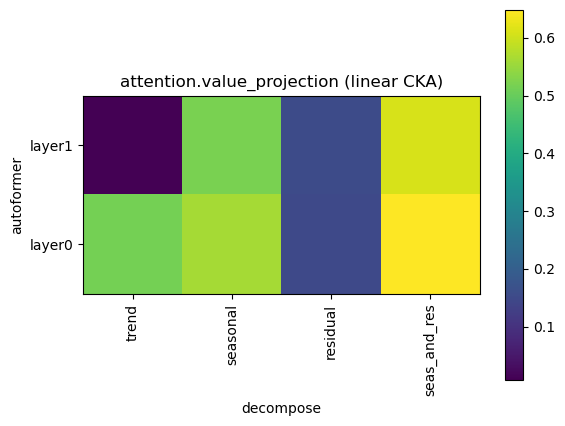

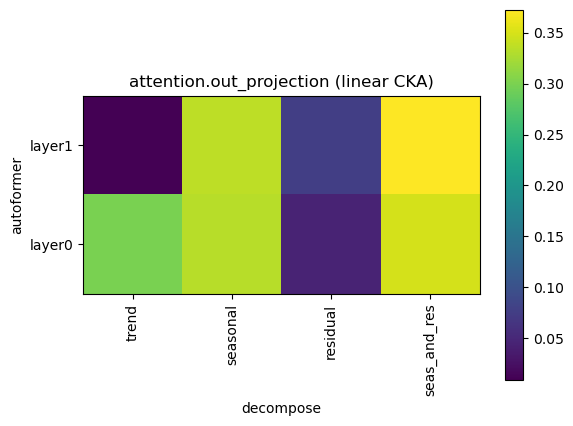

In [11]:
autoformer_7 = data_utils.obtain_autoformer(pred_len=96, dataset="ECL")
data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

stimulus_set = []
no_stimuli = 3

for i, stimulus in enumerate(data_loader):
    if i < no_stimuli:
        stimulus_set.append(stimulus)
    else:
        break

activations_decompose = get_decompose_activations(stimulus_set)
activations_autoformer = activations_file.get_activations_for_dataset(
    model=autoformer_7, stimuli=stimulus_set
)

results, descriptions, modelnames = obtain_CKA_heatmaps_layerwise_handcrafted(
    activations_autoformer, activations_decompose, ["autoformer", "decompose"]
)
CKA.plot_CKA_heatmaps(results, descriptions, modelnames)

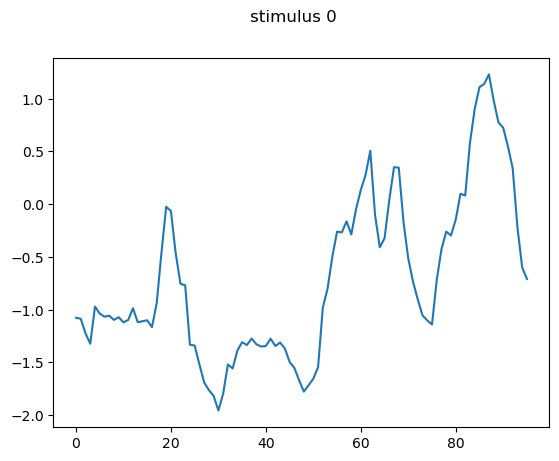

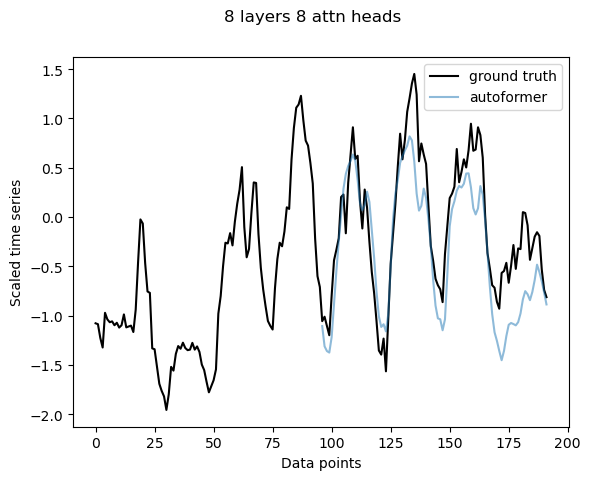

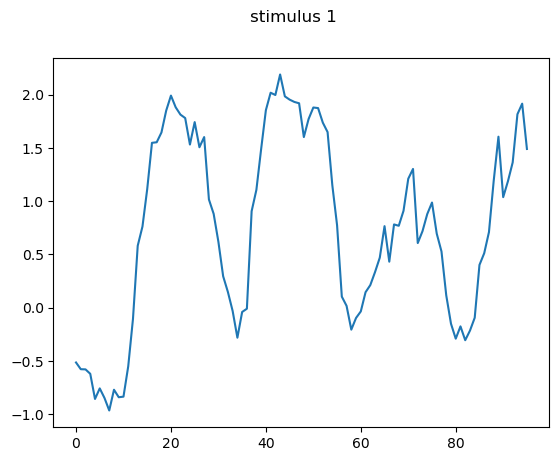

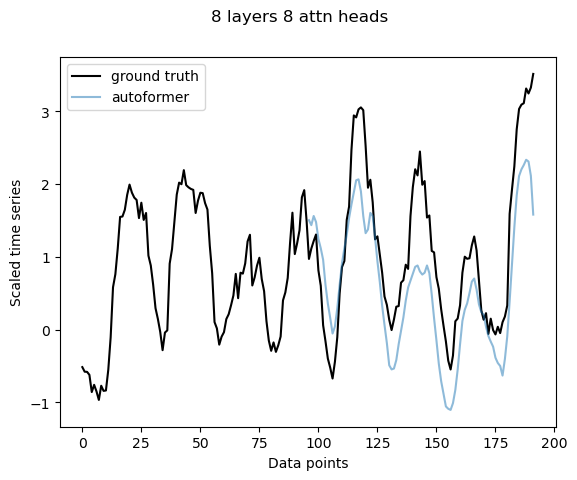

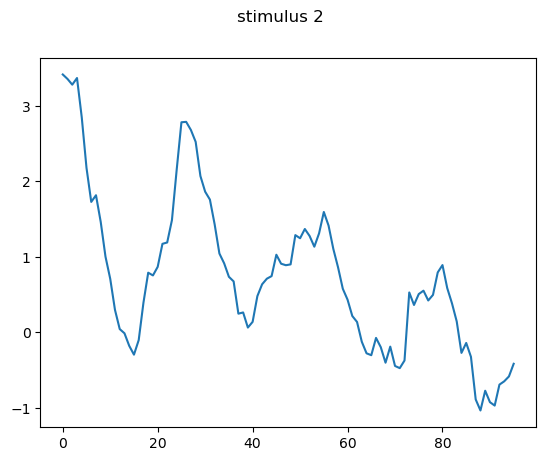

...

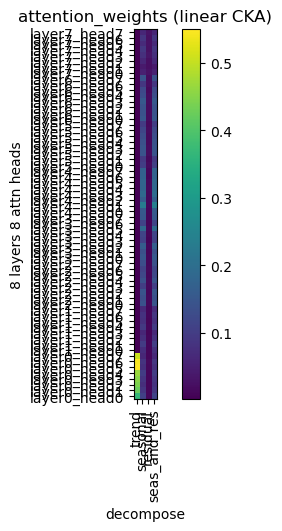

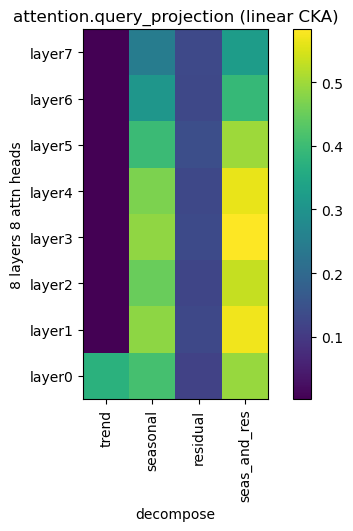

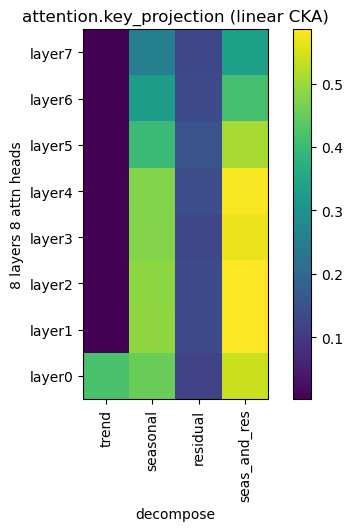

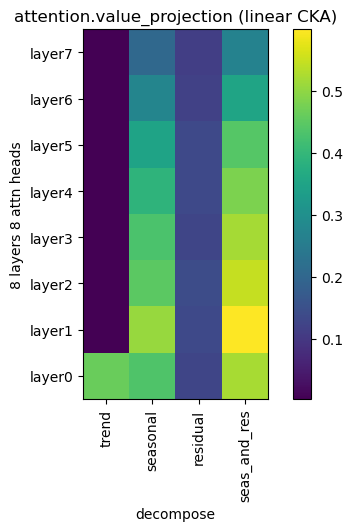

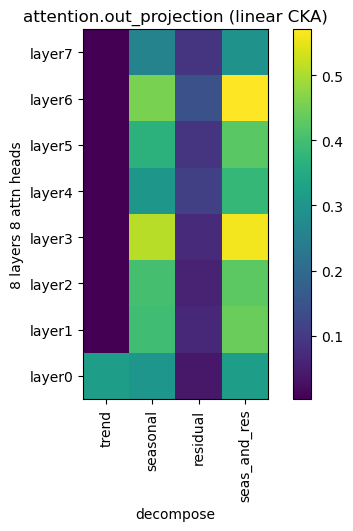

In [13]:
autoformer_v1 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=8, nh=8
)  # n_heads = 8

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_decompose(
    autoformer_v1,
    data_loader,
    name="8 layers 8 attn heads",
    CKA_type="linear",
    save_fig=True,
    num_stimuli=10,
    headwise=True,
)

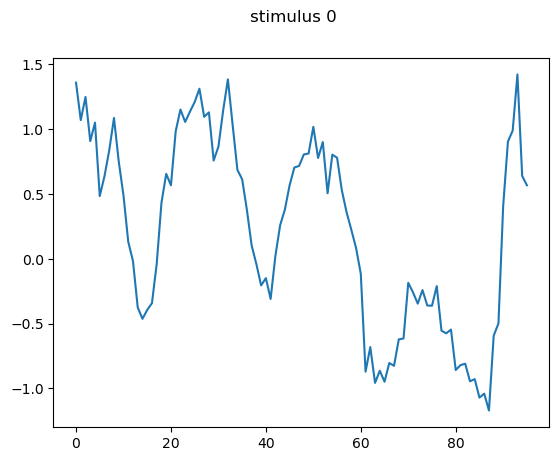

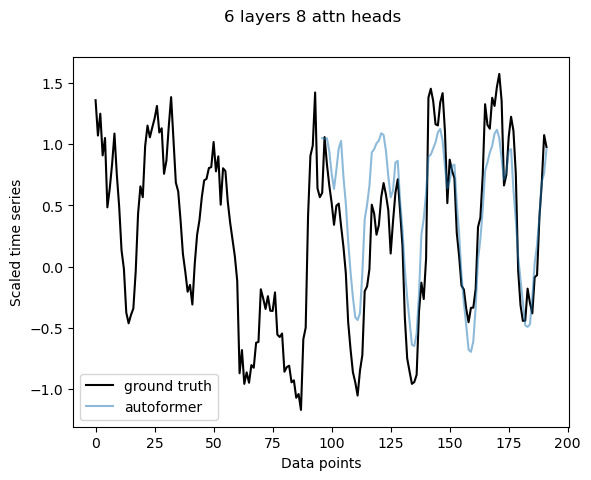

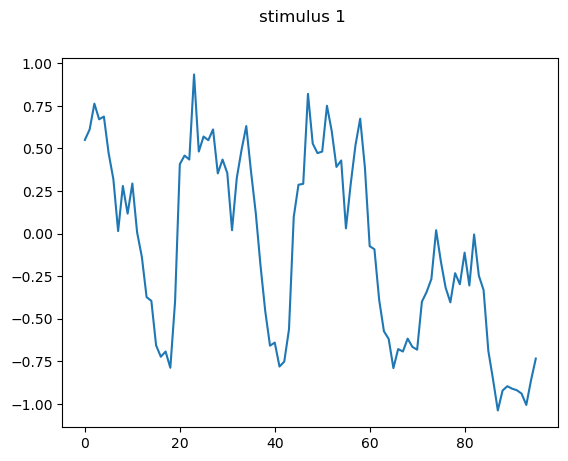

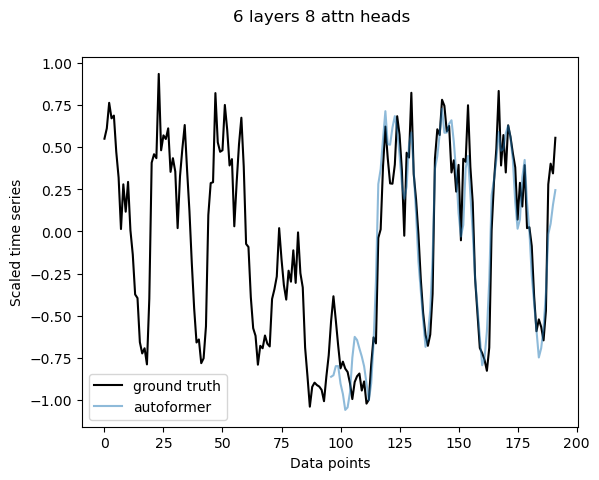

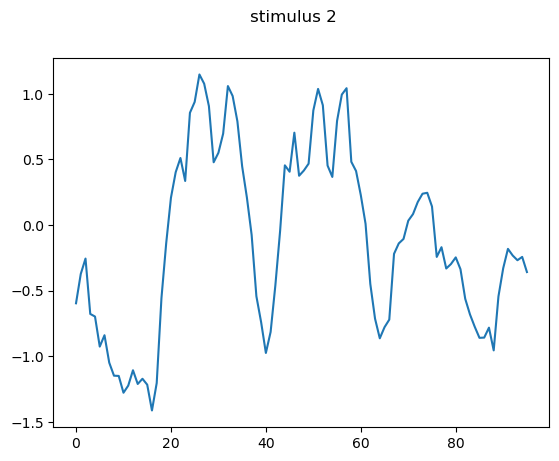

...

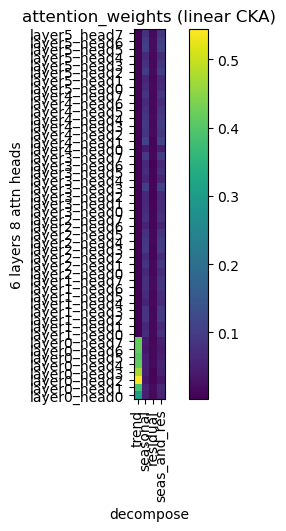

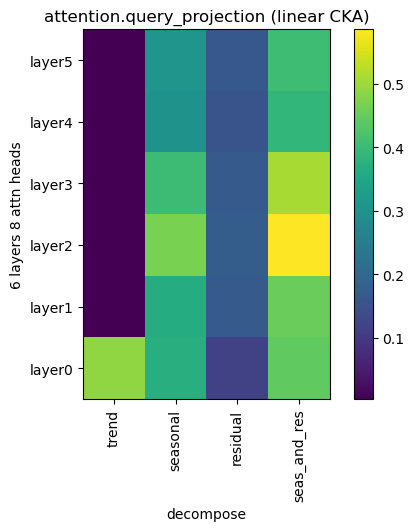

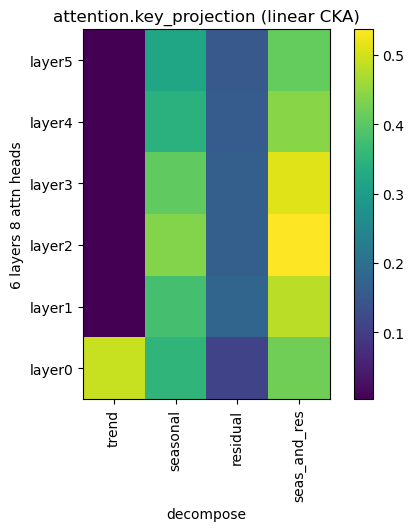

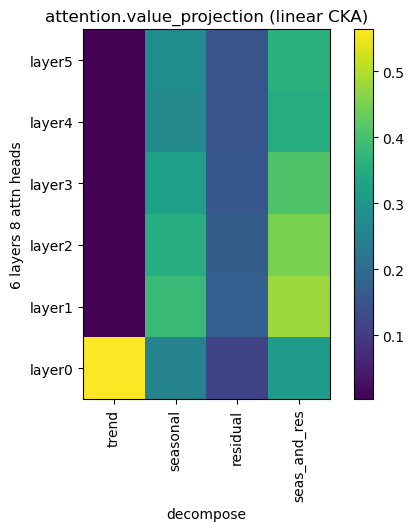

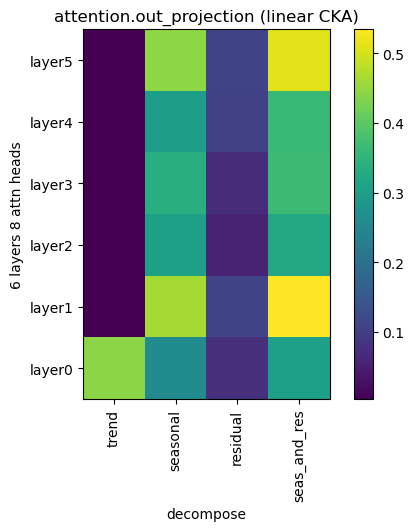

In [15]:
autoformer_v1 = data_utils.obtain_autoformer(
    pred_len=96, dataset="seed42_ECL", el=6, nh=8
)  # n_heads = 8

data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

CKA.CKA_decompose(
    autoformer_v1,
    data_loader,
    name="6 layers 8 attn heads",
    CKA_type="linear",
    save_fig=True,
    num_stimuli=10,
    headwise=True,
)

### 5.3 TODO Data characteristics and good decomposition
In 5.1 we saw that CKA works with seasonal decomposition, but we followed the same method as the original authors of obtaining the trend (a rolling window of 25). We could try to find a more sophisticated way, for example by STL decomposition or so, where the seasonality is maximized. Below is work in progress on this, not finished yet, TODO. This could also possibly improve the performance of the method?

In [8]:
data_loader.dataset.freq

'h'

## 5.4 CKA with time stamps

In [2]:
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from collections import defaultdict


def get_timestamp_activations(stimuli):
    """
    stimuli: list of (seq_x, seq_y, seq_x_mark, seq_y_mark), where seq_x has shape (1, num_datapoints, num_timeseries)
    returns (num_datapoints, num_timeseries)
    """
    activations = []

    for seq_x, seq_y, seq_x_mark, seq_y_mark in stimuli:

        # this only works with a freq of 'h'
        activations.append(
            {
                "hourofday": None,
                "dayofweek": None,
                "dayofmonth": None,
                "dayofyear": None,
                "all_timestamp": None,
            }
        )

        seq_x_mark = seq_x_mark.squeeze()
        activations[-1]["hourofday"] = seq_x_mark[:, 0]
        activations[-1]["dayofweek"] = seq_x_mark[:, 1]
        activations[-1]["dayofmonth"] = seq_x_mark[:, 2]
        activations[-1]["dayofyear"] = seq_x_mark[:, 3]
        activations[-1]["all_timestamp"] = seq_x_mark

    return activations


data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")
for stimulus in data_loader:
    activations = get_timestamp_activations([stimulus])
    break

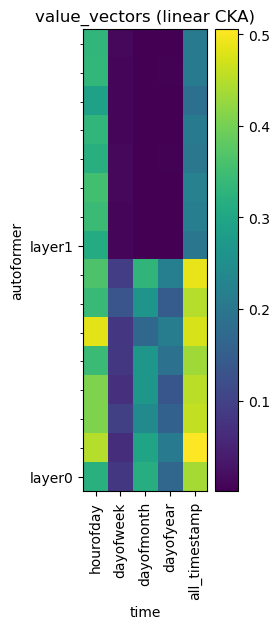

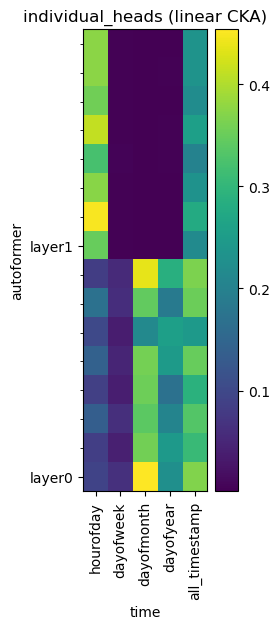

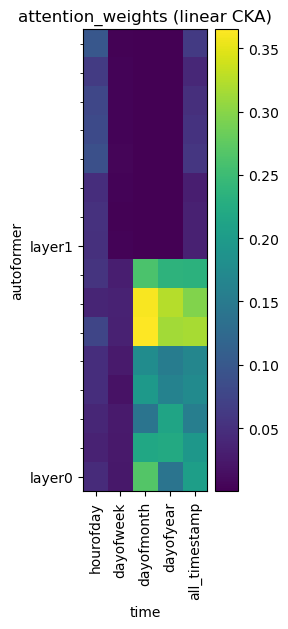

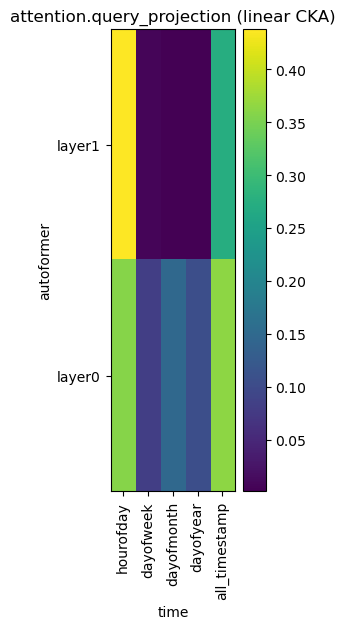

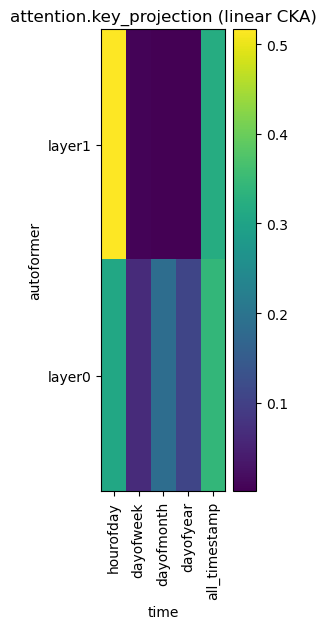

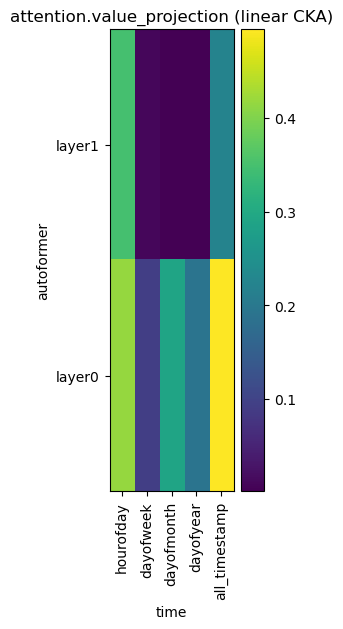

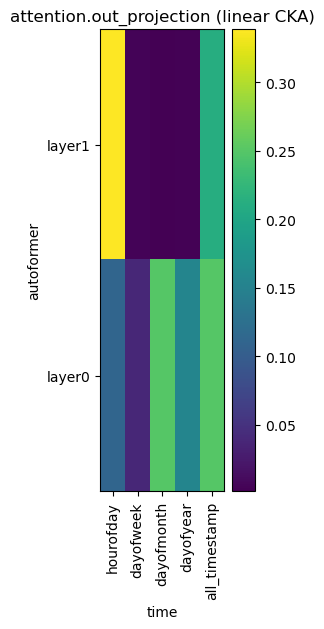

In [5]:
autoformer = data_utils.obtain_autoformer(pred_len=96, dataset="ECL")
data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

stimulus_set = []
no_stimuli = 3

for i, stimulus in enumerate(data_loader):
    if i < no_stimuli:
        stimulus_set.append(stimulus)
    else:
        break

activations_timestamp = activations_file.get_timestamp_activations(stimulus_set)
activations_autoformer = activations_file.get_activations_for_dataset(
    model=autoformer, stimuli=stimulus_set
)

results, descriptions, modelnames = CKA.obtain_CKA_heatmaps_layerwise_handcrafted(
    activations_autoformer, activations_timestamp, ["autoformer", "time"]
)
CKA.plot_CKA_heatmaps(results, descriptions, modelnames, width=2)

In [53]:
def plot_CKA_heatmaps(
    scores, descriptions, modelnames, type="linear", save_fig=False, name_fig=""
):
    for component in scores.keys():
        if (
            len(scores[component].values()) != 0
        ):  # if some hooks are not yet implemented, can be removed later

            fig, ax = plt.subplots(figsize=(6, 6))

            im = ax.imshow(scores[component].values(), aspect="auto")

            ax.set_title(f"{component} ({type} CKA)")
            fig.colorbar(im, ax=ax)

            ax.set_xticks(
                ticks=range(len(list(descriptions[component].values())[0])),
                labels=list(descriptions[component].values())[0],
                rotation=90,
            )

            yticks_labels = list(scores[component].keys())

            if "_" in yticks_labels[0]:
                split_strings = [string.split("_") for string in yticks_labels]

                layer_labels = set([parts[0] for parts in split_strings])
                head_labels = set([parts[1] for parts in split_strings])

                ax.yaxis.set_minor_locator(
                    plt.FixedLocator(np.arange(len(yticks_labels)))
                )
                ax.yaxis.set_minor_formatter(plt.NullFormatter())

                major_ticks = (
                    (np.arange(len(layer_labels))) * len(head_labels)
                    + len(head_labels)
                    - 1
                )
                ax.yaxis.set_major_locator(plt.FixedLocator(major_ticks))
                ax.yaxis.set_major_formatter(
                    plt.FixedFormatter(
                        [parts[0] for parts in split_strings][:: len(head_labels)]
                    )
                )

            else:
                ax.set_yticks(
                    ticks=range(len(yticks_labels)),
                    labels=yticks_labels,
                )

            ax.set_ylabel(modelnames[0])
            ax.set_xlabel(modelnames[1])

            plt.show()

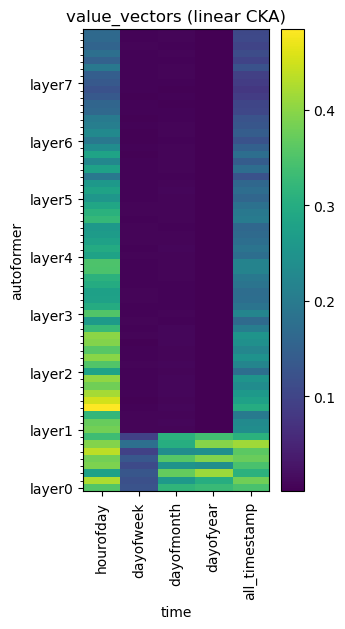

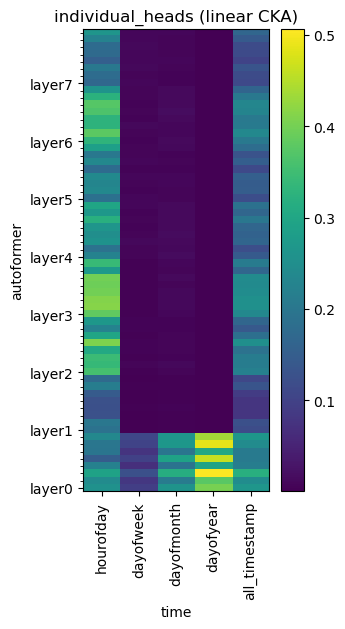

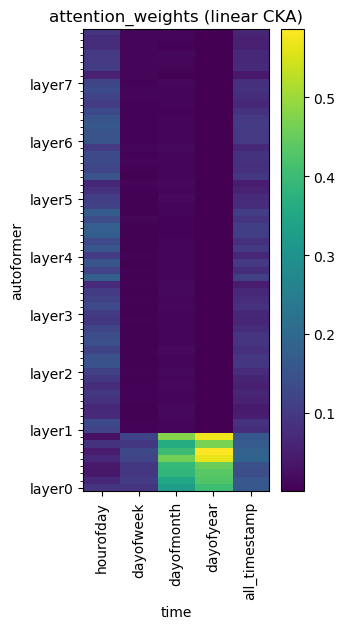

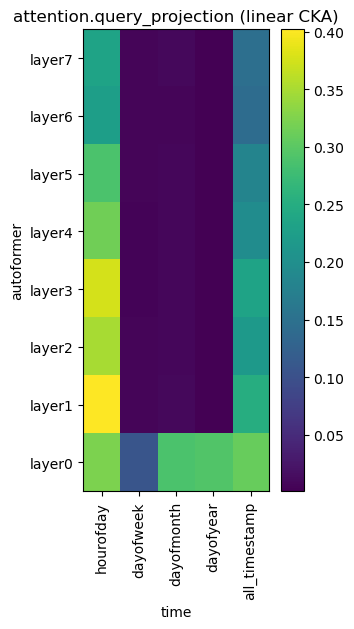

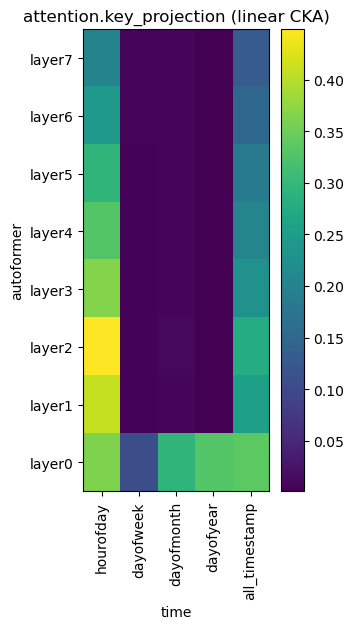

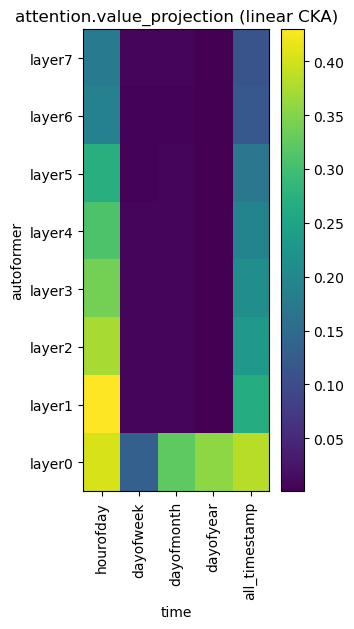

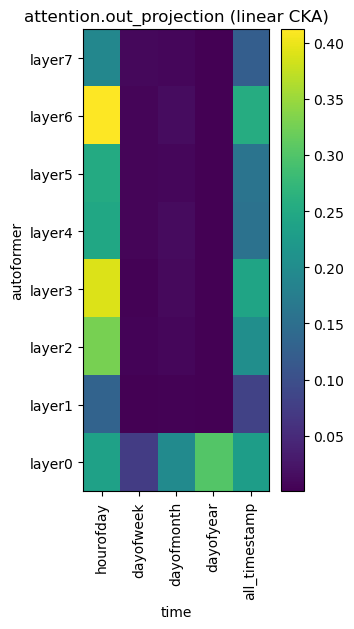

In [10]:
autoformer = data_utils.obtain_autoformer(pred_len=96, dataset="seed42_ECL", el=8)
data_loader = data_utils.obtain_data_loader(pred_len=96, dataset="electricity")

stimulus_set = []
no_stimuli = 3

for i, stimulus in enumerate(data_loader):
    if i < no_stimuli:
        stimulus_set.append(stimulus)
    else:
        break

activations_timestamp = activations_file.get_timestamp_activations(stimulus_set)
activations_autoformer = activations_file.get_activations_for_dataset(
    model=autoformer, stimuli=stimulus_set
)

results, descriptions, modelnames = CKA.obtain_CKA_heatmaps_layerwise_handcrafted(
    activations_autoformer, activations_timestamp, ["autoformer", "time"]
)
CKA.plot_CKA_heatmaps(results, descriptions, modelnames, width=3)